In [2]:
%matplotlib notebook

In [5]:
from ipyimports import *
import matplotlib.ticker as ticker
from scipy.stats import rankdata

In [312]:

def pubFigStyle():
    plt.rcParams['svg.fonttype'] = 'none'

    sns.set_style('ticks')
    sns.set_context("paper", rc={"font.size":5,"axes.titlesize":3,"axes.labelsize":7,'lines.linewidth' : 1,'lines.markersize' :1,
                                 'xtick.labelsize' : 6,'ytick.labelsize' : 6,'legend.fontsize':6,'legend.fancybox':False,
                                'legend.frameon':False})   
def pubFigStyle2():
    plt.rcParams['svg.fonttype'] = 'none'

    sns.set_style('ticks')
    sns.set_context("paper", rc={"font.size":10,"axes.titlesize":6,"axes.labelsize":14,'lines.linewidth' : 2,'lines.markersize' :2,
                                 'xtick.labelsize' : 12,'ytick.labelsize' : 12,'legend.fontsize':12,'legend.fancybox':False,
                                'legend.frameon':False})   

def h5store(filename, df, **kwargs):
    store = pd.HDFStore(filename)
    store.put('df', df)
    store.get_storer('df').attrs.metadata = kwargs
    store.close()

def h5load(filename=None):
    if filename == None:
        import easygui
        filename=easygui.fileopenbox(filetypes=['*.h5'])
    def h5load_(store):
        data = store['df']
        
        try:
            metadata = store.get_storer('df').attrs.metadata
        except AttributeError:
            metadata = None
        return data, metadata
    
    with pd.HDFStore(filename) as store:
        data, metadata = h5load_(store)
        
    return data,metadata,filename
    
def addBoutFrame(df):
    dfs=np.split(df,np.where(df.trajectory__reset==1)[0])
    for d in dfs:
        d['frame']=range(len(d))
    df=pd.concat(dfs)
    return df


In [7]:
def h5DirLoader(foldPath=None, addFrame=True):
    fl=fileList(foldPath,included=['*.h5'])
    
    pl=[]
    dfl=[]
    for i,fn in enumerate(fl):
        df,parameters,pat=h5load(fn)
        parameters['bagFileName']=pat
        pl.append(parameters)
        
        if addFrame:
            df=addBoutFrame(df)
        dfl.append(df)
        print('%i of %i')%(i,len(fl))
#     pdf=pd.DataFrame(pl)
    
    return dfl,pl


In [305]:
pubFigStyle()

In [9]:

def getCircularMean(angles,r=1):
    '''
    angles : list of angles in degrees
    r, optional, scaling weights for 2nd order analysis
    
    Returns a,r
    '''
    n = len(angles)
    sineMean = np.divide(np.sum(r*np.sin(np.deg2rad(angles%360))), n)
    cosineMean = np.divide(np.sum(r*np.cos(np.deg2rad(angles%360))), n)
    vectorMean = np.arctan2(sineMean, cosineMean)
    r=np.sqrt(np.square(sineMean)+np.square(cosineMean))
    return np.degrees(vectorMean),r


def significance(n,R=None,pval=None):
    crit=pd.read_csv('moore.csv',index_col=0)
    critN=crit.iloc[(np.abs(crit.index-n)).argmin()]
    
    if R is None:
        if pval is None:
            pval='0.05'
        return critN[str(pval)]
    
    else:
        return float(critN[(R-critN)>0].idxmax())    
            
        
def mooreTest(df):
    '''
    Does a moores non parametric 2nd order test on  r strngth and set of angles in degrees by ranking them
    df= a dataframe with r and a
    
    
    Returns significance, R strength
    '''
    df=df.copy()
    df.columns=['r','a']
    df['rank']=rankdata(df.r)

#     df['cos']=np.cos(np.deg2rad(df['a']))
#     df['sin']=np.sin(np.deg2rad(df['a']))
#     df['icos']=df['rank']*df['cos']
#     df['isin']=df['rank']*df['sin']
    df['icos']=df['rank']*np.cos(np.deg2rad(df['a']%360))
    df['isin']=df['rank']*np.sin(np.deg2rad(df['a']%360))

    k=(df['rank'].max())
    X=df['icos'].sum()/k
    Y=df['isin'].sum()/k
    R=np.sqrt((X**2+Y**2)/k)    

    return significance(k,R),R
    

def rayleightest(data, axis=None, weights=None):
    """ Performs the Rayleigh test of uniformity.

    This test is  used to identify a non-uniform distribution, i.e. it is
    designed for detecting an unimodal deviation from uniformity. More
    precisely, it assumes the following hypotheses:
    - H0 (null hypothesis): The population is distributed uniformly around the
    circle.
    - H1 (alternative hypothesis): The population is not distributed uniformly
    around the circle.
    Small p-values suggest to reject the null hypothesis.

    Parameters
    ----------
    data : numpy.ndarray or Quantity
        Array of circular (directional) data, which is assumed to be in
        radians whenever ``data`` is ``numpy.ndarray``.
    axis : int, optional
        Axis along which the Rayleigh test will be performed.
    weights : numpy.ndarray, optional
        In case of grouped data, the i-th element of ``weights`` represents a
        weighting factor for each group such that ``np.sum(weights, axis)``
        equals the number of observations.
        See [1]_, remark 1.4, page 22, for detailed explanation.

    Returns
    -------
    p-value : float or dimensionless Quantity
        p-value.

    Examples
    --------
    >>> import numpy as np
    >>> from astropy.stats import rayleightest
    >>> from astropy import units as u
    >>> data = np.array([130, 90, 0, 145])*u.deg
    >>> rayleightest(data) # doctest: +FLOAT_CMP
    <Quantity 0.2563487733797317>

    References
    ----------
    .. [1] S. R. Jammalamadaka, A. SenGupta. "Topics in Circular Statistics".
       Series on Multivariate Analysis, Vol. 5, 2001.
    .. [2] C. Agostinelli, U. Lund. "Circular Statistics from 'Topics in
       Circular Statistics (2001)'". 2015.
       <https://cran.r-project.org/web/packages/CircStats/CircStats.pdf>
    .. [3] M. Chirstman., C. Miller. "Testing a Sample of Directions for
       Uniformity." Lecture Notes, STA 6934/5805. University of Florida, 2007.
    .. [4] D. Wilkie. "Rayleigh Test for Randomness of Circular Data". Applied
       Statistics. 1983.
       <http://citeseerx.ist.psu.edu/viewdoc/summary?doi=10.1.1.211.4762>
    """
    
    def _length(data, p=1, phi=0.0, axis=None, weights=None):
        # Utility function for computing the generalized sample length
        C, S = _components(data, p, phi, axis, weights)
        return np.hypot(S, C)


    def _components(data, p=1, phi=0.0, axis=None, weights=None):
        # Utility function for computing the generalized rectangular components
        # of the circular data.
        if weights is None:
            weights = np.ones((1,))
        try:
            weights = np.broadcast_to(weights, data.shape)
        except ValueError:
            raise ValueError('Weights and data have inconsistent shape.')

        C = np.sum(weights * np.cos(p * (data - phi)), axis)/np.sum(weights, axis)
        S = np.sum(weights * np.sin(p * (data - phi)), axis)/np.sum(weights, axis)

        return C, S
    n = np.size(data, axis=axis)
    Rbar = _length(data, 1, 0.0, axis, weights)
    z = n*Rbar*Rbar

    # see [3] and [4] for the formulae below
    tmp = 1.0
    if(n < 50):
        tmp = 1.0 + (2.0*z - z*z)/(4.0*n) - (24.0*z - 132.0*z**2.0 +
                                             76.0*z**3.0 - 9.0*z**4.0)/(288.0 *
                                                                        n * n)

    p_value = np.exp(-z)*tmp
    return p_value

    
def meanOfMeaner(df,posLang=False,posRang=False,distBin=False,windCut=False):
    df=df.copy()
    dfs=np.split(df.reset_index(),np.where(df.trajectory__reset==1)[0])
    res=[]
    
    if distBin:
        bins=dfl[0].posLdistBin.cat.categories
#         print bins
    else:
        bins=[0]
        
    for dfx in dfs:
        for dist in bins:
            if distBin:
                dfx=dfx[dfx.posLdistBin==dist]
                if dfx.empty:
                    print dist

                    continue
            
            if posLang:
                a,r=getCircularMean(dfx[dfx.trajectory__speed>0].posLang)
            elif posRang:
                a,r=getCircularMean(dfx[dfx.trajectory__speed>0].posRang)


            else:
                a,r=getCircularMean(dfx[dfx.trajectory__speed>0].trajectory__pOri_x)

            try:
                if windCut:
                    res.append([dfx.trajectory__runNum.iloc[0],dfx.trajectory__case.iloc[0],a,r,
                                dfx['frame'].max(),dist,dfx['windCut'][0]])
                else:
                    res.append([dfx.trajectory__runNum.iloc[0],dfx.trajectory__case.iloc[0],a,r,
                                dfx['frame'].max(),dist])
#                 print dist
            except IndexError as e:
#                 print dfx.empty,'hrllo'  #single positional indexer is out-of-bounds
                pass
    
    
    dfRes=pd.DataFrame(res)
    
    try:
        if windCut:
            dfRes.columns=['run','case','a','r','dur','dist','windCut']
        else:
            dfRes.columns=['run','case','a','r','dur','dist']

    except ValueError:
        print " wonky file"
    return dfRes

def addPosAng(dfl,pl):
    dfl2=[]
    bins=[2,4,8,16,32]

    for i, df in enumerate(dfl):
        parameters=pl[i]
        
        
        df['posLang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(
                                    parameters['posL'][1]),-df.trajectory__pPos_x.sub(parameters['posL'][0])))))+180)%360)-180
        df['posRang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(
                                    parameters['posR'][1]),-df.trajectory__pPos_x.sub(parameters['posR'][0])))))+180)%360)-180

        df['posLdist']=np.linalg.norm(df[['trajectory__pPos_x', 'trajectory__pPos_y']].sub(parameters['posL'][0:2]),axis=1)
        df['posRdist']=np.linalg.norm(df[['trajectory__pPos_x', 'trajectory__pPos_y']].sub(parameters['posR'][0:2]),axis=1)
        df['posLdistBin']=(pd.cut(df.posLdist,bins))
        df['posRdistBin']=(pd.cut(df.posRdist,bins))

        
        df['fileStamp']=pl[i]['bagFileName'].split('/')[-1][:20]

        
        dfl2.append(df)
        
    return dfl2


# dfl=addPosAng(dfl,pl)



In [9]:
dfl,pl=h5DirLoader('/media/rhagoletis/Traj/aggreg/01/')

for i,p in enumerate(pl):
    try:
        p['camHpr']
    except KeyError:
        pl[i]=p['metadata']

/usr/lib/python2.7/dist-packages/tables/__init__.py:82: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility
  from tables.utilsextension import (
/usr/lib/python2.7/dist-packages/tables/file.py:35: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility
  from tables import hdf5extension
/usr/lib/python2.7/dist-packages/tables/link.py:32: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility
  from tables import linkextension
/usr/lib/python2.7/dist-packages/tables/table.py:25: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility
  from tables import tableextension
/usr/lib/python2.7/dist-packages/tables/index.py:30: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility
  from tables import indexesextension


0 of 75
1 of 75
2 of 75
3 of 75
4 of 75
5 of 75
6 of 75
7 of 75
8 of 75
9 of 75
10 of 75
11 of 75
12 of 75
13 of 75
14 of 75
15 of 75
16 of 75
17 of 75
18 of 75
19 of 75
20 of 75
21 of 75
22 of 75
23 of 75
24 of 75
25 of 75
26 of 75
27 of 75
28 of 75
29 of 75
30 of 75
31 of 75
32 of 75
33 of 75
34 of 75
35 of 75
36 of 75
37 of 75
38 of 75
39 of 75
40 of 75
41 of 75
42 of 75
43 of 75
44 of 75
45 of 75
46 of 75
47 of 75
48 of 75
49 of 75
50 of 75
51 of 75
52 of 75
53 of 75
54 of 75
55 of 75
56 of 75
57 of 75
58 of 75
59 of 75
60 of 75
61 of 75
62 of 75
63 of 75
64 of 75
65 of 75
66 of 75
67 of 75
68 of 75
69 of 75
70 of 75
71 of 75
72 of 75
73 of 75
74 of 75


In [333]:
dfl,pl=h5DirLoader('/media/rhagoletis/Traj/aggreg/01/')
dfang,pang=h5DirLoader('/media/rhagoletis/Traj/aggreg/vision/ang/')
dfv,plv=h5DirLoader('/media/rhagoletis/Traj/aggreg/odour/vada/')
dfor,plor=h5DirLoader('/media/rhagoletis/Traj/aggreg/odour/odorevolver')
dfvs,plv=h5DirLoader('/media/rhagoletis/Traj/aggreg/odour/vadaslip/')
dfwt,plwt=h5DirLoader('/media/rhagoletis/Traj/aggreg/wind/tree/')#wind with tree
dfvsa,plv=h5DirLoader('/media/rhagoletis/Traj/aggreg/odour/vadaslipall/')


0 of 75
1 of 75
2 of 75
3 of 75
4 of 75
5 of 75
6 of 75
7 of 75
8 of 75
9 of 75
10 of 75
11 of 75
12 of 75
13 of 75
14 of 75
15 of 75
16 of 75
17 of 75
18 of 75
19 of 75
20 of 75
21 of 75
22 of 75
23 of 75
24 of 75
25 of 75
26 of 75
27 of 75
28 of 75
29 of 75
30 of 75
31 of 75
32 of 75
33 of 75
34 of 75
35 of 75
36 of 75
37 of 75
38 of 75
39 of 75
40 of 75
41 of 75
42 of 75
43 of 75
44 of 75
45 of 75
46 of 75
47 of 75
48 of 75
49 of 75
50 of 75
51 of 75
52 of 75
53 of 75
54 of 75
55 of 75
56 of 75
57 of 75
58 of 75
59 of 75
60 of 75
61 of 75
62 of 75
63 of 75
64 of 75
65 of 75
66 of 75
67 of 75
68 of 75
69 of 75
70 of 75
71 of 75
72 of 75
73 of 75
74 of 75
0 of 9
1 of 9
2 of 9
3 of 9
4 of 9
5 of 9
6 of 9
7 of 9
8 of 9
0 of 9
1 of 9
2 of 9
3 of 9
4 of 9
5 of 9
6 of 9
7 of 9
8 of 9
0 of 8
1 of 8
2 of 8
3 of 8
4 of 8
5 of 8
6 of 8
7 of 8
0 of 2
1 of 2
0 of 1
0 of 8
1 of 8
2 of 8
3 of 8
4 of 8
5 of 8
6 of 8
7 of 8


In [260]:
i=0
for df in dfvsa:
   i+=df.trajectory__runNum.max() 
print i

33.0


In [63]:
dfvsa,plv=h5DirLoader('/media/rhagoletis/Traj/aggreg/odour/resSelected/')


0 of 4
1 of 4
2 of 4
3 of 4


In [262]:
import numpy as np

def rle(inarray):
        """ run length encoding. Partial credit to R rle function. 
            Multi datatype arrays catered for including non Numpy
            returns: tuple (runlengths, startpositions, values) """
        ia = np.asarray(inarray)                  # force numpy
        n = len(ia)
        if n == 0: 
            return (None, None, None)
        else:
            y = np.array(ia[1:] != ia[:-1])     # pairwise unequal (string safe)
            i = np.append(np.where(y), n - 1)   # must include last element posi
            z = np.diff(np.append(-1, i))       # run lengths
            p = np.cumsum(np.append(0, z))[:-1] # positions
            return(z, p, ia[i])
        
def resLen2(arr):
    tb=rle(arr)
    return tb[0][tb[2] == 1]

In [265]:
pd.DataFrame(cl).describe()

,0,1,2,3
count,8.000000,8.000000,8.000000,8.000000
mean,5.875000,5.500000,5.125000,4.750000
std,3.440826,5.707138,3.399054,3.284161
min,2.000000,2.000000,2.000000,1.000000
25%,3.750000,2.000000,2.000000,2.750000
50%,5.000000,3.500000,4.500000,4.000000
75%,7.000000,6.000000,6.750000,5.750000
max,12.000000,19.000000,11.000000,11.000000


<IPython.core.display.Javascript object>


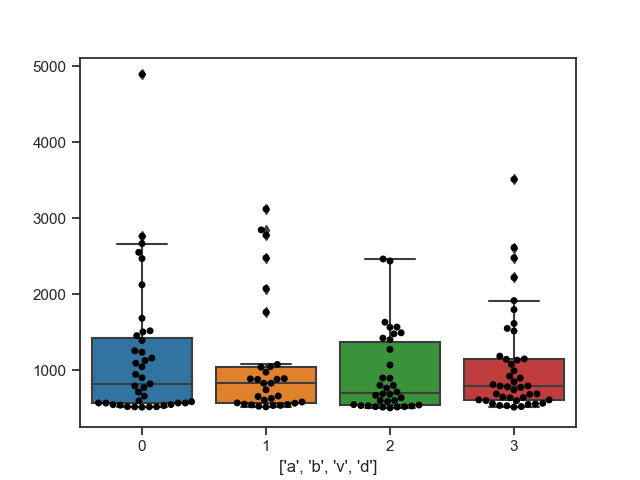

In [278]:
rl=[[],[],[],[]]
for df in dfvsa[:]:
#     r=df.groupby(['trajectory__runNum','trajectory__case']).apply(inPlumeCounter)
    dfs=np.split(df.reset_index(),np.where(df.trajectory__reset==1)[0])
    for d in dfs[1:]:
        d2=(((d.trajectory__pPos_x<514)&(d.trajectory__pPos_x>512)&(d.trajectory__pPos_y>477))*1.)

#         r=((((d.trajectory__pPos_x<514)&(d.trajectory__pPos_x>512))*1.).sum())#/len(d.trajectory__DCoffset)
        r=(resLen2(d2))
        
        rl[int(d.trajectory__case.iloc[1])]=np.append(rl[int(d.trajectory__case.iloc[1])],r)
rld=pd.DataFrame(rl).T
rld=rld[(rld>500)&(rld<6000)]

plt.figure()
sns.swarmplot(data=rld,color='k')
sns.boxplot(data=rld)

#         rl.append([d.trajectory__case.iloc[1],r])

<IPython.core.display.Javascript object>


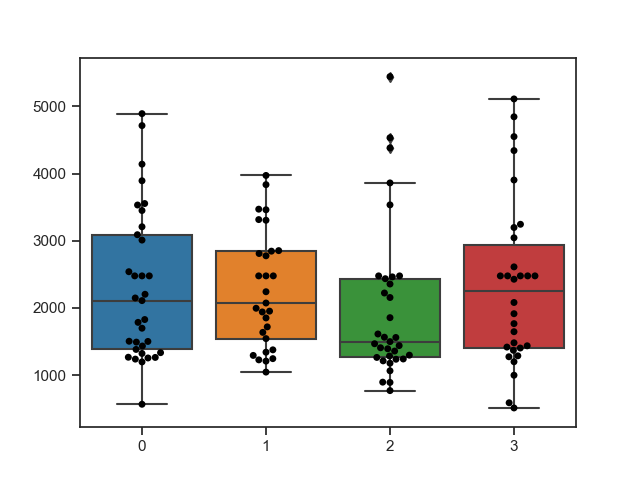

In [277]:
rl=[[],[],[],[]]
for df in dfvsa[:]:
#     r=df.groupby(['trajectory__runNum','trajectory__case']).apply(inPlumeCounter)
    dfs=np.split(df.reset_index(),np.where(df.trajectory__reset==1)[0])
    for d in dfs[1:]:
        d2=(((d.trajectory__pPos_x<516)&(d.trajectory__pPos_x>510)&(d.trajectory__pPos_y>477))*1.)

#         r=((((d.trajectory__pPos_x<514)&(d.trajectory__pPos_x>512))*1.).sum())#/len(d.trajectory__DCoffset)
        r=(resLen2(d2))
        
        rl[int(d.trajectory__case.iloc[1])]=np.append(rl[int(d.trajectory__case.iloc[1])],r)
rld=pd.DataFrame(rl).T
rld=rld[(rld>500)&(rld<6000)]

plt.figure()
sns.swarmplot(data=rld,color='k')
sns.boxplot(data=rld)

#         rl.append([d.trajectory__case.iloc[1],r])

In [316]:
pubFigStyle()

<IPython.core.display.Javascript object>


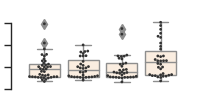

In [325]:
rl=[[],[],[],[]]
for df in dfvsa[:]:
#     r=df.groupby(['trajectory__runNum','trajectory__case']).apply(inPlumeCounter)
    dfs=np.split(df.reset_index(),np.where(df.trajectory__reset==1)[0])
    for d in dfs[1:]:
        d2=(((d.trajectory__pPos_x<515)&(d.trajectory__pPos_x>511)&(d.trajectory__pPos_y>477))*1.)

#         r=((((d.trajectory__pPos_x<514)&(d.trajectory__pPos_x>512))*1.).sum())#/len(d.trajectory__DCoffset)
        r=(resLen2(d2))
        
        rl[int(d.trajectory__case.iloc[1])]=np.append(rl[int(d.trajectory__case.iloc[1])],r)
rld=pd.DataFrame(rl).T
rld=rld[(rld>500)&(rld<6000)]
rld/=165.
plt.figure(figsize=(2,1))
sns.swarmplot(data=rld,color='0.2',size=2)
sns.boxplot(data=rld,color='#feeddcff')

#         rl.append([d.trajectory__case.iloc[1],r])

In [326]:
plt.ylim(0,35)

(0, 35)

In [327]:
locs, labels = plt.xticks() 
plt.xticks(locs,['Slip','Slip\n+\nOdour','Slip\n+\nWind','Slip\n+\nWind\n+\nOdour'])
plt.ylabel('Time inside plume (s)')
sns.despine(offset=10,trim=True)
plt.savefig('a_plt.svg',transparent=True,papertype='A4',frameon=False,)


In [109]:
rld.to_csv('resTime_10flies.csv')

In [44]:
from scipy import stats

In [221]:
stats.kruskal(rld[0].dropna(),rld[1].dropna(),rld[2].dropna(),rld[3].dropna())

KruskalResult(statistic=0.6615346790413221, pvalue=0.8822118710059617)

In [222]:
stats.kruskal(rld[0].dropna(),rld[3].dropna())

KruskalResult(statistic=0.00377489373029337, pvalue=0.9510086666578793)

In [184]:
stats.kruskal(rld[2].dropna(),rld[3].dropna())

KruskalResult(statistic=3.372552949927595, pvalue=0.06629095558770472)

In [185]:
stats.mannwhitneyu(rld[0].dropna(),rld[1].dropna())

MannwhitneyuResult(statistic=654.0, pvalue=0.49334723106343187)

In [186]:
stats.mannwhitneyu(rld[0].dropna(),rld[2].dropna(),alternative='two-sided')

MannwhitneyuResult(statistic=742.5, pvalue=0.7984743525605036)

In [187]:
stats.mannwhitneyu(rld[0].dropna(),rld[2].dropna())

MannwhitneyuResult(statistic=692.5, pvalue=0.3992371762802518)

In [188]:
stats.mannwhitneyu(rld[0].dropna(),rld[1].dropna(),alternative='two-sided')

MannwhitneyuResult(statistic=658.0, pvalue=0.9866944621268637)

In [189]:
stats.mannwhitneyu(rld[0].dropna(),rld[1].dropna(),alternative='greater')

MannwhitneyuResult(statistic=658.0, pvalue=0.49334723106343187)

In [190]:
stats.mannwhitneyu(rld[0].dropna(),rld[1].dropna(),alternative='less')

MannwhitneyuResult(statistic=658.0, pvalue=0.511087034631784)

In [231]:
stats.mannwhitneyu(rld[0].dropna(),rld[3].dropna(),alternative='two-sided')

MannwhitneyuResult(statistic=528.0, pvalue=0.07291517377990284)

In [232]:
stats.mannwhitneyu(rld[0].dropna(),rld[3].dropna(),alternative='greater')

MannwhitneyuResult(statistic=528.0, pvalue=0.964384689766972)

In [233]:
stats.mannwhitneyu(rld[0].dropna(),rld[3].dropna(),alternative='less')

MannwhitneyuResult(statistic=528.0, pvalue=0.03645758688995142)

In [225]:
stats.ttest_ind(rld[2].dropna(),rld[3].dropna())

Ttest_indResult(statistic=0.3677443368766705, pvalue=0.7140996546925836)

<IPython.core.display.Javascript object>


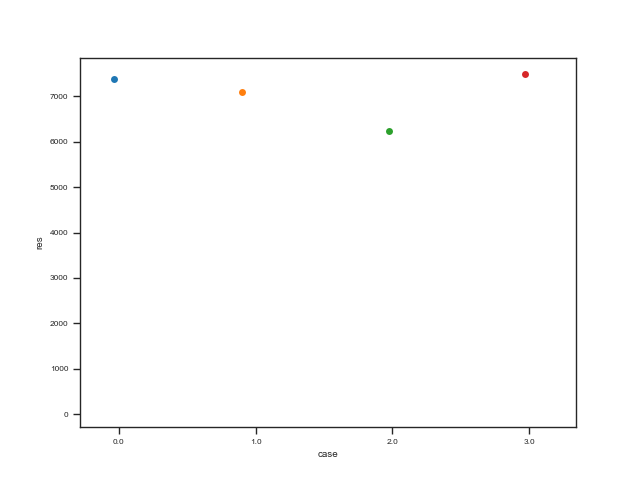

In [164]:
def inPlumeCounter(d):
    res=((((d.trajectory__pPos_x<514)&(d.trajectory__pPos_x>512)&(d.trajectory__pPos_y>47))*1.).sum())#/len(d.trajectory__DCoffset)
    return res

rl=[]
for df in dfvsa[-1:]:
    r=df.groupby(['trajectory__case']).apply(inPlumeCounter)
    rl.append(r)
    
rd=pd.concat(rl,axis=1).T
rd=rd.melt(var_name='case',value_name='res')
plt.figure()
sns.stripplot(data=rd,x='case',y='res')

In [35]:
r=df.groupby('trajectory__case').apply(inPlumeCounter)

In [334]:
def pltTrajPlot(df,case=None,ax=None,parameters=None,dec=20,alpha=0.3,marker='',c='grey',linewidth=2,
                addStart=True,initPos=None,xlim=None,ylim=None,runs=None,xTit='',yTit=''):
    import seaborn as sns
    sns.set_style('ticks')
    
    if runs is not None:
        df=df[df.trajectory__runNum<runs].copy()
    
    if case is not None:
        df=df[df.trajectory__case==case].copy()
    
    dfs=np.split(df.reset_index(),np.where(df.trajectory__reset==1)[0])
    if ax is None:
        ax = plt.subplot(111)

    for dfx in dfs:
        ax.plot(dfx.trajectory__pPos_x.ix[::dec],dfx.trajectory__pPos_y[::dec],
                alpha=alpha,marker=marker,c=c,linewidth=linewidth)
        
        if addStart:
            if initPos is None:
                try:
                    xs=parameters['playerInitPos'][0]
                    ys=parameters['playerInitPos'][1]
                except:
                    try:
                        xs=df[df.trajectory__reset==1].ix[0].trajectory__pPos_x
                        ys=df[df.trajectory__reset==1].ix[0].trajectory__pPos_y
#                         ax.scatter(xs,ys,marker='^',s=40,c='r')

                    except IndexError:
                        xs=513
                        ys=513
                        print ('no params, error in auto start find, ressetting to defaukt')

                ax.scatter(xs,ys,marker='^',s=40,c='r')
                
                

    ax.set_xlabel(xTit)
    ax.set_ylabel(yTit)

    
    if xlim is not None:
        ax.set_xlim(xlim)
    if ylim is not None:
        ax.set_ylim(ylim)
    
#     ax.set_aspect('equal','datalim')

    ax.set_aspect('equal',)
    
    return ax
    
def pltQuadTrajPlot(df,path=None,ax=None,dec=20,alpha=0.3,marker='',c='grey',linewidth=2,
                    savePng=True,saveSvg=True,transparent=True,papertype='A4',frameon=False,dpi=300,
                    xlim=None,ylim=None,tit='test',runs=None,xTit='',yTit='',pal=None,collapse=False):
    
    
    if ax is None:
        if collapse: 
            f,ax=plt.subplots(1,2,'all','all',figsize=(4,2))
            ax=ax.reshape(2)

        else:
            f,ax=plt.subplots(1,4,'all','all',figsize=(8,2))
#         f,ax=plt.subplots(2,2,'all','all',)
            ax=ax.reshape(4)

    for i in range(4):
        if pal is not None:
            pali=pal[i]
        else:
            pali=c
        
        
        if collapse:#fix to second subplot
            if i>0:
                axi=ax[1]
            else:
                axi=ax[0]
        else:#no collapse, follow as usual
            axi=ax[i]
                
                
        pltTrajPlot(df,case=i,ax=axi,dec=dec,
                    alpha=alpha,marker=marker,c=pali,linewidth=linewidth,
                    xlim=xlim,ylim=ylim,runs=runs,xTit=xTit,yTit=yTit,)
        
#         pltTrajPlot(df[df.trajectory__case==i],ax=ax[i],dec=dec,
#             alpha=alpha,marker=marker,c=c,linewidth=linewidth,
#             xlim=xlim,ylim=ylim,runs=runs,xTit=xTit,yTit=yTit)

    plt.suptitle(tit)
    if path is None:
        try:
            path=df.index[0].strftime("%Y-%m-%d_%H~%M~%S")
        except:
            print ('df empty for this case')
            path='emptyDf'
    if savePng:
        plt.savefig(path+'_plt.png',transparent=transparent,papertype=papertype,frameon=frameon,dpi=dpi)
    if saveSvg:
        plt.savefig(path+'_plt.svg',transparent=transparent,papertype=papertype,frameon=frameon)
        
    return ax

In [12]:
df,param,pat=h5load('/home/rhagoletis/catkin/src/analyseWorld/ipy_notebooks/all_wind.h5')
df.windPressure=df.windPressure.astype(float)

d2=df[(df.flowSource=='direct')&(df.visual=='grassSky')&(df.windPressure==3.5)]


KeyboardInterrupt: 

In [339]:
dist=[(513,513),(513,510),(513,504),(513,492),]
def treeFig(dfl=None,figType='tree', xlim=(510,516),ylim=(512,518),ax=None,dec=10,runs=100,
                        path='',xTit='', yTit='',savePng=False,saveSvg=False, 
                    despine=True, naked=False,
            transparent=True,papertype='A4',frameon=False,dpi=300,
           dist=[(513,513),(513,510),(513,504),(513,492),],#(513,480)],
            scale='area,',bins=[0,2,4,8,16,32],
            speedBin=(-.1,0.5,1.5,2.5,3.5),lw=0.75,
            vioWindPal=['#b5b5b5','#377eb8', '#ff7f00', '#984ea3'],
            vioWindSpeedPal=['#d5c9bf','#f0c7a4', '#f1a96a', '#df7f20'],
            treeDistPal=['#9fe771ff','#d0f7b8ff', '#f1faecff', '#e4e6e3ff'],
            vioTreeDistPal=['#9fe771ff','#d0f7b8ff', '#f1faecff', '#e4e6e3ff'],
            figsize=(4,1),vmax=300,gridsize=25 ,mincnt=1,cmap='Blues',hexBin=False,extent=[480,530,480,530],nsecs=200

           ):

    
    '''figtypes :
    tree = raw traj of a particular dist for diff quads
    tree_dist = raw traj of particular quad for diff dists
    vio_tree = violin plot for a particular dist
    vio_tree_dist = violin plots for different dist bins
    
    wind = raw traj plots of particular speed and diff quads
    wind_speed = raw traj of particular direction and different velocities
    vio_wind_speed = violing plots of particular direction and difference velocities
    
    vada =  raw trajectory of wind and wind+odour 
    vio_vada =  violin plots of wind and wind+odour
    
    '''
    
    if figType=='tree':
        if ax is None:
            f,ax=plt.subplots(1,4,'all','all',figsize=(8,2))
            ax=ax.reshape(4)

        for i,df in enumerate(dfl):
            if (1 and pl[i]['playerInitPos'][0]==513) and (pl[i]['playerInitPos'][1]==513) and\
            (pl[i]['loadingString']=='01') and (pl[i]['posL'][0]==510) and (pl[i]['posL'][1]==516):
                pltQuadTrajPlot(df,xlim=xlim,ylim=ylim,ax=ax,dec=dec,runs=runs,
                                path=path+'_tree',xTit=xTit, yTit=yTit,savePng=savePng,saveSvg=saveSvg)
      
    
    if figType in ['tree_polar','tree_dist_polar']:
        
        moms=[]#mean of each trajectory run list
        for i,df in enumerate(dfl):
            mom=meanOfMeaner(df,posLang=False)
            mom['fileStamp']=pl[i]['bagFileName'].split('/')[-1][:20]
            moms.append(mom)

        #mean dataframe, every quad, every run, every individual, mean angle of heading, if poslang, angle w.r.t. 
        mdf=pd.concat(moms,ignore_index=True)

        #filter out runs with intermittent cuts/resets , take top 10 most frequent 
        mdf2=mdf[mdf['dur'].isin(mdf.dur.value_counts().iloc[:10].index)]

        def _meaner(d):
            return getCircularMean(d.a,d.r)


        if figType=='tree_polar':


            filt=[] #list of paths to be filtered away
            for i, p in enumerate(pl):
                if (1 and p['playerInitPos'][0]==513) and (p['playerInitPos'][1]==513) and\
                (p['loadingString']=='01') and (p['posL'][0]==510) and (p['posL'][1]==516):
                    filt.append(p['bagFileName'].split('/')[-1][:20])


            f,ax=plt.subplots(1,4,subplot_kw=dict(polar=True),figsize=(4,1))
            ax=ax.reshape(4,)
            for i in range(4):

                m=mdf2[(mdf2.case==i)&(mdf2.fileStamp.isin(filt))]
                aggregIndi = False
                if aggregIndi:
                    m2=m.groupby(['fileStamp']).mean()
                    _m=m.groupby(['fileStamp']).apply(_meaner).apply(pd.Series)
                    m2['a'],m2['r']=_m[0],_m[1]
                    m=m2

                polarRowPlot(m,ax,i)

        elif figType=='tree_dist_polar':
            f,ax=plt.subplots(1,4,subplot_kw=dict(polar=True),figsize=(8,2))
            ax=ax.reshape(4,)

            for j,ip in enumerate(dist):
                filt=[]
                for i, df in enumerate(dfl):
                    if (pl[i]['playerInitPos'][0]==ip[0]) and (pl[i]['playerInitPos'][1]==ip[1]) \
                        and(pl[i]['posL'][0]==519)and(pl[i]['posL'][1]==516):
                        fil=(pl[i]['bagFileName'].split('/')[-1][:20])
                        filt.append(fil)

                m=mdf2[(mdf2.case==1)&(mdf2.fileStamp.isin(filt))]

                aggregIndi = 0
                if aggregIndi:
                    m2=m.groupby(['fileStamp']).mean()
                    _m=m.groupby(['fileStamp']).apply(_meaner).apply(pd.Series)
                    m2['a'],m2['r']=_m[0],_m[1]
                    m=m2



                polarRowPlot(m,ax,j)

                        



    elif figType=='tree_dist':
        f,ax=plt.subplots(1,len(dist),'all','all',figsize=(8,2))#(4*len(dist),4))
        ax=ax.reshape(len(dist))
        for i, df in enumerate(dfl):
            for j,ip in enumerate(dist):
                if (pl[i]['playerInitPos'][0]==ip[0]) and (pl[i]['playerInitPos'][1]==ip[1]) :#\
#                     and(pl[i]['posL'][0]==519)and(pl[i]['posL'][1]==516):
                    
                    hexbinned=False
                    if hexbinned:
                        hexBinner(df,pl[i],case=1,ax=ax[j])
                    else:
                        pltTrajPlot(df,case=1,ax=ax[j],runs=10,xlim=(500,530),ylim=(480,520),)#c=treeDistPal[j])
                        pltTrajPlot(df,case=2,ax=ax[j],runs=10,xlim=(500,530),ylim=(480,520),)#c=treeDistPal[j])
                        pltTrajPlot(df,case=3,ax=ax[j],runs=10,xlim=(500,530),ylim=(480,520),)#c=treeDistPal[j])

#                     print pl['bagFilename']
                    
    
     
    
    
    #vio_tree or vio_tree_dist
    elif 'vio_tree' in figType:
#         bins=np.linspace(0,40,10)
#         bins=[2,6,12,25,50]
        bins=[4,8,16,24,32]
#         bins=[2,4,8,16,32]

        dfl_=[]

        for i, df in enumerate(dfl[:]):
            for j,ip in enumerate(dist):
                if (pl[i]['playerInitPos'][0]==ip[0]) and (pl[i]['playerInitPos'][1]==ip[1]) \
                    and(pl[i]['posL'][0]==519)and(pl[i]['posL'][1]==516):

                    parameters=pl[i]

                    df['posLdist']=np.linalg.norm(df[['trajectory__pPos_x', 'trajectory__pPos_y']].sub(
                            parameters['posL'][0:2]),axis=1)
                    df['posRdist']=np.linalg.norm(df[['trajectory__pPos_x', 'trajectory__pPos_y']].sub(
                            parameters['posR'][0:2]),axis=1)

                    df['posLang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(parameters['posL'][1]),-df.trajectory__pPos_x.sub(parameters['posL'][0])))))+180)%360)-180
                    df['posRang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(parameters['posR'][1]),-df.trajectory__pPos_x.sub(parameters['posR'][0])))))+180)%360)-180

                    df2=df[(df.trajectory__speed>0)][['trajectory__case','posRang','posLang','posRdist','posLdist']]
                    df2['posLdistBin']=(pd.cut(df2.posLdist,bins))
                    df2['posRdistBin']=(pd.cut(df2.posRdist,bins))

                    dfl_.append(df2)


        df=pd.concat(dfl_)

        
            
        if figType=='vio_tree':
            plt.figure(figsize=(2,2))
            ax=sns.violinplot(x="trajectory__case", y="posLang", data=df[df.trajectory__case<2],inner="quartile",
                              cut=0,scale_hue=False)#,scale='count')
            
                        
            ax.set_xticklabels(['No tree','Tree'])
            plt.ylabel('Angle w.r.t. Tree')
            plt.xlabel('')

            
        elif figType=='vio_tree_dist':
            plt.figure(figsize=(2,1))
#             ax=sns.violinplot(x="trajectory__case", y="posLang", data=df[df.trajectory__case<2],inner="quartile",
#                            cut=0,hue='posLdistBin',scale_hue=False)#,scale='count')


#             ax=sns.violinplot( y="posLang", data=df[df.trajectory__case<2],inner="quartile",
#                            cut=0,x='posLdistBin',scale_hue=False, hue='trajectory__case', linewidth=lw)#,scale='count')
            ax=sns.violinplot( y="posLang", data=df[df.trajectory__case==1],inner="quartile",
                           cut=0,x='posLdistBin',scale_hue=False, linewidth=lw,palette=vioTreeDistPal)#,scale='count')


#             ax.set_xticklabels(['No tree','Tree'])
            plt.ylabel('Angle w.r.t. Tree')
            plt.xlabel('')

            
            
        ax.yaxis.set_major_locator(ticker.MultipleLocator(90))
        ax.yaxis.set_major_formatter(ticker.ScalarFormatter())

        
        #wind or wind_speed or vio_wind_speed
        
        
    
    elif 'wind' in figType:
        df,param,pat=h5load('/home/rhagoletis/catkin/src/analyseWorld/ipy_notebooks/all_wind.h5')
        df.windPressure=df.windPressure.astype(float)
        
        if figType =='wind':
#             if ax is None:
#                 f,ax=plt.subplots(1,4,'all','all',figsize=(8,2))
#                 ax=ax.reshape(4)

            ax=pltQuadTrajPlot(df[(df.flowSource=='direct')&(df.visual=='grassSky')&(df.windPressure==3.5)],tit=3.5,
                           ax=ax,dec=dec,runs=runs,path=path+'_wind',
                            xTit=xTit, yTit=yTit,savePng=savePng,saveSvg=saveSvg,pal=vioWindPal,collapse=True)
            
        
        elif figType == 'wind_polar':
            dfw=df[(df.flowSource=='direct')&(df.visual=='grassSky')&(df.windPressure==3.5)]
            dfw['servo']=(dfw.trajectory__pOri_x)%360
            dfw_=meanOfMeaner(addBoutFrame(dfw))

            def _meaner(d):
                return getCircularMean(d.a,d.r)
            f,ax=plt.subplots(1,4,subplot_kw=dict(polar=True),figsize=(8,2))
            ax=ax.reshape(4,)

            for i in range(4):
                m=dfw_[(dfw_.case==i)]
                polarRowPlot(m,ax,i)
#                 aggregIndi = 0
#                 if aggregIndi:
#                     m2=m.groupby(['fileStamp']).mean()
#                     _m=m.groupby(['fileStamp']).apply(_meaner).apply(pd.Series)
#                     m2['a'],m2['r']=_m[0],_m[1]
#                     m=m2

            
            
        elif figType =='vio_wind':
            ax=plt.figure(figsize=(2,1))
            dfw_=df[(df.flowSource=='direct')&(df.visual=='grassSky')&(df.windPressure==3.5)]
#             dfw_['servo']=(dfw_.trajectory__servoAngle+90)%360
            dfw_['servo']=(dfw_.trajectory__pOri_x)%360


            ax=sns.violinplot(x='trajectory__case',y='servo',data=dfw_,inner='quartile',
                              linewidth=lw,palette=vioWindPal)
            
            ax.yaxis.set_major_locator(ticker.MultipleLocator(90))
            ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
            
            ax.set_xticklabels(['Open Loop','Easterly','Northerly','Westerly'])
            plt.ylabel('Angle w.r.t. North')
            plt.xlabel('')

            

            
        elif figType=='wind_speed':
            dfw_=df[(df.flowSource=='direct')&(df.visual=='grassSky')]
            dfw_['windCut']=pd.cut(df.windPressure,speedBin)
            
            buff=0
            addTree=True
            if addTree:
                buff=1
                
            hexBin=True
            
            f,ax=plt.subplots(1,len(dfw_.windCut.unique())+buff,'all','all',figsize=figsize)#(4*len(dfw_.windCut.unique()),4))
            ax=ax.reshape(len(dfw_.windCut.unique())+buff)

            for i,speed in enumerate(dfw_.windCut.unique()):
                if hexBin:
                    hexBinner(dfw_[(dfw_.trajectory__case==2)&(dfw_.windCut==speed)&(dfw_.trajectory__speed>0)],1,
                              ax=ax[i],case=2,vmax=None,gridsize=45,mincnt=1,cmap=cmap)
                else:
                    pltTrajPlot(dfw_[(dfw_.trajectory__case==2)&(dfw_.windCut==speed)],ax=ax[i],c=vioWindSpeedPal[i])
            
            if addTree:
                _d=dfwt[0]
                if addTree:
                    if hexBin:
                        hexBinner(_d[_d.trajectory__case==1],1,
                                  ax=ax[4],case=1,vmax=None,gridsize=45,mincnt=1,cmap=cmap)
                    else:
                        pltTrajPlot(_d[_d.trajectory__case==1],ax=ax[4])#,c=vioWindSpeedPal[i])
                
                
            
            
        elif figType=='wind_speed_polar':
                dfw=df[(df.flowSource=='direct')&(df.visual=='grassSky')]
                dfw['windCut']=pd.cut(df.windPressure,speedBin)
                dfw['servo']=(dfw.trajectory__servoAngle+90)%360
                dfw_=meanOfMeaner(addBoutFrame(dfw),windCut=True)

                def _meaner(d):
                    return getCircularMean(d.a,d.r)
                if True:#addTree
                    _d=dfwt[0]
                    _d=_d[_d.trajectory__case==1]
                    _d['windCut']='tree'
                    dfw_=pd.concat([dfw_,_d])

                f,ax=plt.subplots(1,5,subplot_kw=dict(polar=True),figsize=(8,2))

                ax=ax.reshape(5,)
                for i , win in enumerate(dfw.windCut.cat.categories):
                    m=dfw_[(dfw_.case==2)&(dfw_.windCut==win)]
                    polarRowPlot(m,ax,i)
#                     ma,mr=getCircularMean(m.a,m.r)

#                     ax[i].scatter(np.deg2rad(m.a),m.r,s=2,color='#61b54b83',alpha=0.4)
#                     ax[i].arrow(0,0,np.deg2rad(ma),mr,lw=2,alpha=1,color='k')# shape='full',

#                     ax[i].set_ylim(0,1)
#                     ax[i].set_theta_offset(np.pi/2)
#                     ax[i].set_rticks([])  # Less radial ticks
#                     ax[i].set_rmax(1)
#                     ax[i].set_thetagrids([] )
#                     print ma, mr , mooreTest(m[['a','r']]), rayleightest(np.deg2rad(m.a)) ,'\n'


            

        elif figType=='vio_wind_speed':
            dfw_=df[(df.flowSource=='direct')&(df.visual=='grassSky')]
            addTree=True

            dfw_['windCut']=pd.cut(dfw_.windPressure,speedBin)

            if addTree:
                _d=dfwt[0]
                _d=_d[_d.trajectory__case==1]
                _d['windCut']='tree'
                dfw_=pd.concat([dfw_,_d])
                
                xtl = ['0 m/s','1 m/s','2 m/s','3 m/s','3 m/s + Tree']
            else:
                xtl = ['0 m/s','1 m/s','2 m/s','3 m/s']
            dfw_['servo']=(dfw_.trajectory__servoAngle+90)%360

            
            plt.figure(figsize=(2,1))
            ax=sns.violinplot(x='windCut',y='servo',data=dfw_[(dfw_.trajectory__speed>0)&(dfw_.trajectory__case>0)],
                              inner='quartile',linewidth=lw,palette=vioWindSpeedPal)
            
            ax.yaxis.set_major_locator(ticker.MultipleLocator(90))
            ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
            ax.set_xticklabels(xtl)

#             ax.set_xticklabels(['Wind','Wind + Odour'])
            plt.ylabel('Angle w.r.t. Wind')
#             plt.xlabel('Wind Speed (m/s)')
            plt.xlabel('')

            

    
    elif 'vada' in figType:
#         nsecs=5
        nsecs=200

        dfdl=[]
        for i,df in enumerate(dfl):
            p=plv[i]['metadata']['playerInitPos']
            if (p[0]==513) and (p[1]==480):
                df=addBoutFrame(df)
                dfdl.append(df)
        
        dfd=pd.concat(dfdl)    
        
        if figType=='vada':
            if hexBin:
                hexQuadBinner(dfd[(dfd.frame>165)&(dfd.frame<165*nsecs) & (dfd.trajectory__case >-1)],1,
                              xlim=xlim,ylim=ylim,extent=extent)
            else:
                f,ax=plt.subplots(1,4,'all','all',figsize=(6,1.5))

                pltQuadTrajPlot(dfd[(dfd.frame>165)&(dfd.frame<165*nsecs) & (dfd.trajectory__case >-1)],
                                ax=ax,tit='',runs=runs,)#xlim=xlim,ylim=ylim)
            
            
        elif figType=='vio_vada':
#             nsecs=200
            runs=100
            dfdl=[]
            for i,df in enumerate(dfl):
                p=plv[i]['metadata']['playerInitPos']
                if (p[0]==513) and (p[1]==480):
                    df=addBoutFrame(df)
                    dfdl.append(df)

            dfd=pd.concat(dfdl)    
            plt.figure(figsize=(2,1))

            #             dfd['servo']=(dfd.trajectory__servoAngle-90)%360
            dfd['servo']=(dfd.trajectory__pOri_x-180)%360

            ax=sns.violinplot(x='trajectory__case',y='servo',data=dfd[(dfd.trajectory__speed>0)&
                              (dfd.frame>165)&
                              (dfd.frame<165*nsecs)&(dfd.trajectory__case>-1)&
                              (dfd.trajectory__runNum<runs)&(dfd.trajectory__isFlying)],
                              inner='quartile',scale_hue=False,lw=lw)#palette={0.0: "g", 1.0: "b", 2.0:"b",3.0:'#ffbaba9f'},saturation=1)

            ax.yaxis.set_major_locator(ticker.MultipleLocator(90))
            ax.yaxis.set_major_formatter(ticker.ScalarFormatter())

            ax.set_xticklabels(['Slip','Slip\n+\nOdor','Slip\n+\nWind','Slip\n+\nWind\n+\nOdour'])
            plt.ylabel('Angle w.r.t. Wind')
            plt.xlabel('')

#             plt.figure(figsize=(3,1.5))
            
# #             dfd['servo']=(dfd.trajectory__servoAngle-90)%360
#             dfd['servo']=(dfd.trajectory__pOri_x-180)%360

#             ax=sns.violinplot(x='trajectory__case',y='servo',data=dfd[(dfd.trajectory__speed>0)&
#                               (dfd.frame>165)&
#                               (dfd.frame<165*nsecs)&(dfd.trajectory__case>-1)&
#                               (dfd.trajectory__runNum<runs)&(dfd.trajectory__isFlying)],
#                               inner='quartile',scale_hue=False,)#palette={0.0: "g", 1.0: "b", 2.0:"b",3.0:'#ffbaba9f'},saturation=1)

#             ax.yaxis.set_major_locator(ticker.MultipleLocator(90))
#             ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
            
#             ax.set_xticklabels(['Slip','Slip + Odor','Slip + Wind','Slip + Wind + Odour'])
#             plt.ylabel('Angle w.r.t. Wind')
#             plt.xlabel('')
        
        
    if figType=='tree_dist_ang':
                # df=pd.concat(dfang)
        a=[[],[],[],[]]

        for i, df in enumerate(dfl):
            for j,ip in enumerate(dist):
                if (pl[i]['playerInitPos'][0]==ip[0]) and (pl[i]['playerInitPos'][1]==ip[1]) : 
                    #and(pl[i]['posL'][0]==519)and(pl[i]['posL'][1]==516):

                    a[j].append(df)
        
        f,ax=plt.subplots(1,4,sharex=True, sharey=True,figsize=(16,4))
        ax=ax.reshape(1,4)[0]
        w=15
#         xs=parameters['playerInitPos'][0]
#         ys=parameters['playerInitPos'][1]

        parameters=pl[i]
        for i in range(4):
            df=pd.concat(a[i])
            hexBinner(df,parameters,x=df[(df.trajectory__speed>0)&(df.trajectory__case>0)].trajectory__pPos_x.loc[::5],
                      y=df[(df.trajectory__speed>0)&(df.trajectory__case>0)].trajectory__pPos_y.loc[::5],
                      gridsize=35 ,vmin=1,mincnt=100,vmax=7000,cmap='Greens', extent=[480,530,480,530],ax=ax[i])

    
    
            
    elif 'ang' in figType:
        
#         df,metadata,filename=h5load('/media/rhagoletis/6db8b2b2-ebe2-4555-9b79-93b10ef9dec31/2018/2018_05/2018_05_01/2018-05-01__13~00~49_apple81_ang_gain~8_speed~1.0_bout~15_DC~0.189_traj.bag.h5')
#         parameters=metadata['metadata']
        df=pd.concat(dfl)
        parameters=pang[0]['metadata']

        
        if figType =='ang_hex':

            f,ax=plt.subplots(2,2,figsize=(12,12))
            ax=ax.reshape(1,4)[0]
            w=15
            xs=parameters['playerInitPos'][0]
            ys=parameters['playerInitPos'][1]

            for i in range(4):
                hb=ax[i].hexbin(df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_x.loc[::5],
                                df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_y.loc[::5],
                                vmax=vmax,gridsize=gridsize ,mincnt=mincnt,cmap=cmap,)
                ax[i].set_aspect('equal','datalim')
                ax[i].set_xlim(513-w,513+w)
                ax[i].set_ylim(518-w,518+w)

                ax[i].set_yticks([], minor=False)
                ax[i].set_xticks([], minor=False)
                ax[i].scatter(xs,ys,marker='^',s=40,c='r')
                ax[i].scatter(parameters['posL'][0],parameters['posL'][1],marker='^',s=4,c='r',alpha=0.2)
                ax[i].scatter(parameters['posR'][0],parameters['posR'][1],marker='^',s=4,c='r',alpha=0.2)

        elif figType =='ang':
            ax=pltQuadTrajPlot(df,linewidth=3)

        
        




    
    if naked:
        sns.despine(left=True,bottom=True,trim=True,offset=None)
        ax[0].set_yticks([], minor=False)
        ax[0].set_xticks([], minor=False)
        from matplotlib_scalebar.scalebar import ScaleBar
        scalebar = ScaleBar(1,frameon=False) # 1 pixel = 0.2 meter
        plt.gca().add_artist(scalebar)
        
    elif despine:
        try:
            sns.despine(offset=3,trim=True)
#             sns.despine(offset=10,trim=True)

        except KeyError:
            pass #despineing polar plots not possible

    
    if True:
        plt.savefig(path+'_'+figType+'_plt.png',transparent=True,papertype='A4',frameon=False,dpi=300,)
        plt.savefig(path+'_'+figType+'_plt.svg',transparent=True,papertype='A4',frameon=False,)
    
    return ax

def hexQuadBinner(df,parameters,dec=3,vmax=500,gridsize=25 ,mincnt=1,cmap='Greens', xc=513,yc=513,w=3,h=3,
                  ax=None,x=None,y=None,xlim=(480,530),ylim=(480,530),extent=[480,530,480,530]):
    if ax is None:
        f,ax=plt.subplots(1,4,figsize=(16,4))
        ax=ax.reshape(1,4)[0]
    
    for i in range(4):
        hexBinner(df, parameters,ax=ax[i],case=i,
                  dec=dec,vmax=vmax,gridsize=gridsize,mincnt=mincnt,cmap=cmap,xlim=xlim,ylim=ylim,x=x,y=x,extent=extent)
        
    return ax

def hexBinner(df,parameters,case=3,dec=3,
              xc=513,yc=513,w=3,h=3,ax=None,x=None,y=None,xlim=(480,530),ylim=(480,530),addColorbar=False,
             gridsize=35 ,vmin=1,mincnt=100,vmax=7000,cmap='Greens', extent=[480,530,480,530]):
    if ax is None:
#         f,ax=plt.subplots(1,1,figsize=(6,6))
        f,ax=plt.subplots(1,1,sharex=True, sharey=True,figsize=(4,4))
#         ax=ax.reshape(1,4)[0]
    
#     xs=parameters['playerInitPos'][0]
#     ys=parameters['playerInitPos'][1]
    
    if x is None:
        x=df[(df.trajectory__speed>0)&(df.trajectory__case==case)].trajectory__pPos_x.loc[::5]
    if y is None:
        y=df[(df.trajectory__speed>0)&(df.trajectory__case==case)].trajectory__pPos_y.loc[::5]

    
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.set_yticks([], minor=False)
    ax.set_xticks([], minor=False)
#     ax.scatter(xs,ys,marker='^',s=40,c='r')
#     ax.scatter(parameters['posL'][0],parameters['posL'][1],marker='^',s=4,c='r',alpha=0.2)
#     ax.scatter(parameters['posR'][0],parameters['posR'][1],marker='^',s=4,c='r',alpha=0.2)
    hb=ax.hexbin(x,y,gridsize=gridsize ,vmin=vmin,mincnt=mincnt,vmax=vmax,cmap=cmap, extent=extent)


    from mpl_toolkits.axes_grid1 import make_axes_locatable
    def colorbar(mappable):
        ax = mappable.axes
        fig = ax.figure
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        return fig.colorbar(mappable, cax=cax)
    
    if addColorbar:
        cb=colorbar(hb)
        cb.ax.set_yticklabels(np.int8(cb.get_ticks()/165),fontsize=10)
        cb.set_label('Residence time (s)',fontsize=10)

    
    return ax
    




# def hexbinner(df,parameters,dec=3,vmax=500,gridsize=25 ,mincnt=1,cmap='Greens', xc=513,yc=513,w=3):
    
#     f,ax=plt.subplots(2,2,figsize=(6,6))
#     ax=ax.reshape(1,4)[0]
#     xs=parameters['playerInitPos'][0]
#     ys=parameters['playerInitPos'][1]

#     for i in range(4):
#         hb=ax[i].hexbin(df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_x.loc[::dec],
#                         df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_y.loc[::dec],
#                         gridsize=gridsize ,mincnt=mincnt,cmap=cmap,)
        
#         ax[i].set_aspect('equal','datalim')
#         ax[i].set_xlim(xc-w,xc+w)
#         ax[i].set_ylim(yc-w,yc+w)

#         ax[i].set_yticks([], minor=False)
#         ax[i].set_xticks([], minor=False)
#         ax[i].scatter(xs,ys,marker='^',s=40,c='r')
#         ax[i].scatter(parameters['posL'][0],parameters['posL'][1],marker='^',s=4,c='r',alpha=0.2)
#         ax[i].scatter(parameters['posR'][0],parameters['posR'][1],marker='^',s=4,c='r',alpha=0.2)



def polarRowPlot(m,ax=None,i=0):
    '''
    m = dataframe with columns a and r in degrees of the mean angles and radius
    '''
    if ax is None:
        f,ax=plt.subplots(1,4,subplot_kw=dict(polar=True),figsize=(8,2))
        ax=ax.reshape(4,)
    ma,mr=getCircularMean(m.a,m.r)

    for the,rad in zip(np.deg2rad(m.a),m.r): 
        ax[i].arrow(0,0,the,rad,lw=1,color='#61b54b83',alpha=0.6)

#     ax[i].scatter(np.deg2rad(m.a),m.r,s=5,color='#61b54b83',alpha=0.5)
    ax[i].arrow(0,0,np.deg2rad(ma),mr,lw=1.5,alpha=0.8,color='k')# shape='full',

    ax[i].set_ylim(0,1)
    ax[i].set_theta_offset(np.pi/2)
    ax[i].set_rticks([])  # Less radial ticks
    ax[i].set_rmax(1)
    ax[i].set_thetagrids([] )

    print ma, mr , mooreTest(m[['a','r']]), rayleightest(np.deg2rad(m.a)) ,'\n'

In [ ]:
///            if addTree:
                _d=dfwt[0]
                _d=_d[_d.trajectory__case==1]
                _d['windCut']='tree'
                dfw_=pd.concat([dfw_,_d])

In [ ]:
treeFig(dfl,'wind_speed',naked=True,hexBin=False,cmap='magma_r',figsize=(16,4))

In [ ]:
treeFig(dfl,'wind_speed_polar',naked=True,hexBin=False,cmap='magma_r',figsize=(16,4))

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:264: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


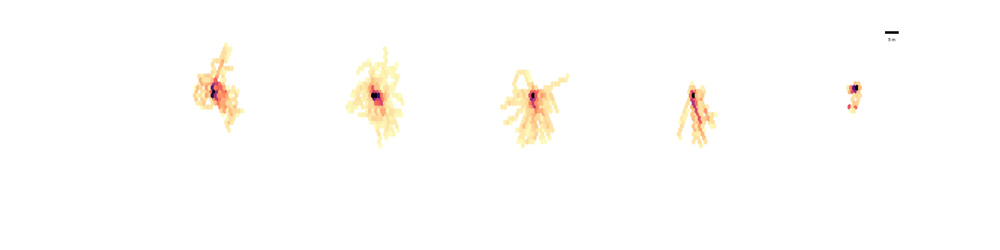

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f0537631a90>,
      dtype=object)

In [53]:
treeFig(dfl,'wind_speed',naked=True,hexBin=False,cmap='magma_r',figsize=(16,4))

<IPython.core.display.Javascript object>


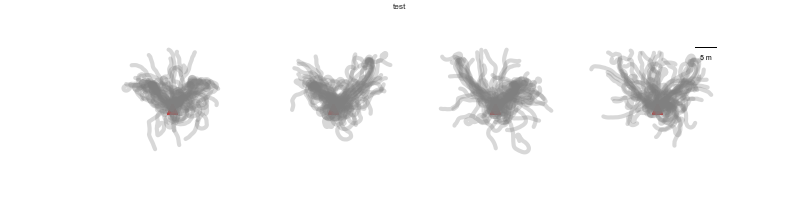

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f9bfdd5f2d0>,
      dtype=object)

In [14]:
treeFig(dfang,'ang',naked=True)

<IPython.core.display.Javascript object>


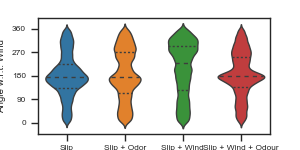

Text(0.5,0,'')

In [167]:
nsecs=200
runs=100
dfdl=[]
for i,df in enumerate(dfvs):
    p=plv[i]['metadata']['playerInitPos']
    if (p[0]==513) and (p[1]==480):
        df=addBoutFrame(df)
        dfdl.append(df)

dfd=pd.concat(dfdl)    
plt.figure(figsize=(3,1.5))

#             dfd['servo']=(dfd.trajectory__servoAngle-90)%360
dfd['servo']=(dfd.trajectory__pOri_x-180)%360

ax=sns.violinplot(x='trajectory__case',y='servo',data=dfd[(dfd.trajectory__speed>0)&
                  (dfd.frame>165)&
                  (dfd.frame<165*nsecs)&(dfd.trajectory__case>-1)&
                  (dfd.trajectory__runNum<runs)&(dfd.trajectory__isFlying)],
                  inner='quartile',scale_hue=False,)#palette={0.0: "g", 1.0: "b", 2.0:"b",3.0:'#ffbaba9f'},saturation=1)

ax.yaxis.set_major_locator(ticker.MultipleLocator(90))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())

ax.set_xticklabels(['Slip','Slip + Odor','Slip + Wind','Slip + Wind + Odour'])
plt.ylabel('Angle w.r.t. Wind')
plt.xlabel('')


In [19]:
dfvsa,plv=h5DirLoader('/media/rhagoletis/Traj/aggreg/odour/vadaslipall/')


0 of 11
1 of 11
2 of 11
3 of 11
4 of 11
5 of 11
6 of 11
7 of 11
8 of 11
9 of 11
10 of 11


<IPython.core.display.Javascript object>


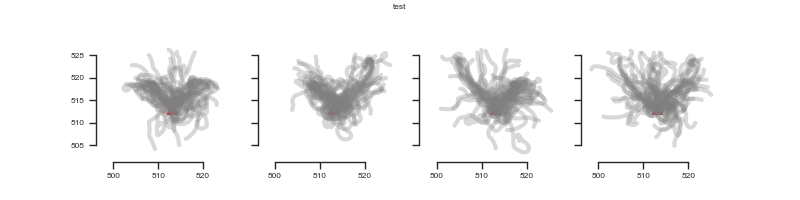

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f9bfc711350>,
      dtype=object)

In [65]:
treeFig(dfang,'ang')

In [57]:
ycut=482

In [58]:
dfvsas=[]
for i, df in enumerate(dfvsa):
    s= ((((df.trajectory__pPos_y>ycut)&(df.trajectory__case==3))*1)).sum()
    if s > 1:
        dfvsas.append(df)
        print s, plv[i]['bagFileName'].split('/')[-1]


4555 2018-12-04__15~26~07_haw119_11_odour_wind_gain~8_speed~0.5_bout~99_DC~0.0_traj.bag.h5
18782 2018-12-04__18~04~30_haw120_11_odour_wind_gain~8_speed~0.5_bout~99_DC~0.0_traj.bag.h5
10859 2018-12-05__13~47~15_haw121_11_odour_wind_gain~8_speed~0.5_bout~99_DC~0.0_traj.bag.h5
6161 2018-12-05__15~01~52_haw121_11_odour_wind_gain~8_speed~0.5_bout~99_DC~0.0_traj.bag.h5
9596 2019-01-13__15~51~11_haw123_11_odour_wind_gain~4_speed~0.5_bout~99_DC~0.18_traj.bag.h5
6485 2019-01-14__13~13~47_haw124_11_odour_wind_gain~8_speed~0.5_bout~99_DC~0.0_traj.bag.h5


<IPython.core.display.Javascript object>


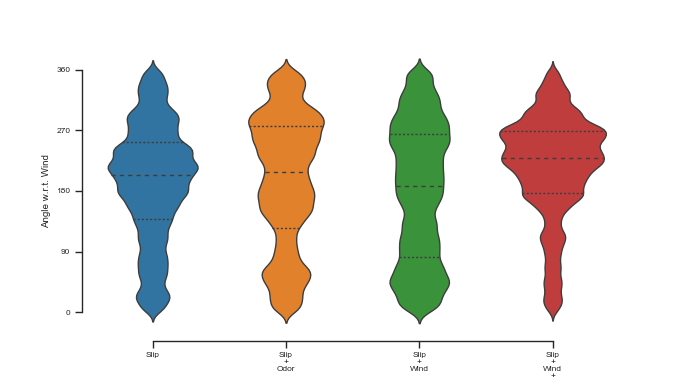

In [64]:
treeFig(dfvsas,'vio_vada',lw=0.75,nsecs=30)

<IPython.core.display.Javascript object>


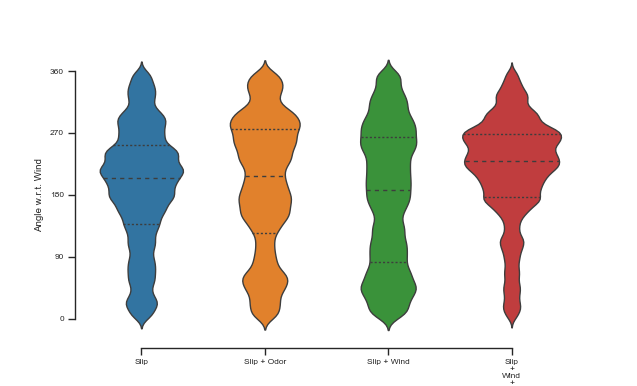

In [62]:
treeFig(dfvsas,'vio_vada',lw=0.75)

<IPython.core.display.Javascript object>


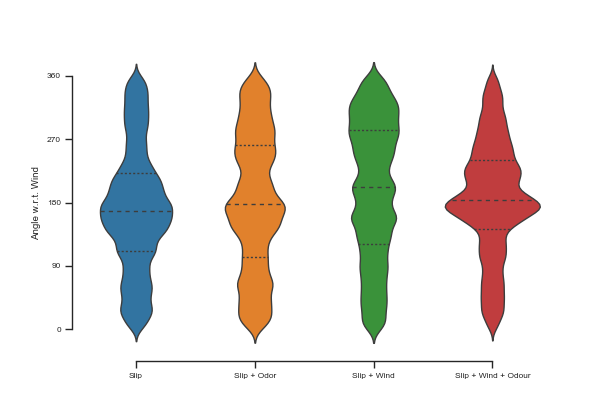

In [50]:
treeFig(dfvsas,'vio_vada',lw=0.75)

<IPython.core.display.Javascript object>


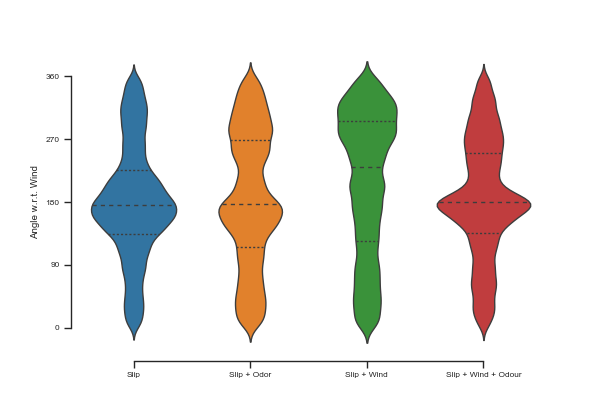

In [47]:
treeFig(dfvsas,'vio_vada',lw=0.75)

<IPython.core.display.Javascript object>


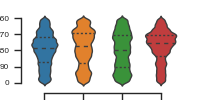

In [43]:
treeFig(dfvsa,'vio_vada',lw=0.75,nsecs=300)

In [23]:
treeFig(dfvsa,'vio_vada',lw=0.75)

<IPython.core.display.Javascript object>

In [331]:
nsecs=200

dfdl=[]
for i,df in enumerate(dfvsa):
    p=plv[i]['metadata']['playerInitPos']
    if (p[0]==513) and (p[1]==480):
        df=addBoutFrame(df)
        dfdl.append(df)

dfd=pd.concat(dfdl)    

# f,ax=plt.subplots(1,4,'all','all',figsize=(6,1.5))
# #     if hexBin:
# hexQuadBinner(dfd[(dfd.frame>165)&(dfd.frame<165*nsecs) & (dfd.trajectory__case >-1)],1,)
#                       xlim=xlim,ylim=ylim,extent=extent)
#     else:
# pltQuadTrajPlot(dfd[(dfd.frame>165)&(dfd.frame<165*nsecs) & (dfd.trajectory__case >-1)],ax=ax,tit='',)#runs=runs,xlim=xlim,ylim=ylim)

<IPython.core.display.Javascript object>


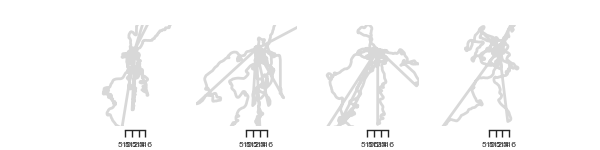

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


no params, error in auto start find, ressetting to defaukt
no params, error in auto start find, ressetting to defaukt
no params, error in auto start find, ressetting to defaukt
no params, error in auto start find, ressetting to defaukt


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f28ec9e1c50>,
      dtype=object)

In [175]:

treeFig(dfvs,'vada')

<IPython.core.display.Javascript object>


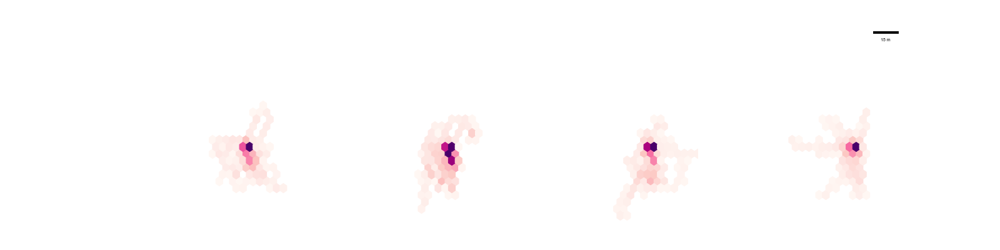

In [332]:
f,ax=plt.subplots(1,4,'all','all',figsize=(16,4))
#     if hexBin:
hexQuadBinner(dfd[(dfd.frame>165)&(dfd.frame<165*nsecs) & (dfd.trajectory__case >-1)],1,ax=ax,xlim=(440,540),ylim=(440,540),extent=[440,540,440,540],vmax=None,cmap='RdPu')

sns.despine(left=True,bottom=True,trim=True,offset=None)
ax[0].set_yticks([], minor=False)
ax[0].set_xticks([], minor=False)
from matplotlib_scalebar.scalebar import ScaleBar
scalebar = ScaleBar(1,frameon=False) # 1 pixel = 0.2 meter
plt.gca().add_artist(scalebar)
        
figType='vada_hex'
path=''
plt.savefig(path+'_'+figType+'_plt.png',transparent=True,papertype='A4',frameon=False,dpi=300,)
plt.savefig(path+'_'+figType+'_plt.svg',transparent=True,papertype='A4',frameon=False,)

In [99]:
_d=dfd[(dfd.frame>165)&(dfd.frame<165*nsecs) & (dfd.trajectory__case ==3)]

<IPython.core.display.Javascript object>


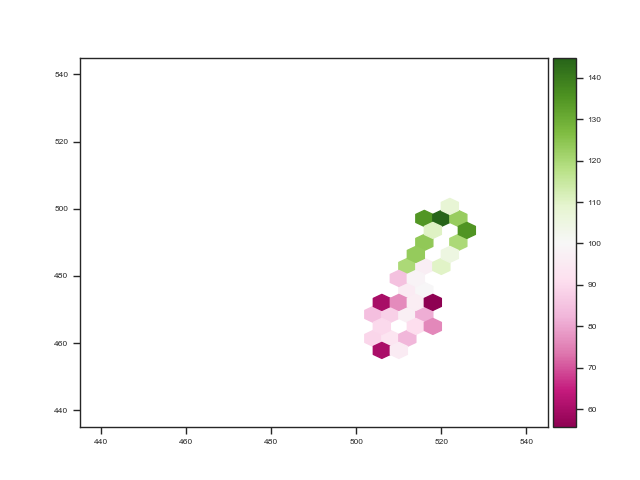

In [138]:
plt.figure()
_d=dfd[(dfd.frame>165)&(dfd.frame<165*nsecs) & (dfd.trajectory__case ==0)]
ax=plt.hexbin(_d['trajectory__pPos_x'],_d['trajectory__pPos_y'],(_d['trajectory__pOri_x']-45)%180, cmap='PiYG',mincnt=1,gridsize=25,extent=[440,540,440,540])
cb=colorbar(ax)

<IPython.core.display.Javascript object>


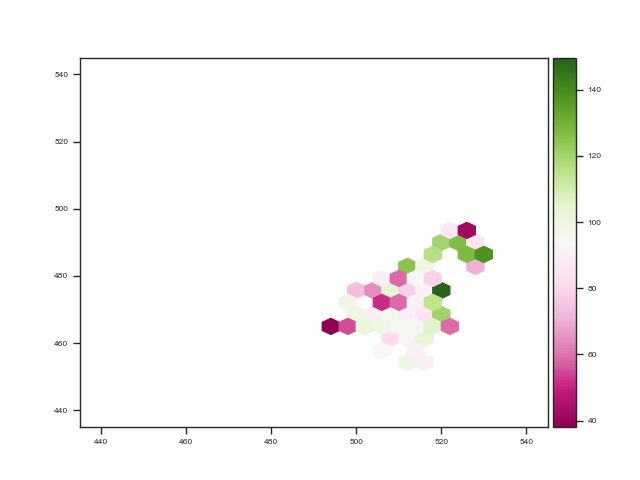

In [137]:
plt.figure()
_d=dfd[(dfd.frame>165)&(dfd.frame<165*nsecs) & (dfd.trajectory__case ==1)]
ax=plt.hexbin(_d['trajectory__pPos_x'],_d['trajectory__pPos_y'],(_d['trajectory__pOri_x']-45)%180, cmap='PiYG',mincnt=1,gridsize=25,extent=[440,540,440,540])
cb=colorbar(ax)

<IPython.core.display.Javascript object>


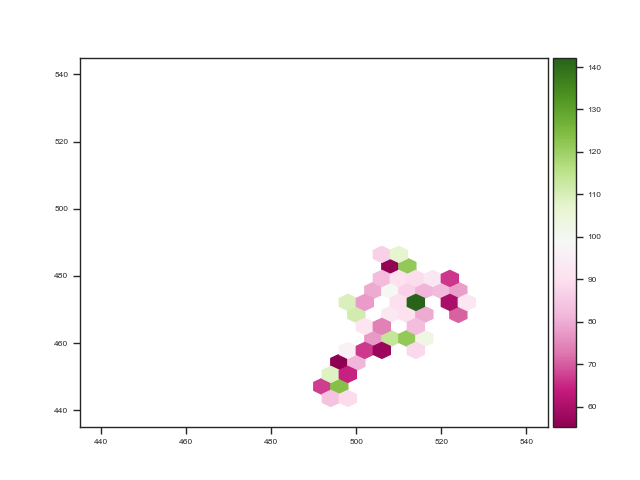

In [136]:
plt.figure()
_d=dfd[(dfd.frame>165)&(dfd.frame<165*nsecs) & (dfd.trajectory__case ==2)]
ax=plt.hexbin(_d['trajectory__pPos_x'],_d['trajectory__pPos_y'],(_d['trajectory__pOri_x']-45)%180, cmap='PiYG',mincnt=1,gridsize=25,extent=[440,540,440,540])
cb=colorbar(ax)

<IPython.core.display.Javascript object>


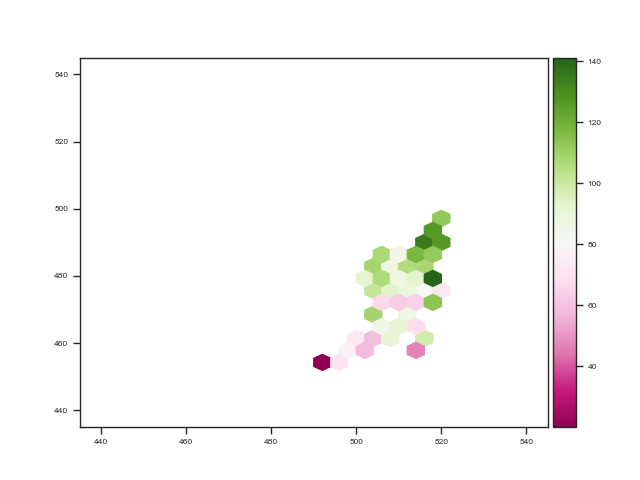

In [135]:
plt.figure()
_d=dfd[(dfd.frame>165)&(dfd.frame<165*nsecs) & (dfd.trajectory__case ==3)]
ax=plt.hexbin(_d['trajectory__pPos_x'],_d['trajectory__pPos_y'],(_d['trajectory__pOri_x']-45)%180, cmap='PiYG',mincnt=1,gridsize=25,extent=[440,540,440,540])
cb=colorbar(ax)

<IPython.core.display.Javascript object>


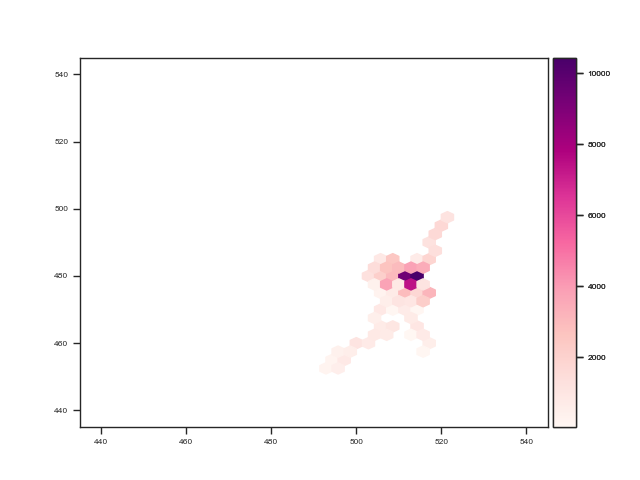

In [104]:
plt.figure()
ax=plt.hexbin(_d['trajectory__pPos_x'],_d['trajectory__pPos_y'],cmap='RdPu',mincnt=1,gridsize=35,extent=[440,540,440,540])
cb=colorbar(ax)

<IPython.core.display.Javascript object>


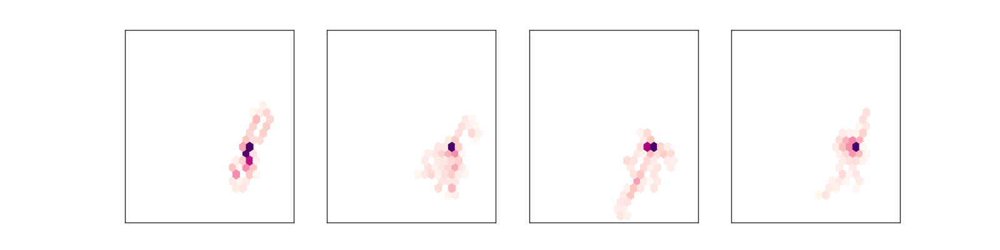

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f2890057e90>,
      dtype=object)

In [84]:
f,ax=plt.subplots(1,4,'all','all',figsize=(16,4))
#     if hexBin:
hexQuadBinner(dfd[(dfd.frame>165)&(dfd.frame<165*nsecs) & (dfd.trajectory__case >-1)],1,ax=ax,xlim=(440,540),ylim=(440,540),extent=[440,540,440,540],vmax=None,cmap='RdPu')


<IPython.core.display.Javascript object>


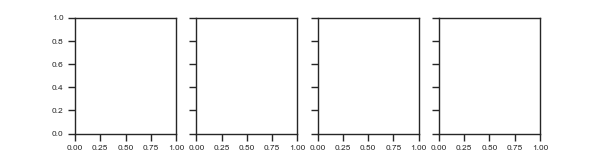

<IPython.core.display.Javascript object>


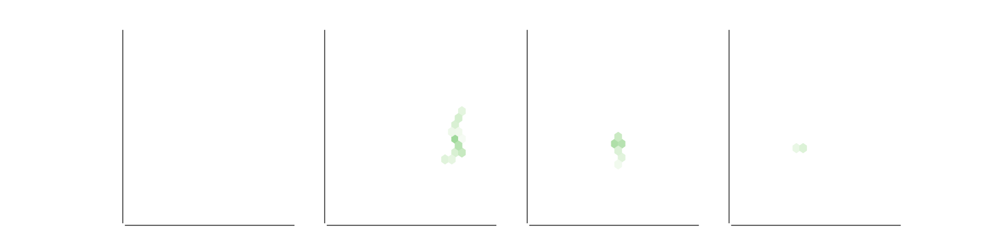

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f28a2c0a710>,
      dtype=object)

In [74]:
treeFig(dfvs,'vada',lw=0.75,hexBin=True,xlim=(460,500),ylim=(460,500),extent=[460,500,460,500])

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:264: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


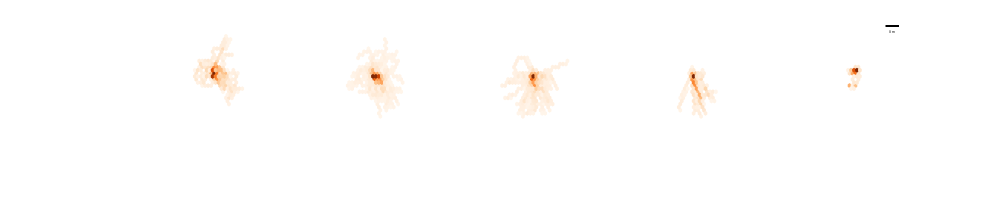

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f28cb85b710>,
      dtype=object)

In [56]:
treeFig(dfl,'wind_speed',figsize=(20,4),naked=True,cmap='Oranges')

<IPython.core.display.Javascript object>


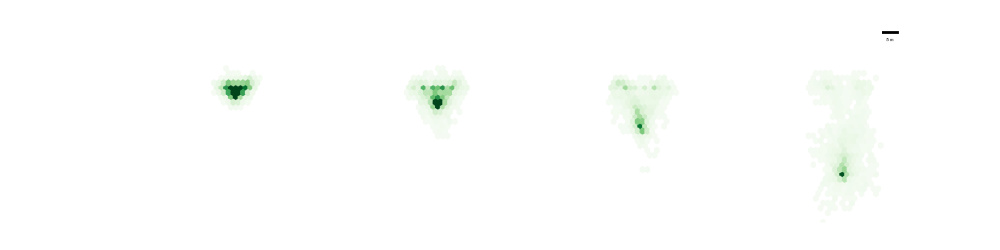

In [18]:
ax=treeFig(dfl,'tree_dist_ang',despine=True,naked=True)

In [270]:
pldl=[]
for p in pl:
    pldl.append([p['playerInitPos'][:2],p['posL'],p['posR']])

In [271]:
pld=pd.DataFrame(pldl)
pld.columns=['a','b','c']


In [272]:
print pld.b.value_counts(), '\n',pld.c.value_counts()

[510, 516, 0]    23
[519, 516, 0]    21
[510, 516, 0]    15
[507, 516, 0]     6
(516, 516, 0)     4
[509, 517, 0]     2
[507, 519, 0]     1
[506, 516, 0]     1
(510, 516, 0)     1
[516, 516, 0]     1
Name: b, dtype: int64 
[516, 516, 0]    38
[507, 516, 0]    21
[519, 516, 0]     6
(510, 516, 0)     4
[517, 517, 0]     2
[520, 516, 0]     1
(516, 516, 0)     1
[510, 516, 0]     1
[519, 519, 0]     1
Name: c, dtype: int64


In [273]:
pld.a.value_counts()

[513, 510]    17
[513, 513]    13
[513, 513]     9
[513, 504]     9
[513, 507]     8
[513, 492]     7
(513, 511)     1
[513, 500]     1
[513, 490]     1
[514, 510]     1
[513, 506]     1
[513, 480]     1
(513, 507)     1
(513, 496)     1
(513, 513)     1
(513, 503)     1
[513, 511]     1
[514, 513]     1
Name: a, dtype: int64

In [276]:
a=[[],[],[],[]]

for i, df in enumerate(dfl):
    for j,ip in enumerate(dist):
        if (pl[i]['playerInitPos'][0]==ip[0]) and (pl[i]['playerInitPos'][1]==ip[1]) : 
            #and(pl[i]['posL'][0]==519)and(pl[i]['posL'][1]==516):
            
            a[j].append(df)

In [277]:
for i in a:
    print len(i)

23
17
9
7


In [103]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
def colorbar(mappable):
    ax = mappable.axes
    fig = ax.figure
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    return fig.colorbar(mappable, cax=cax)

<IPython.core.display.Javascript object>


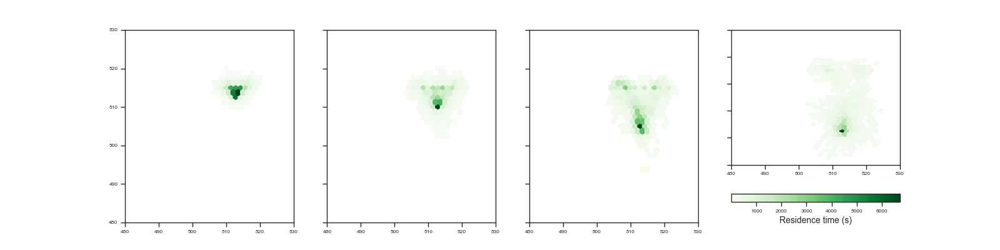

In [374]:
# df=pd.concat(dfang)
a=[[],[],[],[]]

for i, df in enumerate(dfl):
    for j,ip in enumerate(dist):
        if (pl[i]['playerInitPos'][0]==ip[0]) and (pl[i]['playerInitPos'][1]==ip[1]) : 
            #and(pl[i]['posL'][0]==519)and(pl[i]['posL'][1]==516):
            
            a[j].append(df)

f,ax=plt.subplots(1,4,sharex=True, sharey=True,figsize=(16,4))
ax=ax.reshape(1,4)[0]
w=15
xs=parameters['playerInitPos'][0]
ys=parameters['playerInitPos'][1]


for i in range(4):
    df=pd.concat(a[i])
#     df=df[df.trajectory__runNum<15]
#     ax[i].set_aspect('equal','datalim')
#     ax[i].set_xlim(513-w,513+w)
#     ax[i].set_ylim(518-w,518+w)
    ax[i].set_xlim(480,530)
    ax[i].set_ylim(480,530)

#     ax[i].set_yticks([], minor=False)
#     ax[i].set_xticks([], minor=False)
#     ax[i].scatter(xs,ys,marker='^',s=40,c='r')
#     ax[i].scatter(parameters['posL'][0],parameters['posL'][1],marker='^',s=4,c='r',alpha=0.2)
#     ax[i].scatter(parameters['posR'][0],parameters['posR'][1],marker='^',s=4,c='r',alpha=0.2)

    hb=ax[i].hexbin(df[(df.trajectory__speed>0)&(df.trajectory__case>0)].trajectory__pPos_x.loc[::5],
                df[(df.trajectory__speed>0)&(df.trajectory__case>0)].trajectory__pPos_y.loc[::5],
                gridsize=35 ,vmin=1,mincnt=100,cmap='Greens', extent=[480,530,480,530])

    
from mpl_toolkits.axes_grid1 import make_axes_locatable
def colorbar(mappable):
    ax = mappable.axes
    fig = ax.figure
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    return fig.colorbar(mappable, cax=cax)

# cb=colorbar(hb)

# cb.ax.set_yticklabels(np.int8(cb.get_ticks()/165),fontsize=10)
# cb.set_label('Residence time (s)',fontsize=10)

In [375]:
cb = f.colorbar(hb, ax=ax[3],orientation='horizontal')
cb.ax.set_yticklabels(np.int8(cb.get_ticks()/165),fontsize=10)
cb.set_label('Residence time (s)',fontsize=10)

<IPython.core.display.Javascript object>


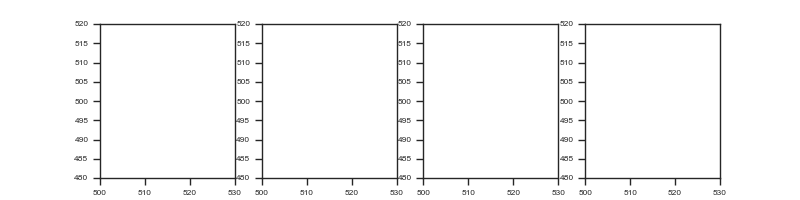

In [117]:
dist=[(513,513),(513,510),(513,504),(513,492)]
f,ax=plt.subplots(1,len(dist),figsize=(8,2))#(4*len(dist),4))
ax=ax.reshape(len(dist))
for i, df in enumerate(dfl):
    for j,ip in enumerate(dist):
        parameters=pl[i]
        xs=pl[i]['playerInitPos'][0]
        ys=pl[i]['playerInitPos'][1]==ip[1]
        if (xs) and (ys) \
            and(pl[i]['posL'][0]==519)and(pl[i]['posL'][1]==516):
            hb=ax[j].hexbin(df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_x.loc[::5],
                            df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_y.loc[::5],cmap='Blues')
                            #vmax=vmax,gridsize=gridsize ,mincnt=mincnt,cmap=cmap,)
#             ax[j].set_aspect('equal','datalim')
            ax[j].set_xlim(500,530)
            ax[j].set_ylim(480,520)
#             ax[j].set_xlim(513-w,513+w)
#             ax[j].set_ylim(518-w,518+w)

#             ax[j].set_yticks([], minor=False)
#             ax[j].set_xticks([], minor=False)
#             ax[j].scatter(xs,ys,marker='^',s=40,c='r')
#             ax[j].scatter(parameters['posL'][0],parameters['posL'][1],marker='^',s=4,c='r',alpha=0.2)
#             ax[j].scatter(parameters['posR'][0],parameters['posR'][1],marker='^',s=4,c='r',alpha=0.2)

In [267]:
plt.axhline(180,)
plt.axhline(180+45,)
plt.axhline(180+90,)

<IPython.core.display.Javascript object>


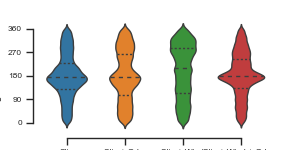

In [146]:
treeFig(dfvs,'vio_vada',lw=0.75)

In [148]:
In[146]

u"treeFig(dfvs,'vio_vada',lw=0.75)"

<IPython.core.display.Javascript object>


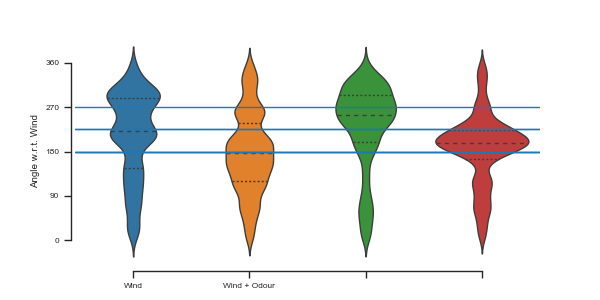

In [263]:
treeFig(dfvs,'vio_vada',lw=0.75)

<IPython.core.display.Javascript object>


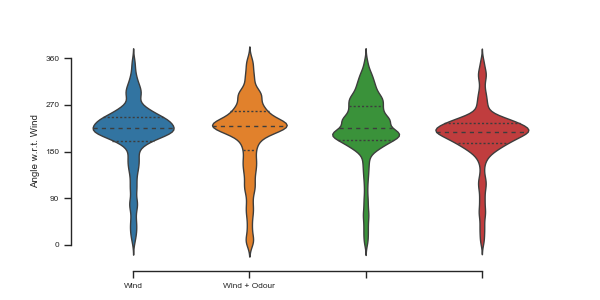

In [261]:
treeFig(dfvsa,'vio_vada',lw=0.75)

<IPython.core.display.Javascript object>


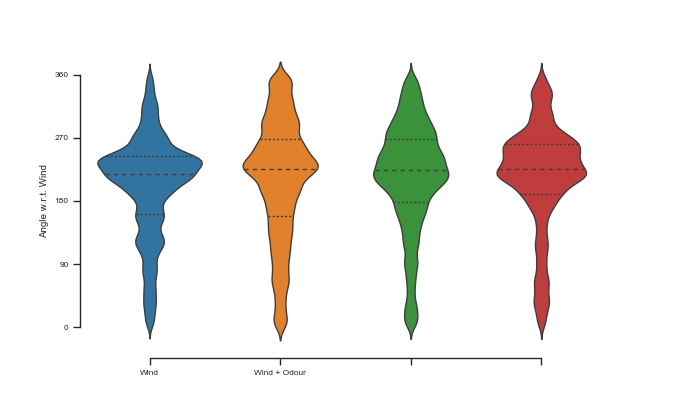

In [255]:
treeFig(dfvsa,'vio_vada',lw=0.75)

<IPython.core.display.Javascript object>


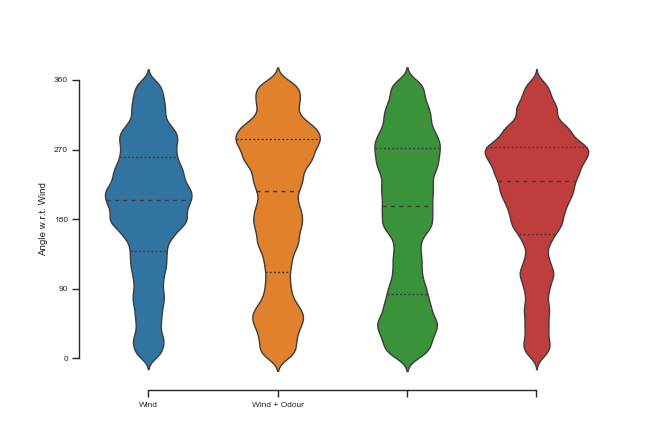

In [250]:
treeFig(dfvsa,'vio_vada',lw=0.75)

<IPython.core.display.Javascript object>


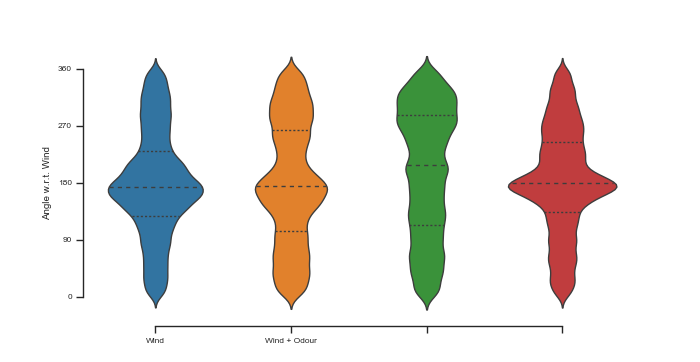

In [251]:
treeFig(dfvs,'vio_vada',lw=0.75)

<IPython.core.display.Javascript object>


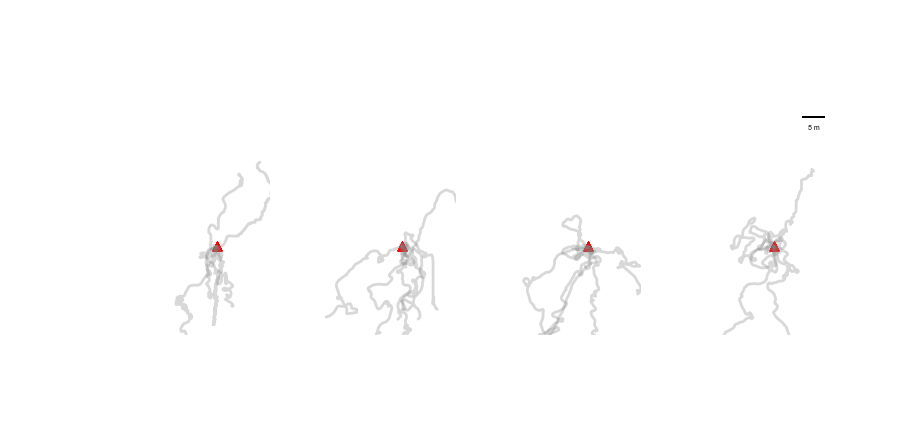

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe22e2fed10>,
      dtype=object)

In [248]:
treeFig(dfvs,'vada',naked=True,xlim=(490,525),ylim=(460,510))

<IPython.core.display.Javascript object>


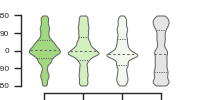

In [156]:
treeFig(dfl,'vio_tree_dist',lw=0.75)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:299: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:304: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:305: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<IPython.core.display.Javascript object>


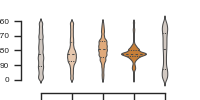

In [135]:
treeFig(dfl,'vio_wind_speed',lw=0.75)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:248: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


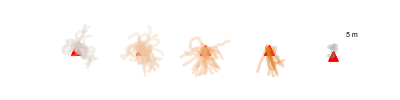

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe1dcacc950>,
      dtype=object)

In [122]:
treeFig(dfl,'wind_speed',naked=True)

In [21]:
def splitDf(df):
    dfs=np.split(df.reset_index(),np.where(df.trajectory__reset==1)[0])
    return dfs

In [22]:
def inbbox(tl,br,pos):
    return ((pos[0]>tl[0]) & (pos[0]<br[0]) & (pos[1]>br[1]) & (pos[1]<tl[1]))

In [23]:
def tlbr(c,w,h=None):
    #width and height are halw widths and half heights (radius like)
    if h is None:
        h=w
    tl = (c[0]-w,c[1]+h)
    br = (c[0]+w,c[1]-h)
    return tl,br

In [263]:
tl=(512,514)
br=(516,510)

(inbbox(tl,br, (df['trajectory__pPos_x'],df['trajectory__pPos_y']))*1).plot()

In [269]:
tlbr((513,513),1,500)

((512, 1013), (514, 13))

<IPython.core.display.Javascript object>


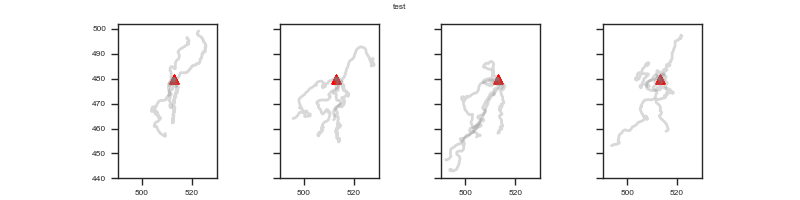

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe22dadb750>,
      dtype=object)

In [311]:
pltQuadTrajPlot(dfvs[1])

In [327]:
df=pd.concat(dfvsa)
df=df[df['trajectory__isFlying']==True]

tl,br=tlbr((513,513),1,500)
df['sr']=(inbbox(tl,br, (df['trajectory__pPos_x'],df['trajectory__pPos_y']))*1)

dfs=splitDf(df)


In [328]:
resL=[]
for dfx in dfs[:]:
    try:
        dfx_=dfx[['sr']].iloc[165:]
        res={}

        res['rt']=dfx_.sum()
        
        res['tot']=dfx.count()[0]
        res['case']=dfx.trajectory__case.iloc[0]
        res['runNum']=dfx.trajectory__runNum.iloc[0]
        resL.append(res)
    except IndexError:
        print 'hello'

hello


In [329]:
dfr=pd.DataFrame(resL)
dfr=pd.concat([dfr,dfr.rt.apply(pd.Series)],axis=1).drop('rt',axis=1)
# dfrg=(dfr.groupby(['case','runNum']).mean()).reset_index()#.astype(bool)*1).groupby('case').sum()
dfrgm=dfrg.melt(id_vars=['case'],value_vars=['sr'],var_name='pos',value_name='prt')

In [325]:
dfr

,case,runNum,tot,sr
0,0.0,1.0,16336,2285
1,1.0,1.0,16337,7848
2,2.0,1.0,16337,2078
3,3.0,1.0,16337,2482
4,0.0,2.0,16337,7385
5,1.0,2.0,16337,358
6,2.0,2.0,15459,5157
7,0.0,1.0,16336,4667
8,1.0,1.0,6727,2370
9,1.0,1.0,16336,6757


<IPython.core.display.Javascript object>


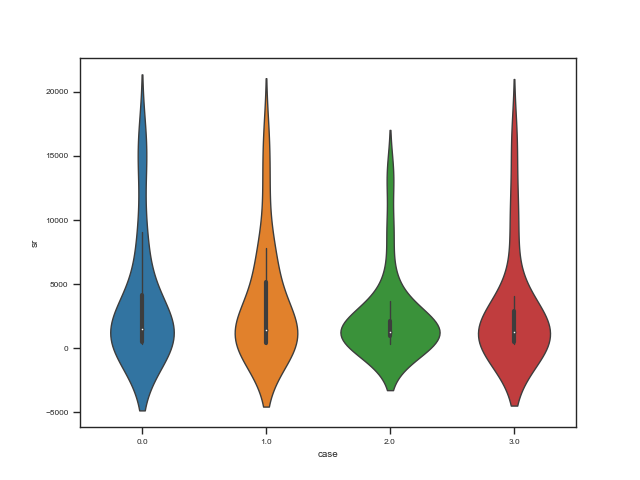

In [331]:
plt.figure()
dfr=dfr[dfr['tot']>10000]`
# sns.stripplot(x='case',y='sr',data=dfr,split=True,s=3,color='k')
# sns.boxplot(x='case',y='sr',data=dfr)
sns.violinplot(x='case',y='sr',data=dfr)

<IPython.core.display.Javascript object>


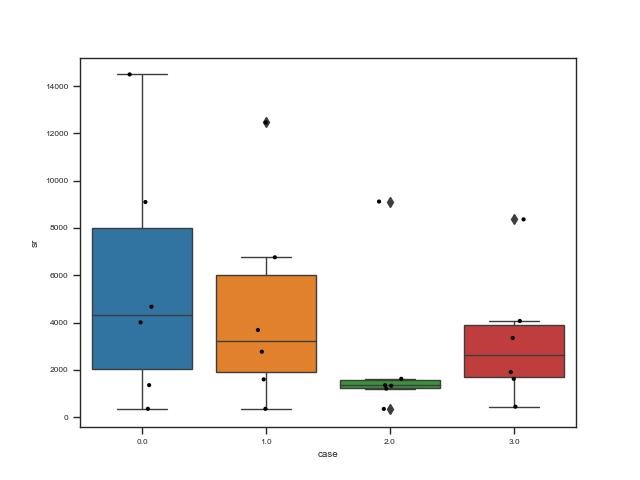

In [321]:
plt.figure()
dfr=dfr[dfr['tot']>10000]
sns.stripplot(x='case',y='sr',data=dfr,split=True,s=3,color='k')
sns.boxplot(x='case',y='sr',data=dfr)

<IPython.core.display.Javascript object>


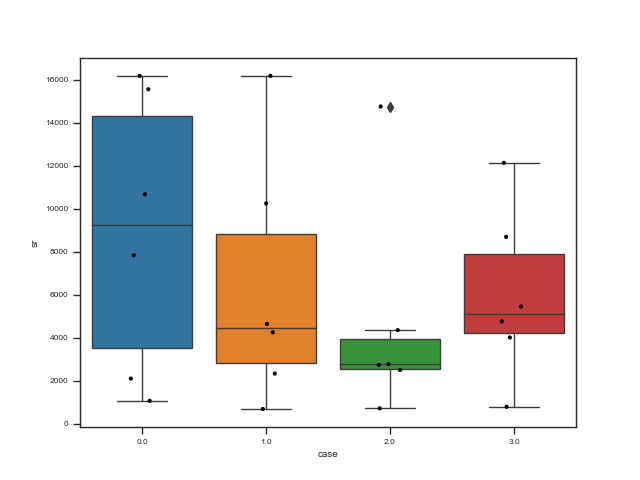

In [317]:
plt.figure()
dfr=dfr[dfr['tot']>10000]
sns.stripplot(x='case',y='sr',data=dfr,split=True,s=3,color='k')
sns.boxplot(x='case',y='sr',data=dfr)

<IPython.core.display.Javascript object>


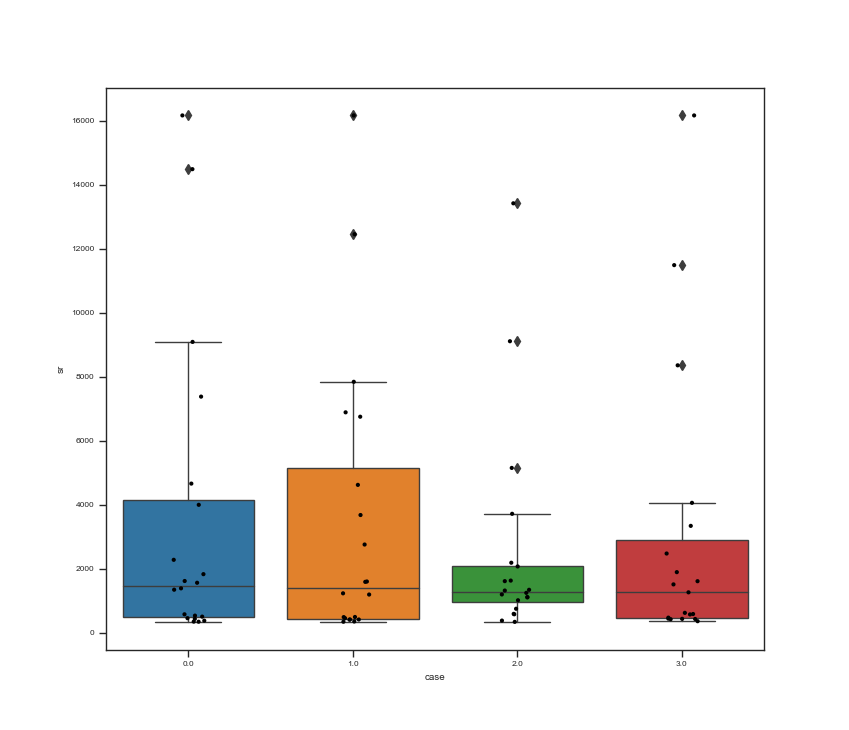

In [297]:
plt.figure()
dfr=dfr[dfr['tot']>10000]
sns.stripplot(x='case',y='sr',data=dfr,split=True,s=3,color='k')
sns.boxplot(x='case',y='sr',data=dfr)

In [288]:
dfr

,case,runNum,tot,sr
0,0.0,1.0,16336,2285
1,1.0,1.0,16337,7848
2,2.0,1.0,16337,2078
3,3.0,1.0,16337,2482
4,0.0,2.0,16337,7385
5,1.0,2.0,16337,358
6,2.0,2.0,15459,5157
7,0.0,1.0,16336,4667
8,1.0,1.0,15178,2370
9,1.0,1.0,16336,6757


<IPython.core.display.Javascript object>


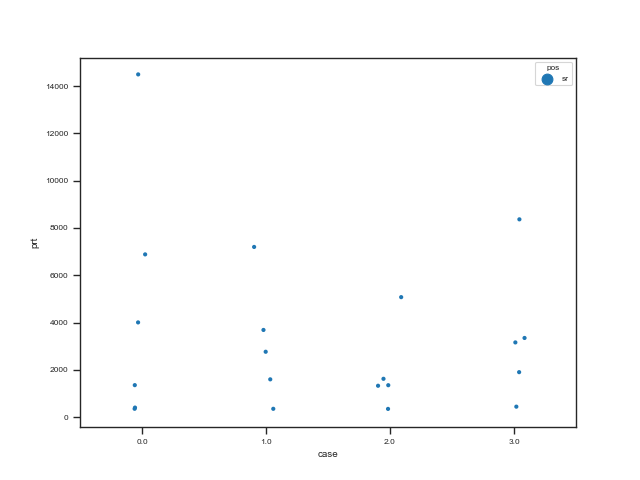

In [274]:
plt.figure()
sns.stripplot(x='case',y='prt',hue='pos',data=dfrgm,split=True,s=3)
# sns.boxplot(x='case',y='prt',hue='pos',data=dfrgm)

In [91]:
# tl=(512,1024)
# br=(514,0)
# df=dfvs[1]
# df=dfang[1]
df=pd.concat(dfang[:2])

tl,br=tlbr((519,519),3)
df['sr']=(inbbox(tl,br, (df['trajectory__pPos_x'],df['trajectory__pPos_y']))*1)

tl,br=tlbr((501,525),6)
df['bl']=(inbbox(tl,br, (df['trajectory__pPos_x'],df['trajectory__pPos_y']))*1)

tl,br=tlbr((507,519),3)
df['sl']=(inbbox(tl,br, (df['trajectory__pPos_x'],df['trajectory__pPos_y']))*1)

tl,br=tlbr((525,525),6)
df['br']=(inbbox(tl,br, (df['trajectory__pPos_x'],df['trajectory__pPos_y']))*1)
dfs=splitDf(df)

resL=[]
for dfx in dfs[:]:
    try:
        dfx_=dfx[['sl','sr','bl','br',]].iloc[165:]
        res={}

        res['rt']=dfx_.sum()
        
        res['tot']=dfx.count()[0]
        res['case']=dfx.trajectory__case.iloc[0]
        res['runNum']=dfx.trajectory__runNum.iloc[0]
        resL.append(res)
    except IndexError:
        print 'hello'

hello


hello


In [92]:
dfr=pd.DataFrame(resL)
dfr=pd.concat([dfr,dfr.rt.apply(pd.Series)],axis=1).drop('rt',axis=1)
dfrg=(dfr.groupby(['case','runNum']).mean()).reset_index()#.astype(bool)*1).groupby('case').sum()
dfrgm=dfrg.melt(id_vars=['case'],value_vars=['sl','sr','bl','br'],var_name='pos',value_name='prt')

In [95]:
dfrg=(dfr.groupby(['case','runNum']).mean().astype(bool)*1).groupby('case').sum()


<IPython.core.display.Javascript object>


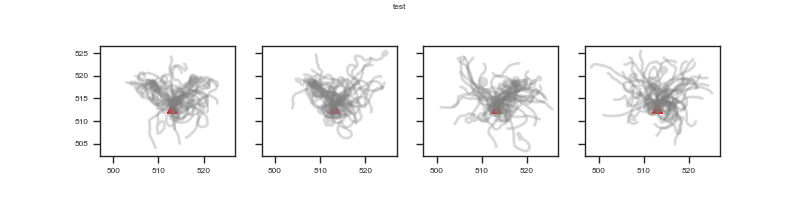

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe162732e90>,
      dtype=object)

In [61]:
pltQuadTrajPlot(df)

In [93]:
dfrgm['prt']=dfrgm['prt'].replace(0,np.nan)

<IPython.core.display.Javascript object>


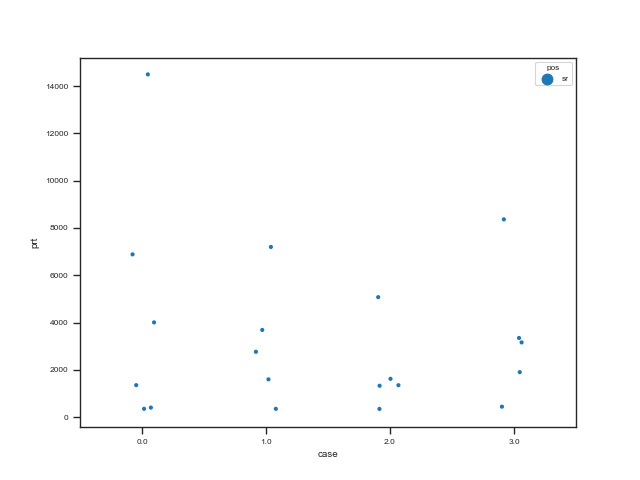

In [273]:
plt.figure()
sns.stripplot(x='case',y='prt',hue='pos',data=dfrgm,split=True,s=3)
# sns.boxplot(x='case',y='prt',hue='pos',data=dfrgm)

In [96]:
dfrg

,tot,sl,sr,bl,br
case,,,,,
0.0,40,14,16,3,7
1.0,39,18,12,4,4
2.0,39,10,17,5,5
3.0,39,10,12,6,6


In [221]:
def applyisinbbox(df,tl,br,pos):
    if ((df.trajectory__pPos_x>=tl[0]) and (df.trajectory__pPos_y<=tl[1]) and (df.trajectory__pPos_x<=br[0]) and (df.trajectory__pPos_y>=br[1])):
        return 1
    else:
        return 0
        

In [212]:
def isinbbox(df,tl,br,pos):
    if ((pos[0]>=tl[0]) and (pos[1]<=tl[1]) and (pos[0]<=br[0]) and (pos[1]>=br[1])):
        return True
    else:
        return False
        

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:342: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.



<IPython.core.display.Javascript object>


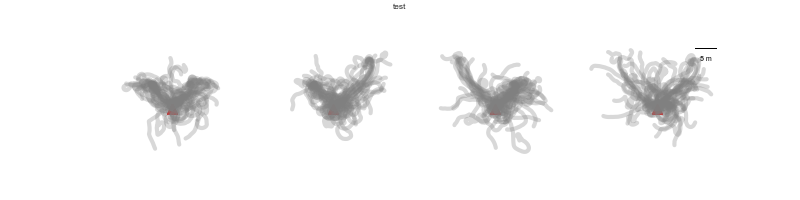

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f45074cc390>,
      dtype=object)

In [466]:
treeFig(dfang[:4],'ang',naked=True)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


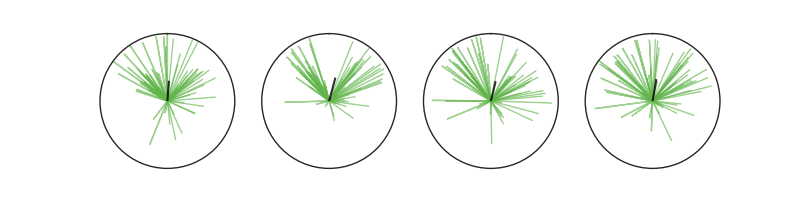

-4.486534455726213 0.29554479913056314 (0.001, 4.387819428273572) 7.106472726714472e-09 

-15.087456171746556 0.3535355320389979 (0.001, 4.272369043130205) 5.148434231905949e-10 

-13.65809636673967 0.29840887941232624 (0.001, 4.272369420019065) 7.235977919529578e-07 

-9.833277018689687 0.32456903081047095 (0.001, 4.272365410113412) 1.3701971877994116e-06 



In [119]:
moms=[]#mean of each trajectory run list
for i,df in enumerate(dfang):
    mom=meanOfMeaner(df,posLang=False)
    mom['fileStamp']=pl[i]['bagFileName'].split('/')[-1][:20]
    moms.append(mom)

#mean dataframe, every quad, every run, every individual, mean angle of heading, if poslang, angle w.r.t. 
mdf=pd.concat(moms,ignore_index=True)

#filter out runs with intermittent cuts/resets , take top 10 most frequent 
mdf2=mdf[mdf['dur'].isin(mdf.dur.value_counts().iloc[:10].index)]

def _meaner(d):
    return getCircularMean(d.a,d.r)


f,ax=plt.subplots(1,4,subplot_kw=dict(polar=True),figsize=(8,2))
ax=ax.reshape(4,)
for i in range(4):

    m=mdf2[(mdf2.case==i)]#&(mdf2.fileStamp.isin(filt))]
    aggregIndi = False
    if aggregIndi:
        m2=m.groupby(['fileStamp']).mean()
        _m=m.groupby(['fileStamp']).apply(_meaner).apply(pd.Series)
        m2['a'],m2['r']=_m[0],_m[1]
        m=m2

    polarRowPlot(m,ax,i)


<IPython.core.display.Javascript object>


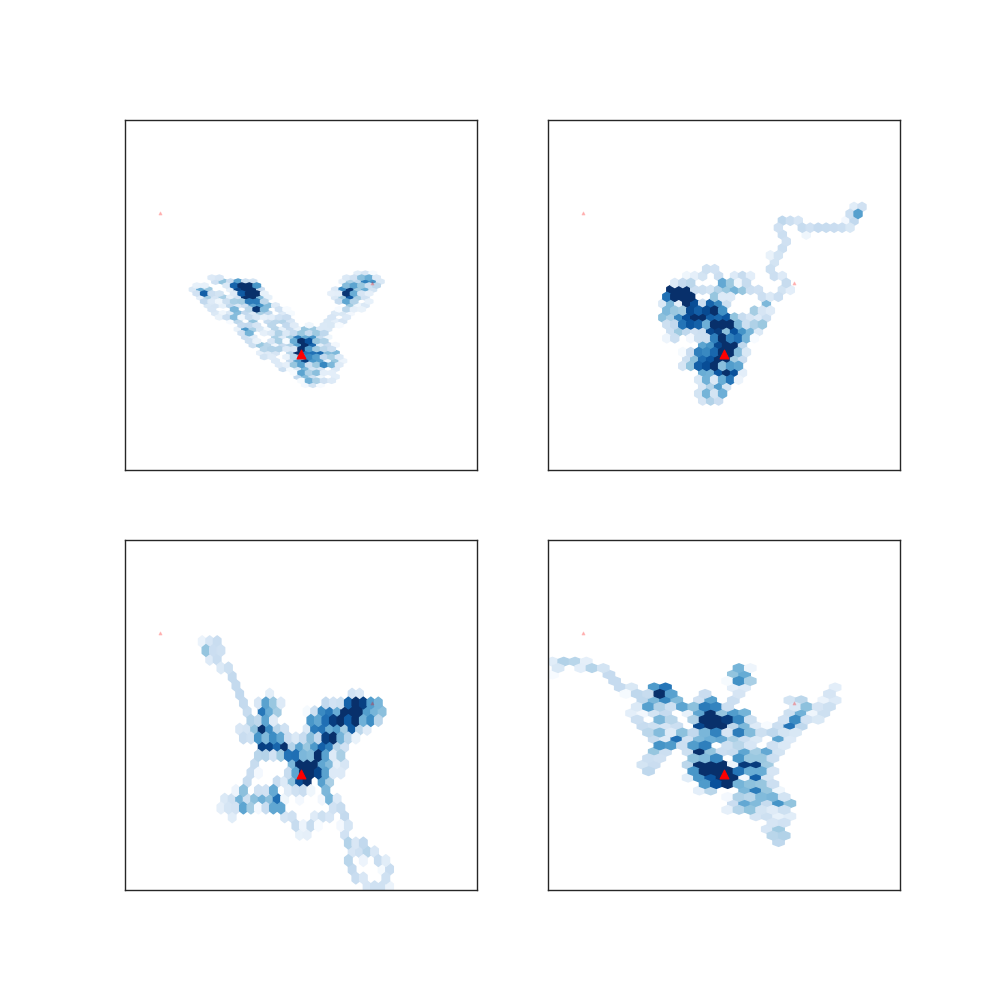

<IPython.core.display.Javascript object>


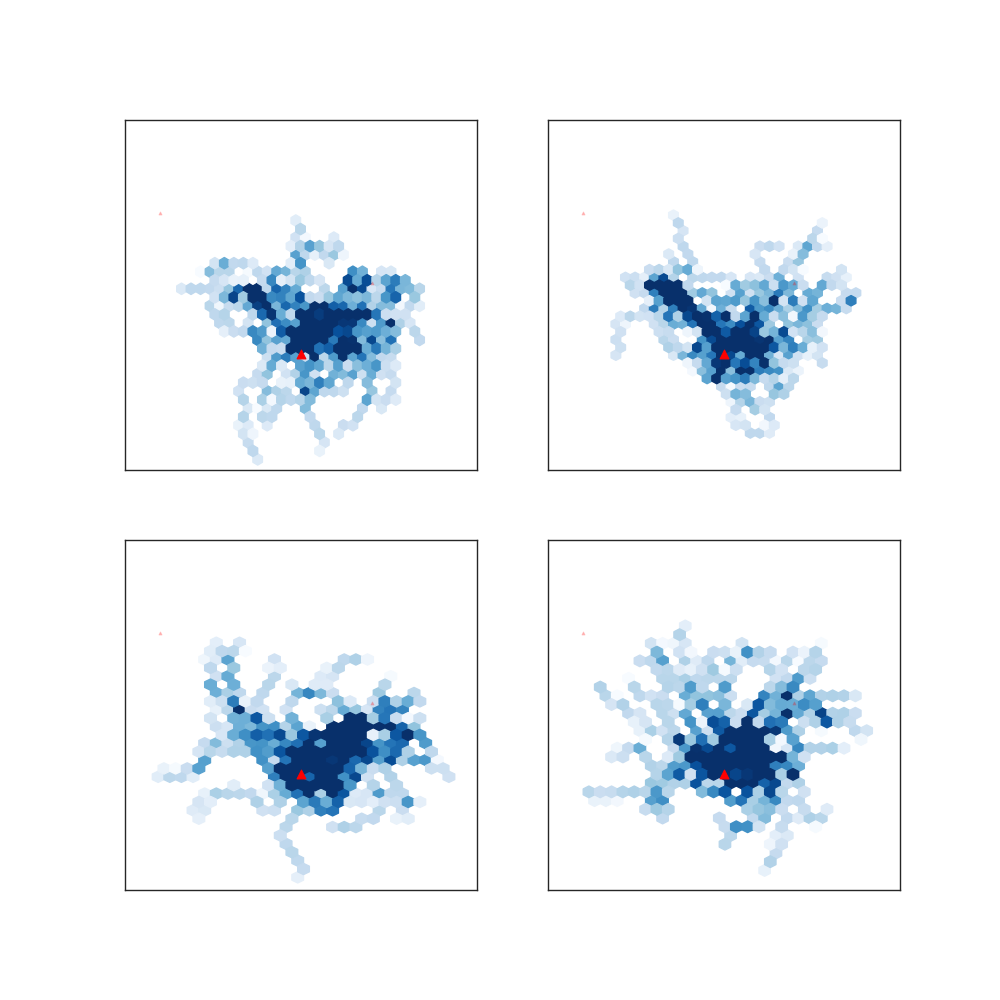

<IPython.core.display.Javascript object>


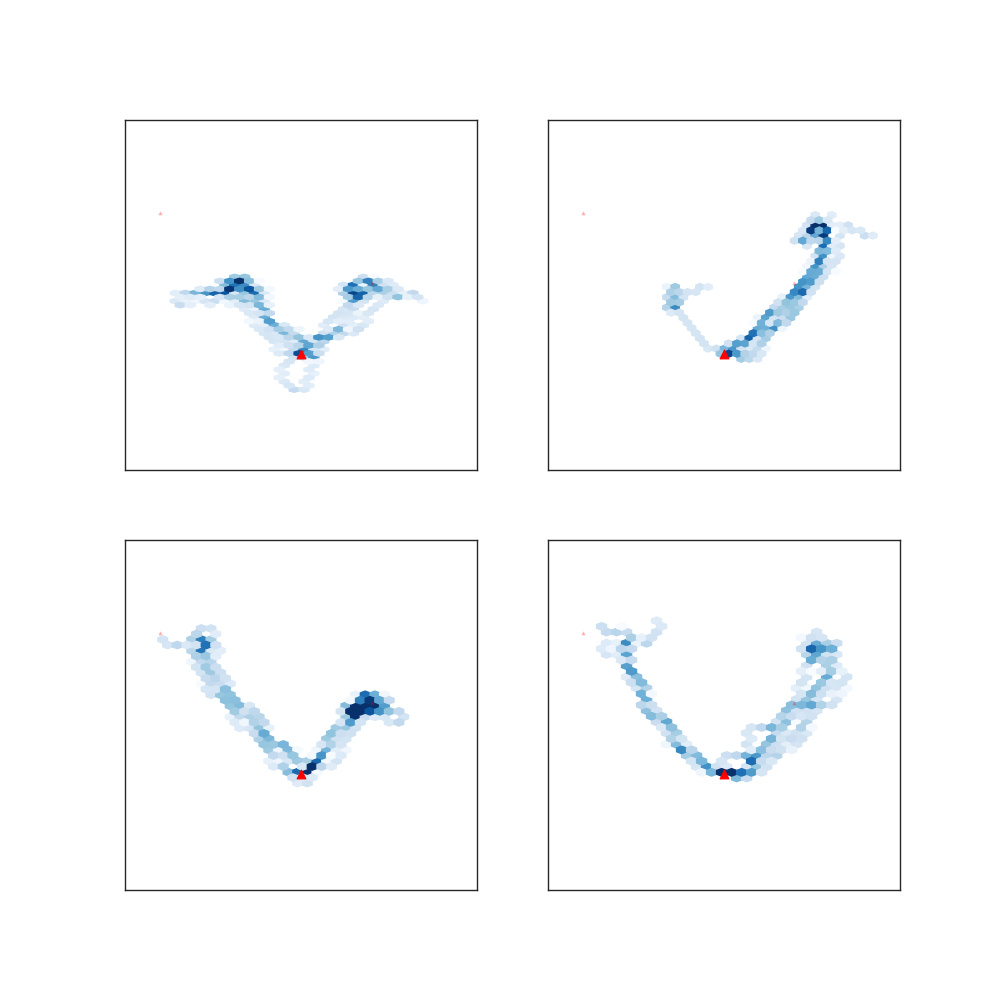

In [129]:
for i,df in enumerate(dfang[:3]):
    parameters=pang[i]['metadata']
    f,ax=plt.subplots(2,2,figsize=(10,10))
    ax=ax.reshape(1,4)[0]
    w=15
    xs=parameters['playerInitPos'][0]
    ys=parameters['playerInitPos'][1]

    for i in range(4):
        hb=ax[i].hexbin(df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_x.loc[::5],
                        df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_y.loc[::5],
                        vmax=100,gridsize=25 ,cmap='Blues',mincnt=1)
        ax[i].set_aspect('equal','datalim')
        ax[i].set_xlim(513-w,513+w)
        ax[i].set_ylim(518-w,518+w)

        ax[i].set_yticks([], minor=False)
        ax[i].set_xticks([], minor=False)
        ax[i].scatter(xs,ys,marker='^',s=40,c='r')
        ax[i].scatter(parameters['posL'][0],parameters['posL'][1],marker='^',s=4,c='r',alpha=0.2)
        ax[i].scatter(parameters['posR'][0],parameters['posR'][1],marker='^',s=4,c='r',alpha=0.2)

<IPython.core.display.Javascript object>


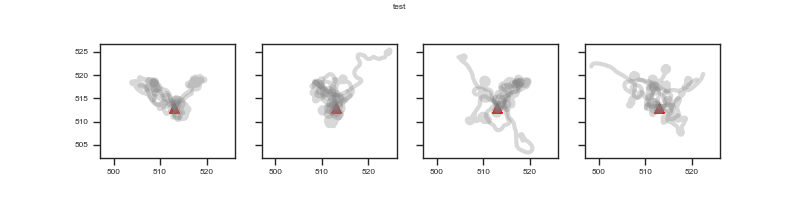

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


<IPython.core.display.Javascript object>


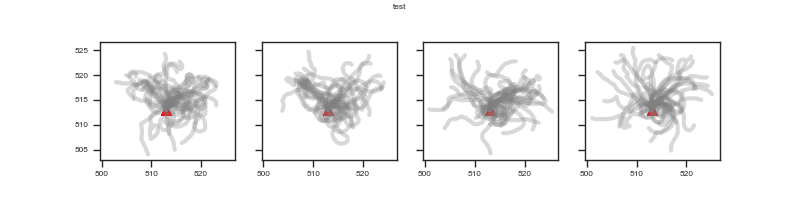

<IPython.core.display.Javascript object>


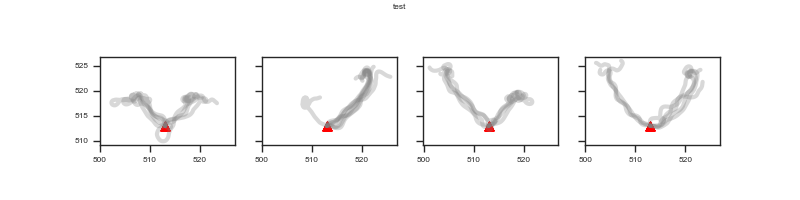

<IPython.core.display.Javascript object>


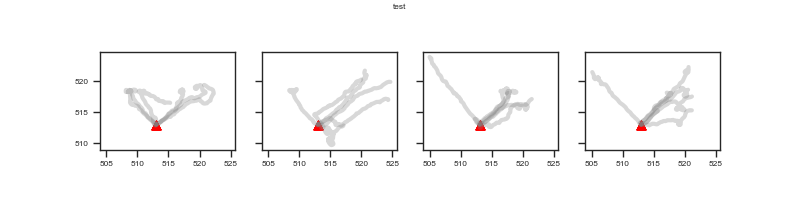

<IPython.core.display.Javascript object>


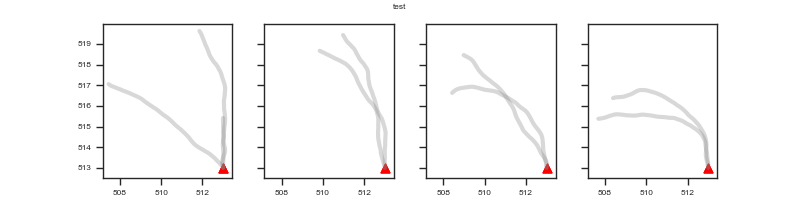

<IPython.core.display.Javascript object>


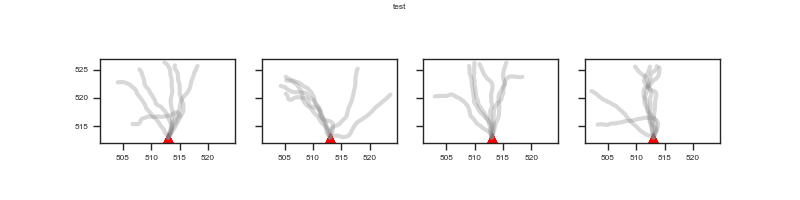

In [118]:
for df in dfang:
    pltQuadTrajPlot(df,linewidth=3)

<IPython.core.display.Javascript object>


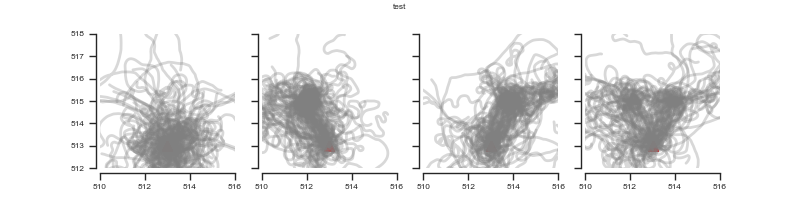

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f45085a8050>,
      dtype=object)

In [115]:
treeFig(dfl,'tree')

In [222]:
dfwt[0]

,trajectory__DCoffset,trajectory__boutFrame,trajectory__case,trajectory__caseU,trajectory__compensation,trajectory__gain,trajectory__groundSpeed,trajectory__headingControl,trajectory__impose,trajectory__imposeHeading,...,trajectory__slip,trajectory__speed,trajectory__speedControl,trajectory__trial,trajectory__valve1,trajectory__valve2,trajectory__valve3,trajectory__wbad,trajectory__wbas,frame
2017-07-20 09:48:44.470434816,0.0,0.0,0.0,NaN,0.0,8.0,422.068431,0.0,0.0,0.0,...,221.818427,0.0,0.0,1.0,0.0,0.0,0.0,6.522975e-02,1.776988,0.0
2017-07-20 09:48:44.475459072,0.0,0.0,0.0,NaN,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,6.522975e-02,1.776988,1.0
2017-07-20 09:48:44.481276160,0.0,0.0,0.0,NaN,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,6.522975e-02,2.168366,2.0
2017-07-20 09:48:44.487351040,0.0,0.0,0.0,NaN,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,6.522975e-02,2.168366,3.0
2017-07-20 09:48:44.493395968,0.0,0.0,0.0,NaN,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,3.044055e-01,1.929191,4.0
2017-07-20 09:48:44.499564800,0.0,0.0,0.0,NaN,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,3.261487e-01,1.907447,5.0
2017-07-20 09:48:44.505585920,0.0,0.0,0.0,NaN,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,3.261487e-01,1.907447,6.0
2017-07-20 09:48:44.511589888,0.0,0.0,0.0,NaN,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-4.348650e-02,2.016164,7.0
2017-07-20 09:48:44.517467904,0.0,0.0,0.0,NaN,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-4.348650e-02,2.016164,8.0
2017-07-20 09:48:44.523485952,0.0,0.0,0.0,NaN,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,8.697299e-02,1.798731,9.0


In [223]:
treeFig(dfwt,'tree_polar')#,runs=2,xlim=(508, 518), ylim=(510, 520))

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>

nan nan

ValueError: attempt to get argmax of an empty sequence

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>


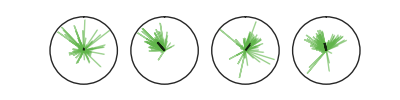

-7.986956359317052 0.07414546526839681 (0.001, 4.8479147301842795) 0.24703267775819465 

40.96540008374263 0.3168937069587733 (0.001, 4.873641071754568) 7.165365666211199e-28 

-37.61913133258365 0.23826602254435747 (0.001, 4.873646493137903) 8.519705443072192e-21 

13.071958503019877 0.22420226667546286 (0.001, 4.847932328594734) 9.07585420778855e-17 



array([<matplotlib.axes._subplots.PolarAxesSubplot object at 0x7fe16a8c4f90>,
      dtype=object)

In [227]:
treeFig(dfl,'tree_polar',runs=12,xlim=(508, 518), ylim=(510, 520))

<IPython.core.display.Javascript object>


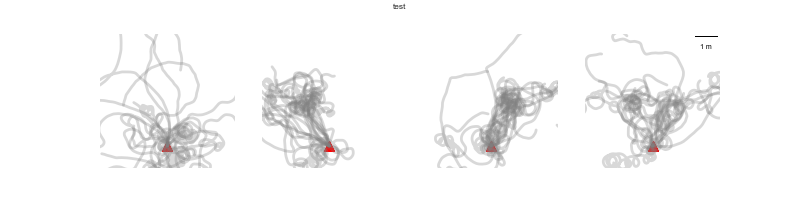

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe1d092b950>,
      dtype=object)

In [233]:
treeFig(dfl,'tree',runs=3,naked=True)

<IPython.core.display.Javascript object>


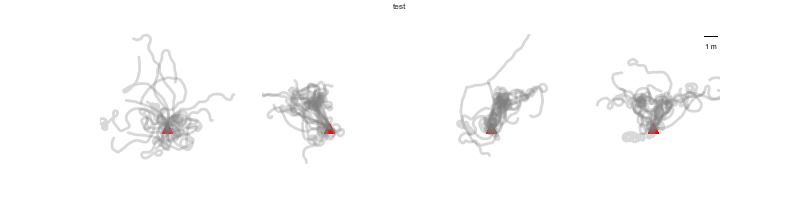

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe1d8596210>,
      dtype=object)

In [234]:
treeFig(dfl,'tree',naked=True,runs=3,xlim=(508, 518), ylim=(510, 520)) #main figure

<IPython.core.display.Javascript object>


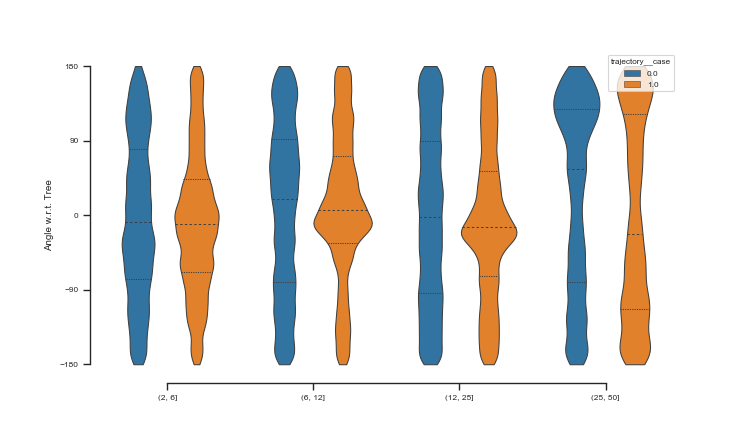

In [96]:

treeFig(dfl,'vio_tree_dist',treeDistPal=['#036F2E', '#5CB86A', '#BBE4B5','#E1F3DB'],lw=0.75)

<IPython.core.display.Javascript object>


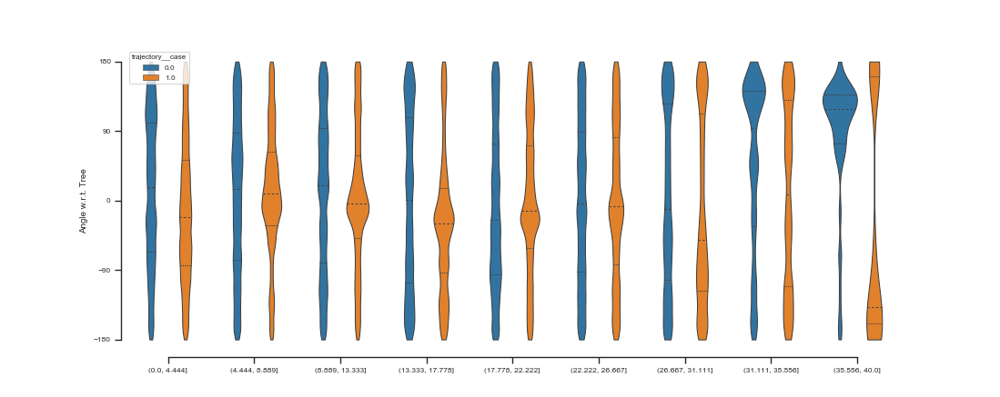

In [94]:

treeFig(dfl,'vio_tree_dist',treeDistPal=['#036F2E', '#5CB86A', '#BBE4B5','#E1F3DB'],lw=0.75)

<IPython.core.display.Javascript object>


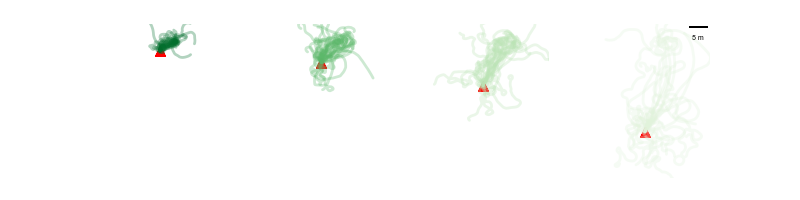

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f4503556090>,
      dtype=object)

In [85]:
treeFig(dfl,'tree_dist',naked=True,treeDistPal=['#036F2E', '#5CB86A', '#BBE4B5','#E1F3DB'],lw=0.75)

<IPython.core.display.Javascript object>


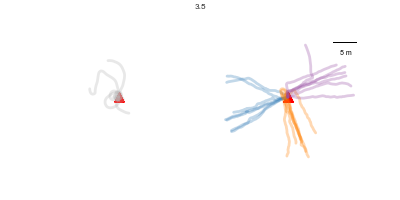

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f4536911d50>,
      dtype=object)

In [58]:
treeFig(dfl, 'wind',naked=True,lw=0.75)

<IPython.core.display.Javascript object>


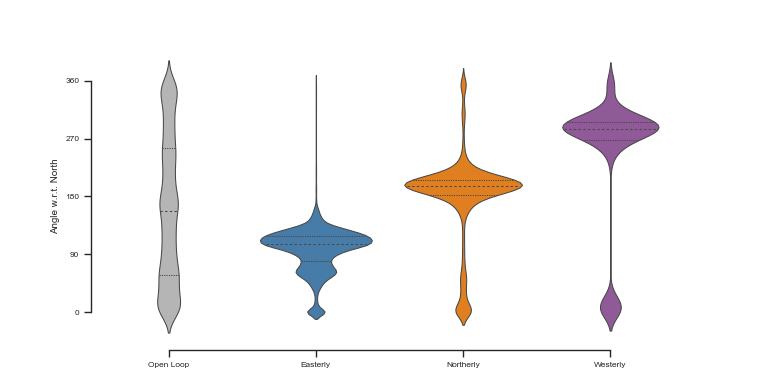

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:226: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [63]:
treeFig(dfl, 'vio_wind',despine=True,lw=0.75)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:245: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


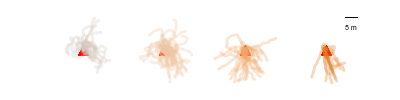

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f4549e1be90>,
      dtype=object)

In [74]:
treeFig(dfl, 'wind_speed',naked=True,lw=0.75)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:284: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:285: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


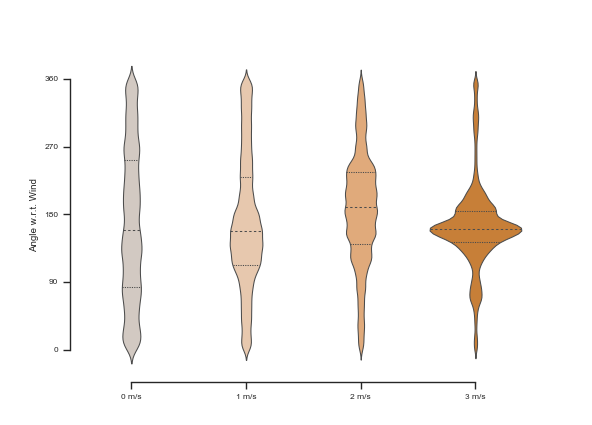

In [67]:
treeFig(dfl, 'vio_wind_speed',despine=True,lw=0.75)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:282: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:283: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


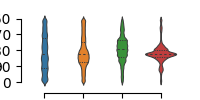

In [33]:
treeFig(dfl, 'vio_wind_speed',despine=True,lw=0.75)

In [15]:
df,param,pat=h5load('/home/rhagoletis/catkin/src/analyseWorld/ipy_notebooks/all_wind.h5')
df.windPressure=df.windPressure.astype(float)

In [24]:
dfw_.windCut.unique()

[(-0.1, 0.5], (0.5, 1.5], (1.5, 2.5], (2.5, 3.5]]
Categories (4, interval[float64]): [(-0.1, 0.5] < (0.5, 1.5] < (1.5, 2.5] < (2.5, 3.5]]

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


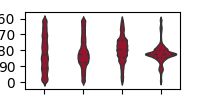

Text(0.5,0,'')

In [31]:
speedBin=(-.1,0.5,1.5,2.5,3.5)
lw=1
dfw_=df[(df.flowSource=='direct')&(df.visual=='grassSky')]
dfw_['windCut']=pd.cut(df.windPressure,speedBin)
dfw_['servo']=(dfw_.trajectory__servoAngle+90)%360

plt.figure(figsize=(2,1))
ax=sns.violinplot(x='windCut',y='servo',data=dfw_[(dfw_.trajectory__speed>0)&(dfw_.trajectory__case>0)],
                  inner='quartile',linewidth=lw,palette=['#AA0022','#AA0022','#AA0022','#AA0022'])

ax.yaxis.set_major_locator(ticker.MultipleLocator(90))
ax.yaxis.set_major_formatter(ticker.ScalarFormatter())
ax.set_xticklabels(['0 m/s','1 m/s','2 m/s','3 m/s'])

# Make a dictionary with one specific color per group:
# my_pal = {"versicolor": "g", "setosa": "b", "virginica":"m"}
 
# #plot it
# sns.violinplot( x=df["species"], y=df["sepal_length"], palette=my_pal) 

#             ax.set_xticklabels(['Wind','Wind + Odour'])
plt.ylabel('Angle w.r.t. Wind')
#             plt.xlabel('Wind Speed (m/s)')
plt.xlabel('')


<IPython.core.display.Javascript object>


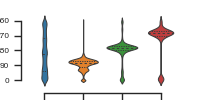

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:224: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [165]:
treeFig(dfl, 'vio_wind',despine=True,lw=0.75)

In [139]:
pubFigStyle()

<IPython.core.display.Javascript object>


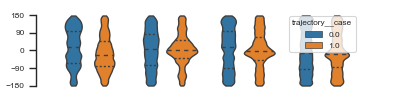

In [140]:
treeFig(dfl, 'vio_tree_dist',despine=True,lw=0.75)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>


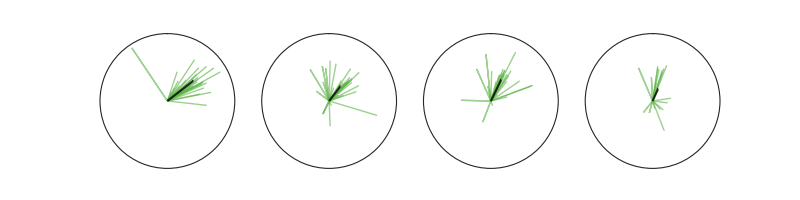

-51.96092503406495 0.48355611403187015 (0.001, 2.785409211558176) 9.549865639903062e-11 

-37.16970889013074 0.2736177100932344 (0.001, 3.0012133234325944) 9.793799677674146e-07 

-25.929262556597124 0.34864067735049065 (0.001, 2.694293942913075) 1.0867232525386972e-07 

-24.51063582897572 0.19661178923398523 (0.001, 2.294150072604171) 0.045834077087736874 



array([<matplotlib.axes._subplots.PolarAxesSubplot object at 0x7fda9d3e6b90>,
      dtype=object)

In [119]:
treeFig(dfl,'tree_dist_polar')

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:249: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:250: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>


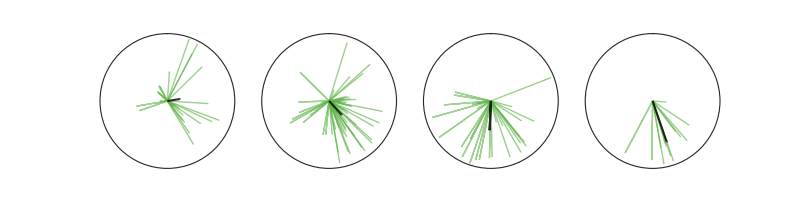

-80.97079889585343 0.19040711709247884 (0.001, 2.5515231154618863) 0.23577551650951387 

-137.70850736433155 0.27809702895699506 (0.001, 3.775488967356422) 2.0452007634786613e-08 

177.51381564436468 0.4331322303401905 (0.001, 2.785404224840047) 1.0898692483101641e-05 

-160.97304303498467 0.633089901814046 (0.001, 2.0044434725473) 9.442259850647066e-07 



array([<matplotlib.axes._subplots.PolarAxesSubplot object at 0x7fda4454dad0>,
      dtype=object)

In [128]:
treeFig([],'wind_speed_polar')

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:198: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>


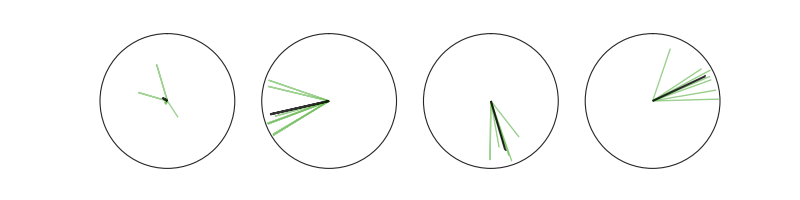

56.36281671789204 0.08476350308722053 (0.001, 1.5909830067071147) 0.18547582377037025 

102.76090107380425 0.8918989163332735 (0.001, 1.511857450413253) 0.00010965256844077042 

-163.65929757973998 0.755820522211045 (0.001, 1.5118551401272327) -7.501076613340173e-05 

-64.82282693427653 0.8618952797473649 (0.001, 1.5118571099835985) 0.00019952879306492835 



array([<matplotlib.axes._subplots.PolarAxesSubplot object at 0x7fda4437aa50>,
      dtype=object)

In [123]:
treeFig([],'wind_polar')

<IPython.core.display.Javascript object>


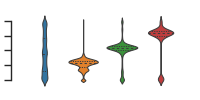

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:224: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:281: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:282: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


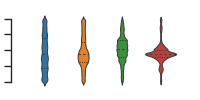

In [156]:
treeFig(dfl, 'vio_wind_speed',despine=True,lw=0.75)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>


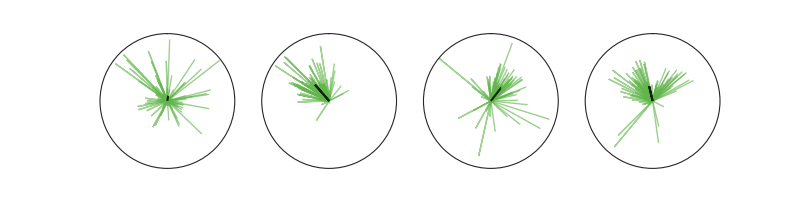

-7.986956359317052 0.07414546526839681 (0.001, 4.8479147301842795) 0.24703267775819465 

40.96540008374263 0.3168937069587733 (0.001, 4.873641071754568) 7.165365666211199e-28 

-37.61913133258365 0.23826602254435747 (0.001, 4.873646493137903) 8.519705443072192e-21 

13.071958503019877 0.22420226667546286 (0.001, 4.847932328594734) 9.07585420778855e-17 



array([<matplotlib.axes._subplots.PolarAxesSubplot object at 0x7fda3b26b250>,
      dtype=object)

In [116]:
treeFig(dfl,'tree_polar')

In [103]:
def polarRowPlot(m,ax=None,i=0):
    '''
    m = dataframe with columns a and r in degrees of the mean angles and radius
    '''
    if ax is None:
        f,ax=plt.subplots(1,4,subplot_kw=dict(polar=True),figsize=(8,2))
        ax=ax.reshape(4,)
    ma,mr=getCircularMean(m.a,m.r)

    for the,rad in zip(np.deg2rad(m.a),m.r): 
        ax[i].arrow(0,0,the,rad,lw=1,color='#61b54b83',alpha=0.6)

#     ax[i].scatter(np.deg2rad(m.a),m.r,s=5,color='#61b54b83',alpha=0.5)
    ax[i].arrow(0,0,np.deg2rad(ma),mr,lw=1.5,alpha=0.8,color='k')# shape='full',

    ax[i].set_ylim(0,1)
    ax[i].set_theta_offset(np.pi/2)
    ax[i].set_rticks([])  # Less radial ticks
    ax[i].set_rmax(1)
    ax[i].set_thetagrids([] )

    print ma, mr , mooreTest(m[['a','r']]), rayleightest(np.deg2rad(m.a)) ,'\n'

<IPython.core.display.Javascript object>


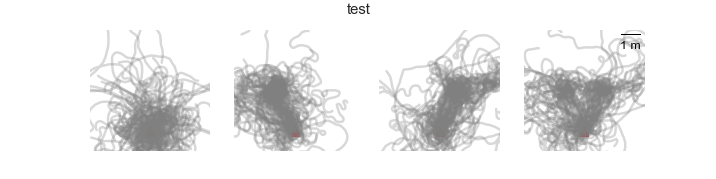

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fda2374f6d0>,
      dtype=object)

In [18]:
treeFig(dfl, 'tree',despine=True,naked =True)

<IPython.core.display.Javascript object>


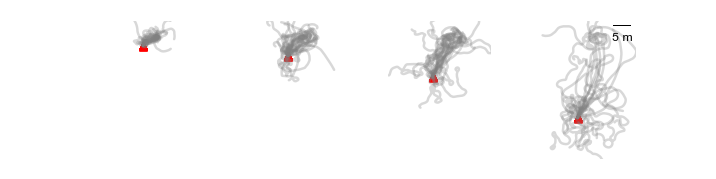

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fdae378f4d0>,
      dtype=object)

In [19]:
treeFig(dfl, 'tree_dist',despine=True,naked =True)

<IPython.core.display.Javascript object>


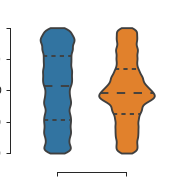

In [24]:
treeFig(dfl, 'vio_tree',despine=True,)

<IPython.core.display.Javascript object>


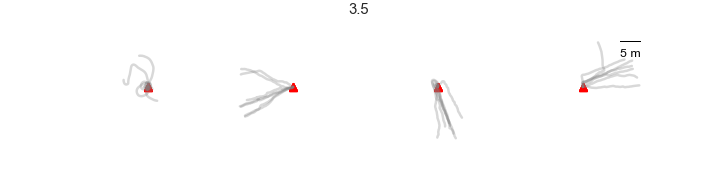

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fda2e0f48d0>,
      dtype=object)

In [25]:
treeFig(dfl, 'wind',despine=True,naked =True)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:282: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


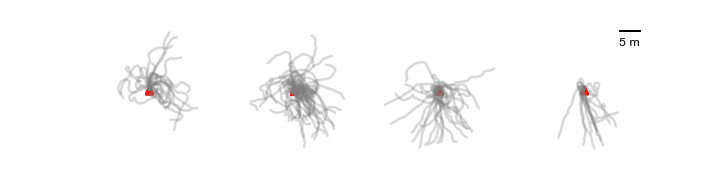

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fda4a866950>,
      dtype=object)

In [26]:
treeFig(dfl, 'wind_speed',despine=True,naked =True)

<IPython.core.display.Javascript object>


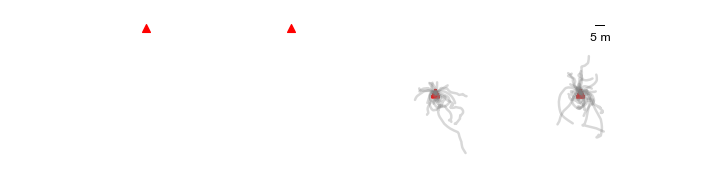

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


no params, error in auto start find, ressetting to defaukt
no params, error in auto start find, ressetting to defaukt


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fda2e59aed0>,
      dtype=object)

In [37]:
treeFig(dfv, 'vada',despine=True,naked =True)

<IPython.core.display.Javascript object>


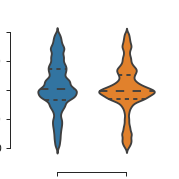

In [36]:
treeFig(dfv, 'vio_vada',despine=True)

In [ ]:

    
    '''figtypes :
    tree = raw traj of a particular dist for diff quads
    tree_dist = raw traj of particular quad for diff dists
    vio_tree = violin plot for a particular dist
    vio_tree_dist = violin plots for different dist bins
    
    wind = raw traj plots of particular speed and diff quads
    wind_speed = raw traj of particular direction and different velocities
    vio_wind_speed = violing plots of particular direction and difference velocities
    
    vada =  raw trajectory of wind and wind+odour 
    vio_vada =  violin plots of wind and wind+odour
    
    '''

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


 wonky file


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>


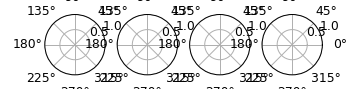

AttributeError: 'DataFrame' object has no attribute 'case'

In [92]:
dfw=df[(df.flowSource=='direct')&(df.visual=='grassSky')&(df.windPressure==3.5)]
dfw['servo']=(dfw.trajectory__pOri_x)%360
dfw_=meanOfMeaner(addBoutFrame(dfw))

def _meaner(d):
    return getCircularMean(d.a,d.r)
f,ax=plt.subplots(1,4,subplot_kw=dict(polar=True),figsize=(4,1))
ax=ax.reshape(4,)

for i in range(4):
    m=dfw_[(dfw_.case==i)]
#                 aggregIndi = 0
#                 if aggregIndi:
#                     m2=m.groupby(['fileStamp']).mean()
#                     _m=m.groupby(['fileStamp']).apply(_meaner).apply(pd.Series)
#                     m2['a'],m2['r']=_m[0],_m[1]
#                     m=m2

    ma,mr=getCircularMean(m.a,m.r)

    ax[i].scatter(np.deg2rad(m.a),m.r,s=2,color='#61b54b83',alpha=0.4)
    ax[i].arrow(0,0,np.deg2rad(ma),mr,lw=2,alpha=1,color='k')# shape='full',

    ax[i].set_ylim(0,1)
    ax[i].set_theta_offset(np.pi/2)
    ax[i].set_rticks([])  # Less radial ticks
    ax[i].set_rmax(1)
    ax[i].set_thetagrids([] )

    print ma, mr , mooreTest(m[['a','r']]), rayleightest(np.deg2rad(m.a)) ,'\n'

<IPython.core.display.Javascript object>


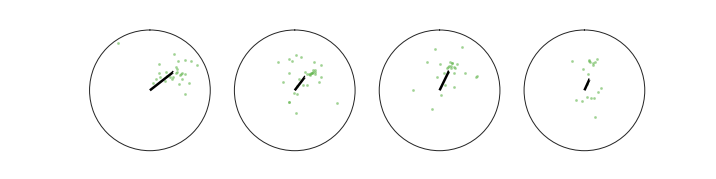

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in divide


-51.96092503406495 0.48355611403187015 (0.001, 2.785409211558176) 9.549865639903062e-11 

-37.16970889013074 0.2736177100932344 (0.001, 3.0012133234325944) 9.793799677674146e-07 

-25.929262556597124 0.34864067735049065 (0.001, 2.694293942913075) 1.0867232525386972e-07 

-24.51063582897572 0.19661178923398523 (0.001, 2.294150072604171) 0.045834077087736874 



array([<matplotlib.axes._subplots.PolarAxesSubplot object at 0x7fda4cbe7fd0>,
      dtype=object)

In [38]:
treeFig(dfl,'tree_dist_polar')

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>


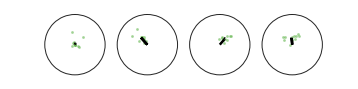

-17.83414190375736 0.062390839801342766 (0.001, 1.8090633729167012) 0.6338721614373068 

42.54655722724811 0.30652098790437665 (0.001, 1.8090612314989165) -4.693711269804381e-07 

-40.44863839319453 0.2633423171765267 (0.001, 1.8090659350091485) -2.654475638692488e-06 

4.69288646396223 0.22450949967505618 (0.001, 1.8090646082521546) 0.0008850500037700334 



In [40]:

moms=[]#mean of each trajectory run list
for i,df in enumerate(dfl):
    mom=meanOfMeaner(df,posLang=False)
    mom['fileStamp']=pl[i]['bagFileName'].split('/')[-1][:20]
    moms.append(mom)

#mean dataframe, every quad, every run, every individual, mean angle of heading, if poslang, angle w.r.t. 
mdf=pd.concat(moms,ignore_index=True)

#filter out runs with intermittent cuts/resets , take top 10 most frequent 
mdf2=mdf[mdf['dur'].isin(mdf.dur.value_counts().iloc[:10].index)]


filt=[] #list of paths to be filtered away
for i, p in enumerate(pl):
    if (1 and p['playerInitPos'][0]==513) and (p['playerInitPos'][1]==513) and\
    (p['loadingString']=='01') and (p['posL'][0]==510) and (p['posL'][1]==516):
        filt.append(p['bagFileName'].split('/')[-1][:20])

def _meaner(d):
    return getCircularMean(d.a,d.r)

f,ax=plt.subplots(1,4,subplot_kw=dict(polar=True),figsize=(4,1))
ax=ax.reshape(4,)
for i in range(4):

    m=mdf2[(mdf2.case==i)&(mdf2.fileStamp.isin(filt))]

    aggregIndi = 1
    if aggregIndi:
        m2=m.groupby(['fileStamp']).mean()
        _m=m.groupby(['fileStamp']).apply(_meaner).apply(pd.Series)
        m2['a'],m2['r']=_m[0],_m[1]
        m=m2

    ma,mr=getCircularMean(m.a,m.r)


    ax[i].scatter(np.deg2rad(m.a),m.r,s=2,color='#61b54b83',alpha=0.4)
    ax[i].arrow(0,0,np.deg2rad(ma),mr,lw=2,alpha=1,color='k')# shape='full',

    ax[i].set_ylim(0,1)
    ax[i].set_theta_offset(np.pi/2)
    ax[i].set_rticks([])  # Less radial ticks
    ax[i].set_rmax(1)
    ax[i].set_thetagrids([] )

    print ma, mr , mooreTest(m[['a','r']]), rayleightest(np.deg2rad(m.a)) ,'\n'





/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>


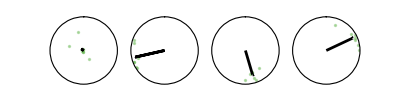

56.36281671789204 0.08476350308722053 (0.001, 1.5909830067071147) 0.18547582377037025 

102.76090107380425 0.8918989163332735 (0.001, 1.511857450413253) 0.00010965256844077042 

-163.65929757973998 0.755820522211045 (0.001, 1.5118551401272327) -7.501076613340173e-05 

-64.82282693427653 0.8618952797473649 (0.001, 1.5118571099835985) 0.00019952879306492835 



In [17]:
df,param,pat=h5load('/home/rhagoletis/catkin/src/analyseWorld/ipy_notebooks/all_wind.h5')
df.windPressure=df.windPressure.astype(float)

dfw_=df[(df.flowSource=='direct')&(df.visual=='grassSky')&(df.windPressure==3.5)]
#             dfw_['servo']=(dfw_.trajectory__servoAngle+90)%360
dfw_['servo']=(dfw_.trajectory__pOri_x)%360
dfw_=meanOfMeaner(addBoutFrame(dfw_))

def _meaner(d):
    return getCircularMean(d.a,d.r)

mdf2=dfw_
f,ax=plt.subplots(1,4,subplot_kw=dict(polar=True),figsize=(4,1))
ax=ax.reshape(4,)
for i in range(4):

    m=mdf2[(mdf2.case==i)]

    aggregIndi = 0
    if aggregIndi:
        m2=m.groupby(['fileStamp']).mean()
        _m=m.groupby(['fileStamp']).apply(_meaner).apply(pd.Series)
        m2['a'],m2['r']=_m[0],_m[1]
        m=m2

    ma,mr=getCircularMean(m.a,m.r)


    ax[i].scatter(np.deg2rad(m.a),m.r,s=2,color='#61b54b83',alpha=0.4)
    ax[i].arrow(0,0,np.deg2rad(ma),mr,lw=2,alpha=1,color='k')# shape='full',

    ax[i].set_ylim(0,1)
    ax[i].set_theta_offset(np.pi/2)
    ax[i].set_rticks([])  # Less radial ticks
    ax[i].set_rmax(1)
    ax[i].set_thetagrids([] )

    print ma, mr , mooreTest(m[['a','r']]), rayleightest(np.deg2rad(m.a)) ,'\n'

<IPython.core.display.Javascript object>


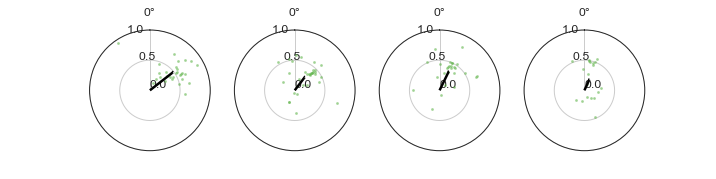

-51.96092503406495 0.48355611403187015 (0.001, 2.785409211558176) 9.549865639903062e-11 

-37.16970889013074 0.2736177100932344 (0.001, 3.0012133234325944) 9.793799677674146e-07 

-25.929262556597124 0.34864067735049065 (0.001, 2.694293942913075) 1.0867232525386972e-07 

-24.51063582897572 0.19661178923398523 (0.001, 2.294150072604171) 0.045834077087736874 



In [41]:
#dist polardist

f,ax=plt.subplots(1,4,subplot_kw=dict(polar=True),figsize=(8,2))
ax=ax.reshape(4,)

for j,ip in enumerate(dist):
    filt=[]
    for i, df in enumerate(dfl):
        if (pl[i]['playerInitPos'][0]==ip[0]) and (pl[i]['playerInitPos'][1]==ip[1]) \
            and(pl[i]['posL'][0]==519)and(pl[i]['posL'][1]==516):
            fil=(pl[i]['bagFileName'].split('/')[-1][:20])
            filt.append(fil)

    m=mdf2[(mdf2.case==1)&(mdf2.fileStamp.isin(filt))]

    aggregIndi = 0
    if aggregIndi:
        m2=m.groupby(['fileStamp']).mean()
        _m=m.groupby(['fileStamp']).apply(_meaner).apply(pd.Series)
        m2['a'],m2['r']=_m[0],_m[1]
        m=m2

    ma,mr=getCircularMean(m.a,m.r)


    ax[j].scatter(np.deg2rad(m.a),m.r,s=2,color='#61b54b83',alpha=0.4)
    ax[j].arrow(0,0,np.deg2rad(ma),mr,lw=2,alpha=1,color='k')# shape='full',

    ax[j].set_ylim(0,1)
    ax[j].set_theta_offset(np.pi/2)
    ax[j].set_rticks([0,0.5,1])  # Less radial ticks
    ax[j].set_rmax(1)
    ax[j].set_thetagrids([0] )

    print ma, mr , mooreTest(m[['a','r']]), rayleightest(np.deg2rad(m.a)) ,'\n'




In [43]:
#         bins=np.linspace(0,20,8)
bins=[2,4,8,16,32]
dfl_=[]

for i, df in enumerate(dfl[:]):
    for j,ip in enumerate(dist):
        if (pl[i]['playerInitPos'][0]==ip[0]) and (pl[i]['playerInitPos'][1]==ip[1]) \
            and(pl[i]['posL'][0]==519)and(pl[i]['posL'][1]==516):

            parameters=pl[i]
            dfl_.append(df)


df=pd.concat(dfl_)


plt.figure(figsize=(4,2))
#             ax=sns.violinplot(x="trajectory__case", y="posLang", data=df[df.trajectory__case<2],inner="quartile",
#                            cut=0,hue='posLdistBin',scale_hue=False)#,scale='count')
ax=sns.violinplot( y="posLang", data=df[df.trajectory__case<2],inner="quartile",
               cut=0,x='posLdistBin',scale_hue=False, hue='trajectory__case')#,scale='count')

#             ax.set_xticklabels(['No tree','Tree'])
plt.ylabel('Angle w.r.t. Tree')
plt.xlabel('')


<IPython.core.display.Javascript object>

ValueError: Could not interpret input 'posLdistBin'

In [375]:
df

,trajectory__case,posRang,posLang,posRdist,posLdist,trajectory__runNum,fileStamp,frame,posLdistBin,posRdistBin
2018-03-30 06:30:00.255325184,0.0,-64.867492,62.094765,6.705613,6.705395,1.0,2018-03-30__11~59~56,165.0,"(4, 8]","(4, 8]"
2018-03-30 06:30:00.261300992,0.0,-65.340836,61.713855,6.703081,6.702535,1.0,2018-03-30__11~59~56,166.0,"(4, 8]","(4, 8]"
2018-03-30 06:30:00.267499008,0.0,-65.494393,61.652806,6.700554,6.699679,1.0,2018-03-30__11~59~56,167.0,"(4, 8]","(4, 8]"
2018-03-30 06:30:00.273676032,0.0,-65.541378,61.698403,6.698031,6.696828,1.0,2018-03-30__11~59~56,168.0,"(4, 8]","(4, 8]"
2018-03-30 06:30:00.285448960,0.0,-65.588398,61.744039,6.695513,6.693981,1.0,2018-03-30__11~59~56,169.0,"(4, 8]","(4, 8]"
2018-03-30 06:30:00.291554816,0.0,-65.742293,61.682875,6.693054,6.691084,1.0,2018-03-30__11~59~56,170.0,"(4, 8]","(4, 8]"
2018-03-30 06:30:00.299181056,0.0,-65.789614,61.728358,6.690599,6.688191,1.0,2018-03-30__11~59~56,171.0,"(4, 8]","(4, 8]"
2018-03-30 06:30:00.305306880,0.0,-65.943578,61.667273,6.688149,6.685302,1.0,2018-03-30__11~59~56,172.0,"(4, 8]","(4, 8]"
2018-03-30 06:30:00.311401984,0.0,-66.097577,61.606227,6.685704,6.682417,1.0,2018-03-30__11~59~56,173.0,"(4, 8]","(4, 8]"
2018-03-30 06:30:00.319287040,0.0,-65.291682,62.505148,6.683154,6.679646,1.0,2018-03-30__11~59~56,174.0,"(4, 8]","(4, 8]"


In [207]:
filt=[]
for i, p in enumerate(pl):
    if (1 and p['playerInitPos'][0]==513) and (p['playerInitPos'][1]==513) and\
    (p['loadingString']=='01') and (p['posL'][0]==510) and (p['posL'][1]==516):
        filt.append(p['bagFileName'].split('/')[-1][:20])
        
        


<IPython.core.display.Javascript object>


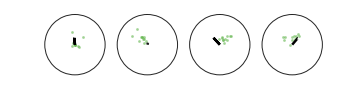

-17.83414190375736 0.062390839801342766 (0.001, 1.8090633729167012) 0.6338721614373068 

42.54655722724811 0.30652098790437665 (0.001, 1.8090612314989165) -4.693711269804381e-07 

-40.44863839319453 0.2633423171765267 (0.001, 1.8090659350091485) -2.654475638692488e-06 

4.69288646396223 0.22450949967505618 (0.001, 1.8090646082521546) 0.0008850500037700334 



In [299]:
def _meaner(d):
    return getCircularMean(d.a,d.r)

f,ax=plt.subplots(1,4,subplot_kw=dict(polar=True),figsize=(4,1))
ax=ax.reshape(4,)
for i in range(4):
 
    m=mdf2[(mdf2.case==i)&(mdf2.fileStamp.isin(filt))]
    
    aggregIndi = 1
    if aggregIndi:
        m2=m.groupby(['fileStamp']).mean()
        _m=m.groupby(['fileStamp']).apply(_meaner).apply(pd.Series)
        m2['a'],m2['r']=_m[0],_m[1]
        m=m2

    ax[i].scatter(np.deg2rad(m.a),m.r,s=2,color='#61b54b83',alpha=0.4)
    ax[i].arrow(0,0,np.deg2rad(ma),mr,lw=2,alpha=1,color='k')# shape='full',

    ax[i].set_ylim(0,1)
    ax[i].set_theta_offset(np.pi/2)
    ax[i].set_rticks([])  # Less radial ticks
    ax[i].set_rmax(1)
    ax[i].set_thetagrids([] )

    ma,mr=getCircularMean(m.a,m.r)
    print ma, mr , mooreTest(m[['a','r']]),rayleightest(np.deg2rad(m.a)),'\n'
    



<IPython.core.display.Javascript object>


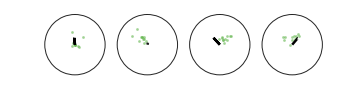

-17.83414190375736 0.062390839801342766 (0.001, 1.8090633729167012) 

42.54655722724811 0.30652098790437665 (0.001, 1.8090612314989165) 

-40.44863839319453 0.2633423171765267 (0.001, 1.8090659350091485) 

4.69288646396223 0.22450949967505618 (0.001, 1.8090646082521546) 



In [288]:
def _meaner(d):
    return getCircularMean(d.a,d.r)

f,ax=plt.subplots(1,4,subplot_kw=dict(polar=True),figsize=(4,1))
ax=ax.reshape(4,)
for i in range(4):
 
    m=mdf2[(mdf2.case==i)&(mdf2.fileStamp.isin(filt))]
    
    aggregIndi = 1
    if aggregIndi:
        m2=m.groupby(['fileStamp']).mean()
        _m=m.groupby(['fileStamp']).apply(_meaner).apply(pd.Series)
        m2['a'],m2['r']=_m[0],_m[1]
        m=m2

    ax[i].scatter(np.deg2rad(m.a),m.r,s=2,color='#61b54b83',alpha=0.4)
    ax[i].arrow(0,0,np.deg2rad(ma),mr,lw=2,alpha=1,color='k')# shape='full',

    ax[i].set_ylim(0,1)
    ax[i].set_theta_offset(np.pi/2)
    ax[i].set_rticks([])  # Less radial ticks
    ax[i].set_rmax(1)
    ax[i].set_thetagrids([] )

    ma,mr=getCircularMean(m.a,m.r)
    print ma, mr , mooreTest(m[['a','r']]),'\n'
    



In [284]:
plt.savefig('tst.svg')

<IPython.core.display.Javascript object>


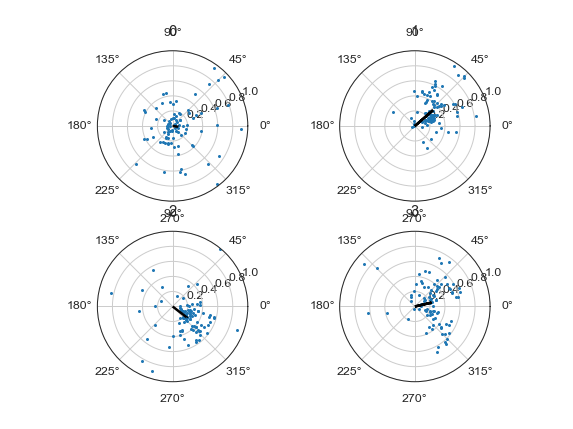

-7.986956359317052 0.07414546526839681 (0.001, 4.8479147301842795) 

40.96540008374263 0.3168937069587733 (0.001, 4.873641071754568) 

-37.61913133258365 0.23826602254435747 (0.001, 4.873646493137903) 

13.071958503019877 0.22420226667546286 (0.001, 4.847932328594734) 



In [260]:
# for i in [0]:
f,ax=plt.subplots(2,2,subplot_kw=dict(polar=True))
ax=ax.reshape(4,)
for i in range(4):
 
    m=mdf2[(mdf2.case==i)&(mdf2.fileStamp.isin(filt))]
    m2=m.groupby(['fileStamp']).mean()
    _m=m.groupby(['fileStamp']).apply(test).apply(pd.Series)
    m2['a'],m2['r']=_m[0],_m[1]



#     ma,mr=getCircularMean(m2.a,m2.r)
#     print ma, mr , 
#     print mooreTest(m[['a','r']]),'\n'

#     ax[i].scatter(np.deg2rad(m2.a),m2.r)
#     ax[i].arrow(0,0,np.deg2rad(ma),mr,lw=2,alpha=1,color='k')# shape='full',

#     ax[i].set_title(i)
#     ax[i].set_ylim(0,1)


    ma,mr=getCircularMean(m.a,m.r)
    print ma, mr , 
    print mooreTest(m[['a','r']]),'\n'

    ax[i].scatter(np.deg2rad(m.a),m.r,s=2)
    ax[i].arrow(0,0,np.deg2rad(ma),mr,lw=2,alpha=1,color='k')# shape='full',

    ax[i].set_title(i)
    ax[i].set_ylim(0,1)
##     plt.figure()
##     m.r.hist(bins=15)

In [211]:
mr

0.22420226667546286

<IPython.core.display.Javascript object>


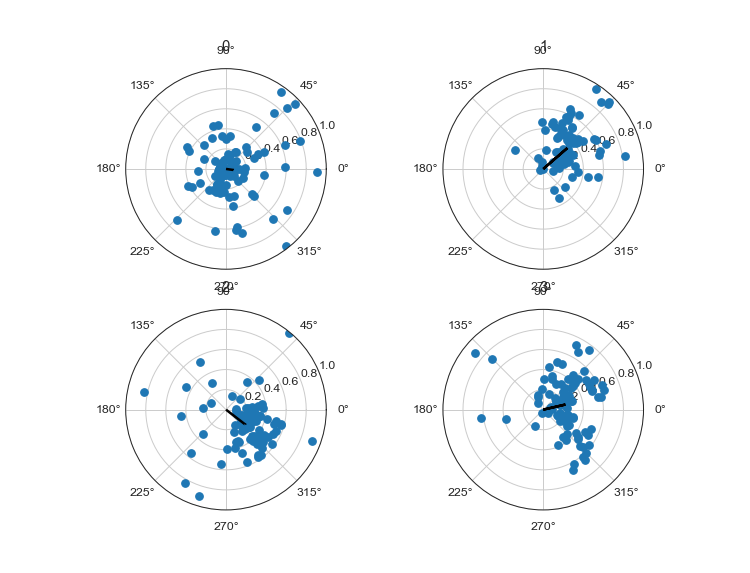

In [216]:
f,ax=plt.subplots(2,2,subplot_kw=dict(polar=True))
ax=ax.reshape(4,)

In [121]:
# for i in [0]:
for i in range(4):
# 
    m=mdf2[(mdf2.case==i)&(mdf2.fileStamp.isin(filt))]
    ma,mr=getCircularMean(m.a,m.r)
    print ma, mr , 
    print mooreTest(m[['a','r']]),'\n'

    ax[i].scatter(np.deg2rad(m.a),m.r)
    ax[i].arrow(0,0,np.deg2rad(ma),mr,lw=2,alpha=1,color='k')# shape='full',

    ax[i].set_title(i)
    ax[i].set_ylim(0,1)
#     plt.figure()
#     m.r.hist(bins=15)

-5.81678676128496 0.45146319192349355 (0.001, 3.6062096901879075) 

11.356259292698967 0.8408662605493725 (0.001, 3.5714131918784076) 

-25.50926170398558 0.624901189407753 (0.001, 3.536248906888504) 

-0.2882546574925814 0.7234016310351448 (0.001, 3.5362534635395804) 



In [111]:
# for i in [0]:
for i in range(4):
# 
    m=mdf2[(mdf2.case==i)&(mdf2.fileStamp.isin(filt))]
    ma,mr=getCircularMean(m.a,m.r)
    print mooreTest(m[['a','r']]),
    ax[i].scatter(np.deg2rad(m.a),m.r)
    ax[i].arrow(0,0,np.deg2rad(ma),mr,lw=2,alpha=1,color='k')# shape='full',

    ax[i].set_title(i)
    ax[i].set_ylim(0,1)
#     plt.figure()
#     m.r.hist(bins=15)

(0.001, 3.6062096901879075) (0.001, 3.5714131918784076) (0.001, 3.536248906888504) (0.001, 3.5362534635395804)


In [96]:
m.a

382      74.044299
388      -6.629649
391      19.257141
908      16.767941
912     -21.341888
916     -29.421248
920     -73.848058
924     -44.817980
928     -22.296637
932      21.897323
936     -19.706189
940     -30.644438
944     -15.039259
948       5.141049
952       8.266378
1050      2.739132
1054    -24.214079
1058     11.039056
1062     13.096151
1066     16.676407
1070     -7.459424
1074     14.081375
1078     27.422989
1082    -72.068414
1086   -119.383668
1090     14.856050
1216     45.680451
1220     43.765499
1789      4.825143
1793    -12.112695
1797     -6.292571
1801     13.181632
1805     31.227850
1848     83.655450
1852    -23.171927
1856      8.610804
1860      8.597441
1864      5.622253
1869      0.167742
1873    112.289374
1877     -5.011271
1881    -24.233042
1885    -39.434564
1890     62.273768
1894    -59.487199
1898   -121.653974
1902     44.338169
1906   -170.110352
Name: a, dtype: float64

In [34]:
df

,trajectory__DCoffset,trajectory__boutFrame,trajectory__case,trajectory__caseU,trajectory__compensation,trajectory__gain,trajectory__groundSpeed,trajectory__headingControl,trajectory__impose,trajectory__imposeHeading,...,trajectory__speed,trajectory__speedControl,trajectory__trial,trajectory__valve1,trajectory__valve2,trajectory__valve3,trajectory__wbad,trajectory__wbas,posLang,posRang
2018-04-23 09:53:36.307187200,0.235,0.0,0.0,NaN,0.0,2.0,287.901334,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.005721,2.475465,-26.565051,26.565051
2018-04-23 09:53:36.312338176,0.235,0.0,0.0,NaN,0.0,2.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.005721,2.475465,-26.565051,26.565051
2018-04-23 09:53:36.317172992,0.235,0.0,0.0,NaN,0.0,2.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.005721,2.475465,-26.565051,26.565051
2018-04-23 09:53:36.323293952,0.235,0.0,0.0,NaN,0.0,2.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.005721,2.475465,-26.565051,26.565051
2018-04-23 09:53:36.329401088,0.235,0.0,0.0,NaN,0.0,2.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.005721,2.475465,-26.565051,26.565051
2018-04-23 09:53:36.335387904,0.235,0.0,0.0,NaN,0.0,2.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.005721,2.475465,-26.565051,26.565051
2018-04-23 09:53:36.341566208,0.235,0.0,0.0,NaN,0.0,2.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.007766,2.461978,-26.565051,26.565051
2018-04-23 09:53:36.347544064,0.235,0.0,0.0,NaN,0.0,2.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.007766,2.488952,-26.565051,26.565051
2018-04-23 09:53:36.353579008,0.235,0.0,0.0,NaN,0.0,2.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.007766,2.488952,-26.565051,26.565051
2018-04-23 09:53:36.359653888,0.235,0.0,0.0,NaN,0.0,2.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.005721,2.475465,-26.565051,26.565051


In [82]:
m.sort_values(['r'])

,run,case,a,r,dur,fileStamp
937,9.0,0.0,108.371184,0.048658,1651.0,2017-07-19__17~35~19
905,1.0,0.0,-76.818332,0.055424,1650.0,2017-07-19__17~35~19
945,11.0,0.0,28.484167,0.061632,1651.0,2017-07-19__17~35~19
917,4.0,0.0,115.731241,0.085730,1651.0,2017-07-19__17~35~19
913,3.0,0.0,114.892833,0.092941,1651.0,2017-07-19__17~35~19
949,12.0,0.0,-93.902738,0.101714,1651.0,2017-07-19__17~35~19
953,13.0,0.0,5.616455,0.122293,1651.0,2017-07-19__17~35~19
1051,2.0,0.0,-0.267392,0.130934,1651.0,2017-10-17__14~33~29
1866,1.0,0.0,-19.968285,0.156704,2475.0,2018-04-23__15~15~00
1857,4.0,0.0,-21.973132,0.156704,2476.0,2018-04-23__15~06~35


<IPython.core.display.Javascript object>


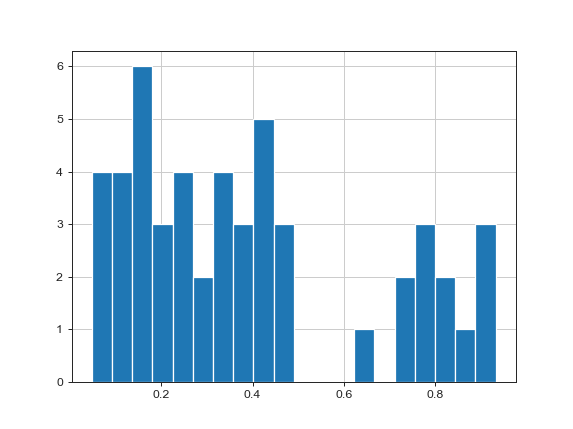

In [84]:
plt.figure()
m.r.hist(bins=20)

In [14]:
df=dfor[0]

In [33]:
dford2.head()

,trajectory__DCoffset,trajectory__boutFrame,trajectory__case,trajectory__caseU,trajectory__compensation,trajectory__gain,trajectory__groundSpeed,trajectory__headingControl,trajectory__impose,trajectory__imposeHeading,...,trajectory__slip,trajectory__speed,trajectory__speedControl,trajectory__trial,trajectory__valve1,trajectory__valve2,trajectory__valve3,trajectory__wbad,trajectory__wbas,frame
2018-09-18 08:46:34.612341760,0.189,0.0,0.0,0.0,0.0,8.0,185.888032,0.0,0.0,0.0,...,297.550718,0.0,0.0,1.0,0.0,0.0,0.0,-0.107904,1.755939,0.0
2018-09-18 08:46:34.616354816,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.107904,1.755939,1.0
2018-09-18 08:46:34.621726976,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.107904,1.787192,2.0
2018-09-18 08:46:34.627780864,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.076651,1.693433,3.0
2018-09-18 08:46:34.633863936,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.076651,1.693433,4.0


<IPython.core.display.Javascript object>


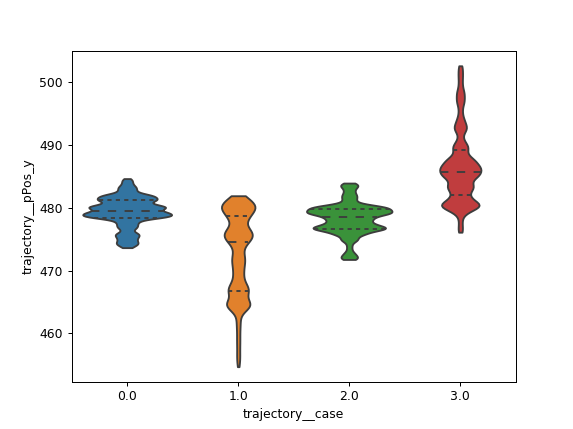

In [15]:
plt.figure()
sns.violinplot(x="trajectory__case", y="trajectory__pPos_y", data=df[df.trajectory__case<5],inner="quartile",
                              cut=0,scale_hue=False)#,scale='count')

<IPython.core.display.Javascript object>


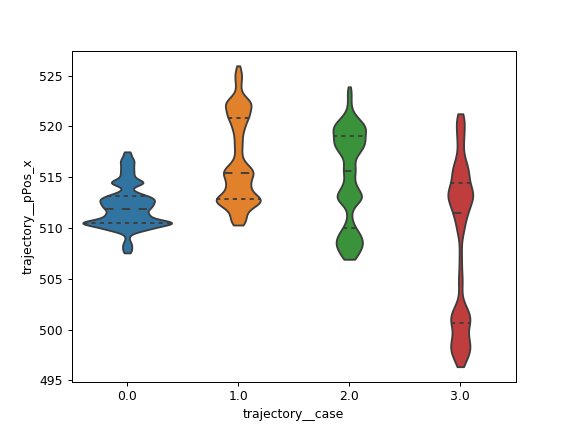

<IPython.core.display.Javascript object>


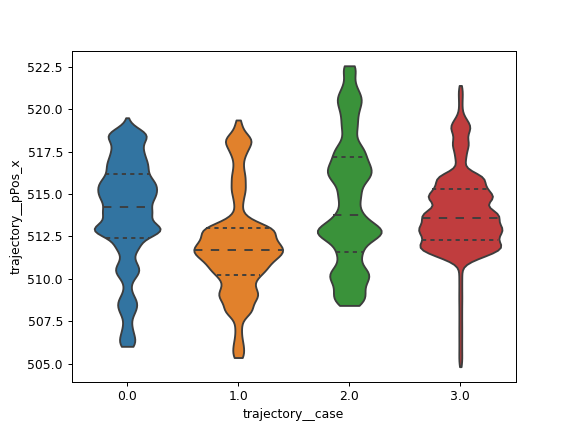

<IPython.core.display.Javascript object>


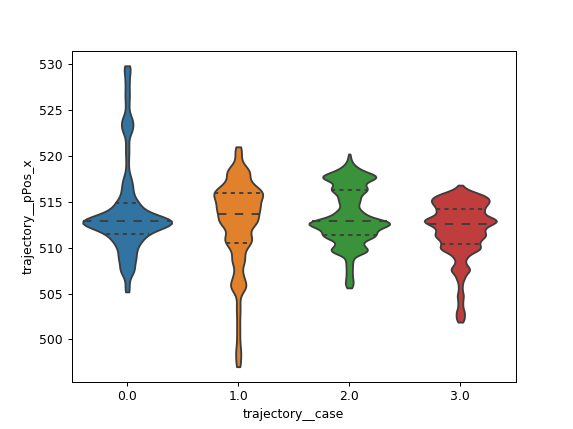

<IPython.core.display.Javascript object>


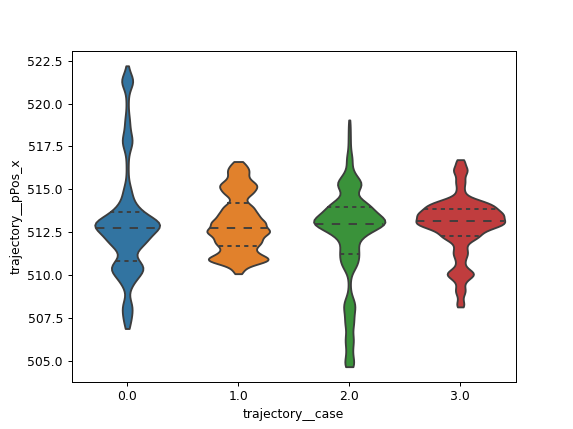

<IPython.core.display.Javascript object>


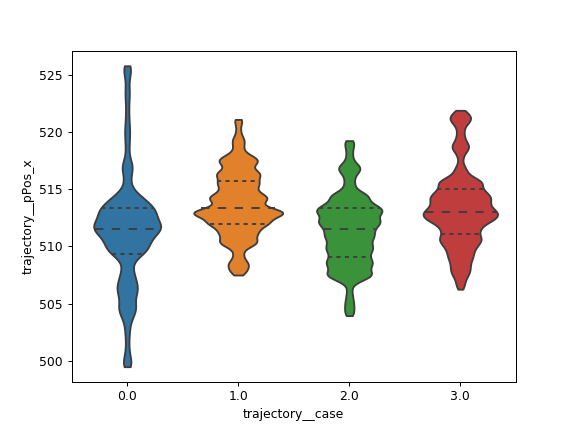

<IPython.core.display.Javascript object>


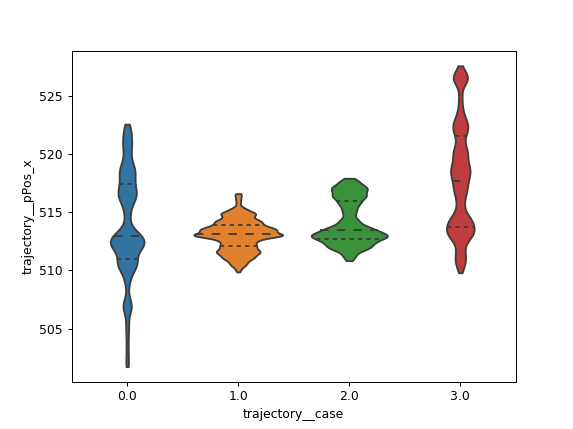

<IPython.core.display.Javascript object>


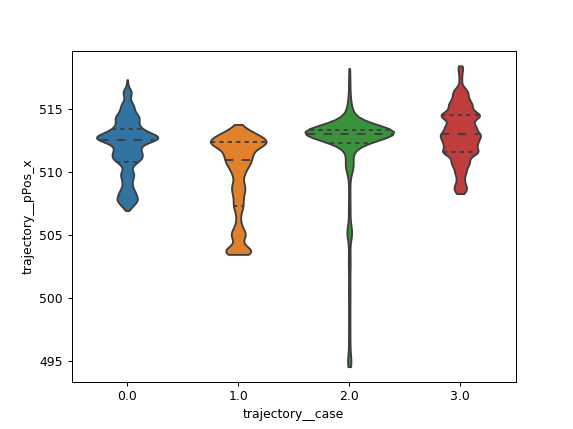

<IPython.core.display.Javascript object>


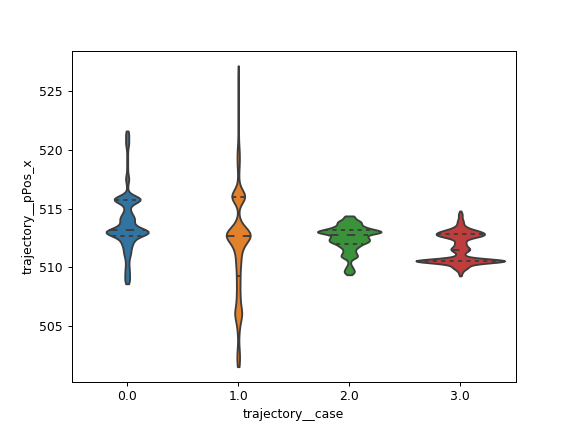

In [16]:
for df in dfor:
    plt.figure()
    sns.violinplot(x="trajectory__case", y="trajectory__pPos_x", data=df[df.trajectory__case<5],inner="quartile",
                              cut=0,scale_hue=False)#,scale='count')

<IPython.core.display.Javascript object>


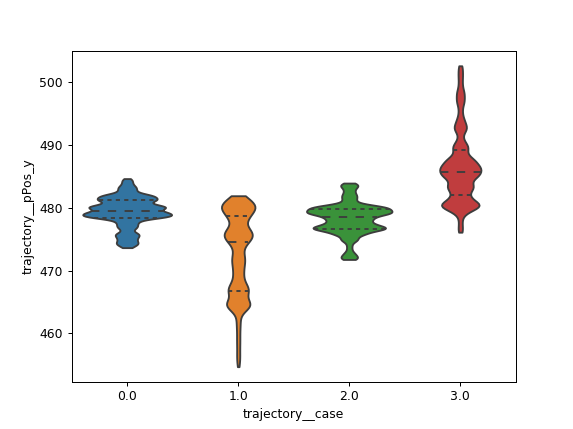

<IPython.core.display.Javascript object>


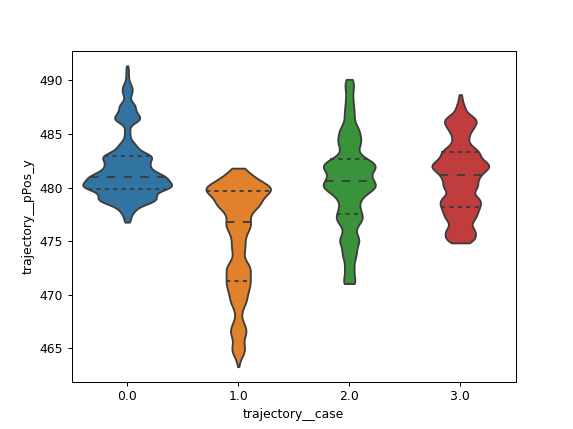

<IPython.core.display.Javascript object>


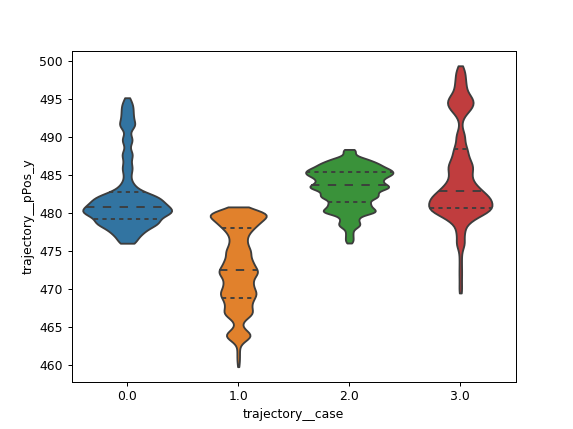

<IPython.core.display.Javascript object>


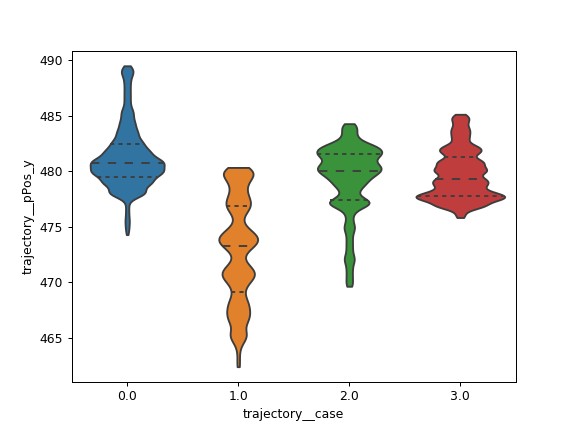

<IPython.core.display.Javascript object>


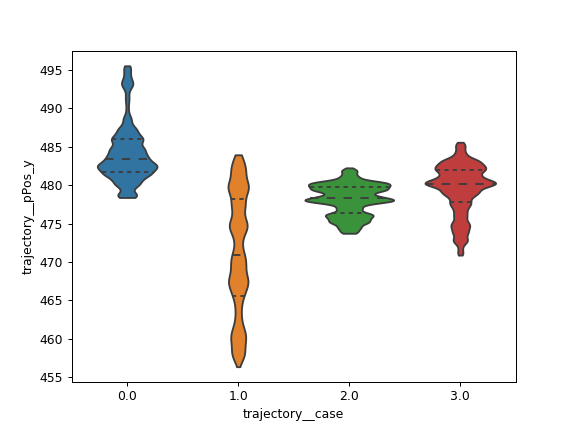

<IPython.core.display.Javascript object>


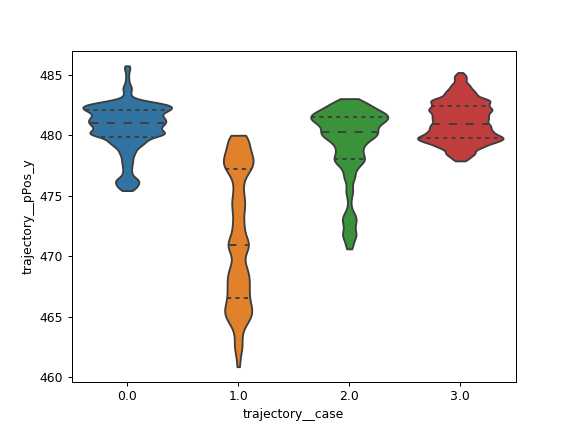

<IPython.core.display.Javascript object>


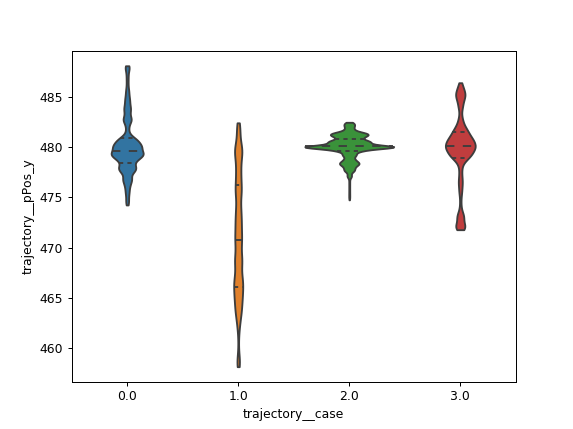

<IPython.core.display.Javascript object>


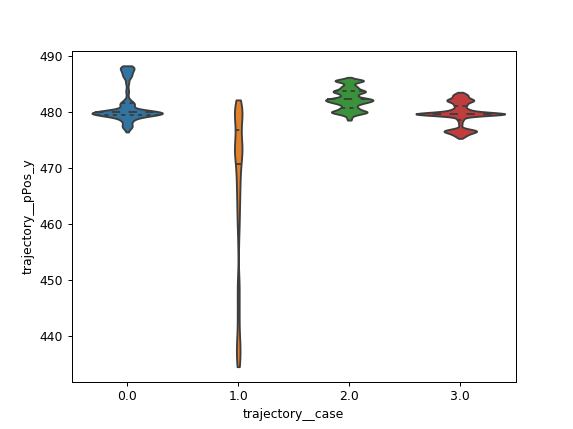

In [23]:
for df in dfor:
    plt.figure()
    sns.violinplot(x="trajectory__case", y="trajectory__pPos_y", data=df[df.trajectory__case<5],inner="quartile",
                              cut=0,scale_hue=False)#,scale='count')

In [32]:
dford2=pd.concat(dfl)


In [19]:
dford=pd.concat(dfor)


<IPython.core.display.Javascript object>


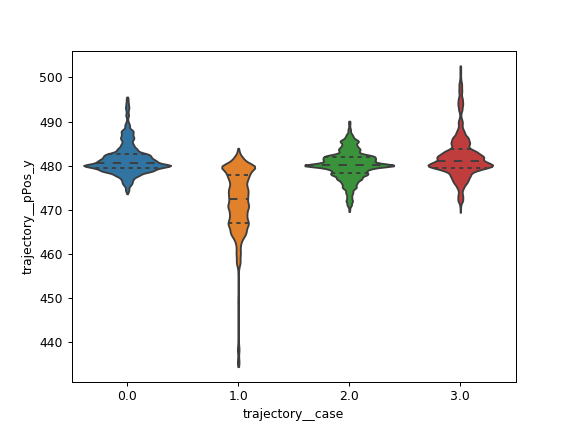

In [20]:
plt.figure()
sns.violinplot(x="trajectory__case", y="trajectory__pPos_y", data=dford,inner="quartile",
                              cut=0,scale_hue=False)#,scale='count')

In [35]:
dford2['modH']=(dford2['trajectory__pOri_x']+180)%360-180

In [27]:
dford['modH']=(dford['trajectory__pOri_x']+180)%360-180

In [44]:
dford2[(dford2['frame']<1650)]

,trajectory__DCoffset,trajectory__boutFrame,trajectory__case,trajectory__caseU,trajectory__compensation,trajectory__gain,trajectory__groundSpeed,trajectory__headingControl,trajectory__impose,trajectory__imposeHeading,...,trajectory__speed,trajectory__speedControl,trajectory__trial,trajectory__valve1,trajectory__valve2,trajectory__valve3,trajectory__wbad,trajectory__wbas,frame,modH
2018-09-18 08:46:34.612341760,0.189,0.0,0.0,0.0,0.0,8.0,185.888032,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.107904,1.755939,0.0,45.000000
2018-09-18 08:46:34.616354816,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.107904,1.755939,1.0,45.000000
2018-09-18 08:46:34.621726976,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.107904,1.787192,2.0,45.000000
2018-09-18 08:46:34.627780864,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.076651,1.693433,3.0,45.000000
2018-09-18 08:46:34.633863936,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.076651,1.693433,4.0,45.000000
2018-09-18 08:46:34.639909888,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.061024,1.709059,5.0,45.000000
2018-09-18 08:46:34.646094080,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.061024,1.709059,6.0,45.000000
2018-09-18 08:46:34.652329984,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.092277,1.709059,7.0,45.000000
2018-09-18 08:46:34.657831936,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.123530,1.740312,8.0,45.000000
2018-09-18 08:46:34.663806976,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,-0.123530,1.740312,9.0,45.000000


<IPython.core.display.Javascript object>


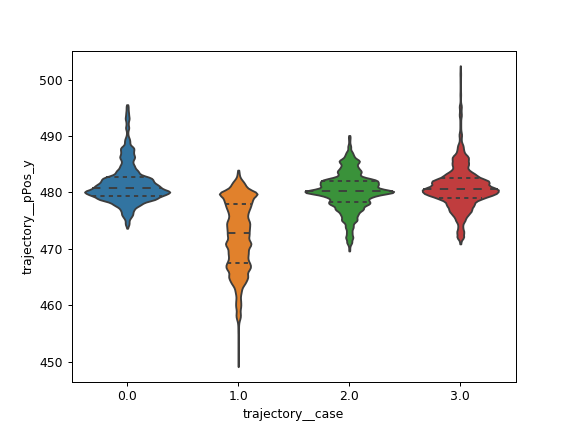

In [64]:
t=60
plt.figure()
sns.violinplot(x="trajectory__case", y="trajectory__pPos_y", data=dford2[(dford2['frame']<165*t)&(dford2['trajectory__speed']>0)&(dford2['trajectory__runNum']<200)],inner="quartile",
                              cut=0,scale_hue=True)#,scale='count')

In [35]:
mxl=[]#max list
for df in dfor:
    maxY=df.groupby(['trajectory__runNum','trajectory__case']).max()[['trajectory__pPos_y']].reset_index()
    mxl.append(maxY)

In [37]:
mxld=pd.concat(mxl)

In [ ]:
from scipy import stats
x = [1, 3, 5, 7, 9]
y = [2, 4, 6, 8, 10]
stats.kruskal(x, y)



<IPython.core.display.Javascript object>


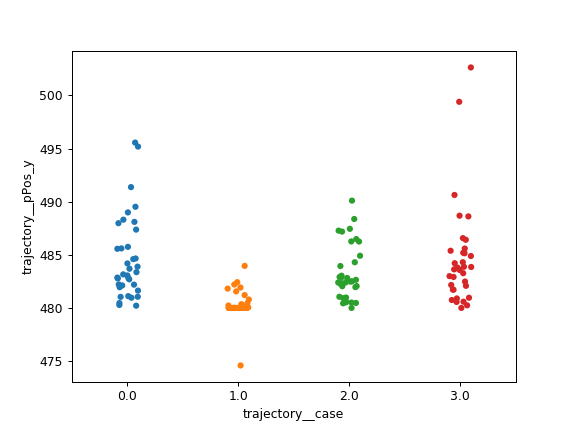

In [40]:



plt.figure()
sns.stripplot(x="trajectory__case", y="trajectory__pPos_y", data=mxld,                              )#,scale='count')

In [ ]:
for df in dfor:
    plt.figure()
    sns.violinplot(x="trajectory__case", y="trajectory__pPos_y", data=df[df.trajectory__case<5],inner="quartile",
                              cut=0,scale_hue=False)#,scale='count')

In [ ]:
plt.arrow()

In [230]:
ax[2].arrow(0,0,np.deg2rad(-27.69),.32,lw=2,alpha=1,color='k')# shape='full',

In [153]:

moms=[]
# for df in dfl2:
for df in dfl:
# 
    mcase=[]
    for case in range(4):
        mom=meanOfMeaner(df[(df.trajectory__case==case)])
        mcase.append(getCircularMean(mom.a,mom.r))
    
    moms.append(mcase)
    
momom=[]
for i, p in enumerate(pl):
    if (1 and p['playerInitPos'][0]==513) and (p['playerInitPos'][1]==510) and\
    (p['loadingString']=='01') and (p['posL'][0]==510) and (p['posL'][1]==516):
        momom.append(moms[i])
        
mdf=pd.DataFrame(momom)
mdf.columns=['0','1','2','3']
mdf



/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:7: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:8: RuntimeWarning: invalid value encountered in divide


,0,1,2,3
0,"(-30.87277071219428, 0.27274573487961706)","(-17.808838598178756, 0.5679517065226118)","(-6.789283806926348, 0.27673697587486884)","(47.25574171203011, 0.36870017000272937)"
1,"(2.8120672298848293, 0.09582032473037043)","(15.526747022731705, 0.49411327878018724)","(-24.37853414924126, 0.3233808172070256)","(-14.833941048278414, 0.5093496583461291)"
2,"(16.834555463226348, 0.1934648461011153)","(26.296184787904576, 0.630741356053018)","(-17.913376319812915, 0.3745566259668431)","(-12.446170501340314, 0.44013486882785907)"
3,"(-16.261397539240296, 0.28362220876150473)","(17.117416664138464, 0.3050783525041844)","(174.06606659969054, 0.2934782585158922)","(44.69937504928097, 0.2642704822507254)"
4,"(-22.217733005982094, 0.361157438655346)","(9.294481115246857, 0.2545525934563172)","(-14.513540481055887, 0.39328614184536637)","(6.620340487928272, 0.37191419141074344)"
5,"(66.3395098887576, 0.20116243205518347)","(15.087950432634553, 0.4355088334902633)","(-23.33199667487829, 0.3590649927110717)","(14.098568291702053, 0.28141225964744054)"
6,"(-65.34276680681754, 0.18408965300827249)","(-13.543733006407537, 0.23620345770139342)","(-44.73068878875359, 0.39667923121131815)","(-14.94603147042958, 0.38204041347959333)"
7,"(-9.957463272458678, 0.6859633699092487)","(-38.925711702386984, 0.3874480016153996)","(-55.40367703986222, 0.4832734225528886)","(-15.670418761646616, 0.047977812053376694)"


<IPython.core.display.Javascript object>


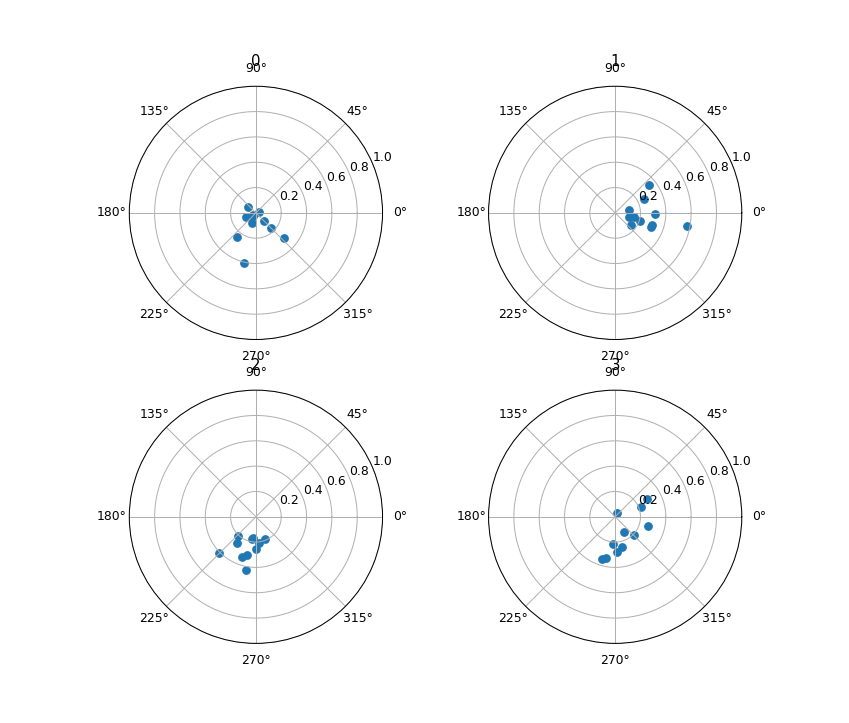

In [141]:
f,ax=plt.subplots(2,2,subplot_kw=dict(polar=True))
ax=ax.reshape(4,)

In [155]:
for i in range(4):
    test=mdf[str(i)].apply(pd.Series)
    test.columns=['a','r']
    ax[i].scatter(np.deg2rad(test.a),test.r)
    ax[i].set_title(i)
    ax[i].set_ylim(0,1)

In [182]:
mdf[mdf.case==0]

,run,case,a,r,fileStamp
0,1.0,0.0,97.028046,0.856400,2017-01-02__15~54~36
4,2.0,0.0,72.658431,0.216791,2017-01-02__15~54~36
8,3.0,0.0,-75.803064,0.389346,2017-01-02__15~54~36
12,4.0,0.0,-36.084387,0.116886,2017-01-02__15~54~36
16,5.0,0.0,177.062847,0.200660,2017-01-02__15~54~36
20,6.0,0.0,152.747759,0.254230,2017-01-02__15~54~36
24,7.0,0.0,37.258960,0.091258,2017-01-02__15~54~36
28,8.0,0.0,-38.047137,0.195819,2017-01-02__15~54~36
32,9.0,0.0,179.997645,0.063955,2017-01-02__15~54~36
36,10.0,0.0,171.724873,0.157253,2017-01-02__15~54~36


In [227]:
df=dfl[0]
dfs=np.split(df.reset_index(),np.where(df.trajectory__reset==1)[0])

dec=10
res=[]
for dfx in dfs:
    a,r=getCircularMean(dfx[dfx.trajectory__speed>0].trajectory__pOri_x)
    try:
        res.append([dfx.trajectory__runNum.iloc[0],dfx.trajectory__case.iloc[0],a,r])
    except IndexError:
        print 'error'

        


error


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:7: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:8: RuntimeWarning: invalid value encountered in divide


In [228]:
dfRes=pd.DataFrame(res)
dfRes.columns=['run','case','a','r']
dfRes.head()

,run,case,a,r
0,1.0,0.0,97.028046,0.856400
1,1.0,1.0,-39.159138,0.715703
2,1.0,2.0,36.290687,0.516905
3,1.0,3.0,-51.674465,0.637138
4,2.0,0.0,72.658431,0.216791


<IPython.core.display.Javascript object>


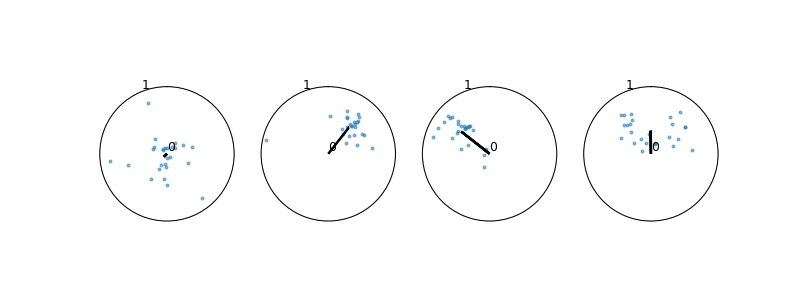

In [229]:
polarMeanOfMean(dfRes)

In [17]:

def polarMeanOfMean(dfRes):
    dfRes=dfRes.copy()
    f,ax = plt.subplots(1,4, subplot_kw=dict(projection='polar'),figsize=(4,1))
    ax=ax.reshape((4))
    # ax = plt.subplots(4,1, subplot_kw=dict(projection='polar'))
    for case in dfRes.case.unique():
        dfx=dfRes[dfRes.case==case]
        a,r=getCircularMean(dfx.a,dfx.r)
        case=int(case)

        ax[case].scatter(np.deg2rad(dfx['a']),dfx['r'],s=5,alpha=0.5)
        ax[case].arrow(0,0,np.deg2rad(a),r,lw=2,alpha=1,color='k')# shape='full',

        ax[case].set_theta_offset(np.pi/2)
        ax[case].set_rticks([0,1])  # Less radial ticks
        ax[case].set_rmax(1)
        ax[case].set_thetagrids([] )



In [63]:
dfl2=[]
for i, df in enumerate(dfl):
    parameters=pl[i]
    
    df['posLang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(parameters['posL'][1]),-df.trajectory__pPos_x.sub(parameters['posL'][0])))))+180)%360)-180
    dfl2.append(df)

In [67]:
dfl2[0].columns

Index([u'trajectory__DCoffset', u'trajectory__boutFrame', u'trajectory__case',
       u'trajectory__caseU', u'trajectory__compensation', u'trajectory__gain',
       u'trajectory__groundSpeed', u'trajectory__headingControl',
       u'trajectory__impose', u'trajectory__imposeHeading',
       u'trajectory__imposeResponse', u'trajectory__imposeResponseHeading',
       u'trajectory__imposeResponseSmooth', u'trajectory__isFlying',
       u'trajectory__key', u'trajectory__o1Pos_x', u'trajectory__o1Pos_y',
       u'trajectory__o1Pos_z', u'trajectory__o2Pos_x', u'trajectory__o2Pos_y',
       u'trajectory__o2Pos_z', u'trajectory__pOri_x', u'trajectory__pOri_y',
       u'trajectory__pOri_z', u'trajectory__pPos_x', u'trajectory__pPos_y',
       u'trajectory__pPos_z', u'trajectory__packetDuration',
       u'trajectory__packetFrequency', u'trajectory__pfStimState',
       u'trajectory__quadrant', u'trajectory__reset', u'trajectory__runNum',
       u'trajectory__servoAngle', u'trajectory__slip', u'tr

In [68]:
def meanOfMeaner(df):
    df=df.copy()
    dfs=np.split(df.reset_index(),np.where(df.trajectory__reset==1)[0])
    dec=10
    res=[]

    
# for i, df in enumerate(dfl[:]):
# for j,ip in enumerate(dist):
#     if (pl[i]['playerInitPos'][0]==ip[0]) and (pl[i]['playerInitPos'][1]==ip[1]) \
#         and(pl[i]['posL'][0]==519)and(pl[i]['posL'][1]==516):

#         parameters=pl[i]

#         df['posLdist']=np.linalg.norm(df[['trajectory__pPos_x', 'trajectory__pPos_y']].sub(parameters['posL'][0:2]),axis=1)
#         df['posRdist']=np.linalg.norm(df[['trajectory__pPos_x', 'trajectory__pPos_y']].sub(parameters['posR'][0:2]),axis=1)

#         df['posLang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(parameters['posL'][1]),-df.trajectory__pPos_x.sub(parameters['posL'][0])))))+180)%360)-180
#         df['posRang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(parameters['posR'][1]),-df.trajectory__pPos_x.sub(parameters['posR'][0])))))+180)%360)-180

#         df2=df[(df.trajectory__speed>0)][['trajectory__case','posRang','posLang','posRdist','posLdist']]
#         df2['posLdistBin']=(pd.cut(df2.posLdist,bins))
#         df2['posRdistBin']=(pd.cut(df2.posRdist,bins))

#         dfl_.append(df2)


    
    
    
    for dfx in dfs:
        a,r=getCircularMean(dfx[dfx.trajectory__speed>0].posLang)
#         a,r=getCircularMean(dfx[dfx.trajectory__speed>0].trajectory__pOri_x)
#
        
        try:
            res.append([dfx.trajectory__runNum.iloc[0],dfx.trajectory__case.iloc[0],a,r])
        except IndexError:
            pass
    
    dfRes=pd.DataFrame(res)
    dfRes.columns=['run','case','a','r']
    return dfRes


In [21]:
dfs=np.split(df.reset_index(),np.where(df.trajectory__reset==1)[0])
res=[]

for dfx in dfs:
    a,r=getCircularMean(dfx[dfx.trajectory__speed>0].trajectory__pOri_x)
    try:
        res.append([dfx.trajectory__runNum.iloc[0],dfx.trajectory__case.iloc[0],a,r])
    except IndexError:
        pass

dfRes=pd.DataFrame(res)
dfRes.columns=['run','case','a','r']
return dfRes


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:7: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:8: RuntimeWarning: invalid value encountered in divide


SyntaxError: 'return' outside function (<ipython-input-21-e5eaa18710fe>, line 13)

In [22]:
m=meanOfMeaner(df)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:7: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:8: RuntimeWarning: invalid value encountered in divide


In [71]:
m['X']=m['r']*np.cos(np.deg2rad(m['a']))
m['Y']=m['r']*np.sin(np.deg2rad(m['a']))

m['X2']=np.square(m['X'])
m['Y2']=np.square(m['Y'])
m.head()

,run,case,a,r,X,Y,X2,Y2
0,1.0,0.0,97.028046,0.856400,-0.104785,0.849966,0.010980,0.722442
1,1.0,1.0,-39.159138,0.715703,0.554952,-0.451949,0.307972,0.204258
2,1.0,2.0,36.290687,0.516905,0.416638,0.305947,0.173587,0.093603
3,1.0,3.0,-51.674465,0.637138,0.395107,-0.499834,0.156110,0.249834
4,2.0,0.0,72.658431,0.216791,0.064618,0.206936,0.004176,0.042823


In [24]:
for case in m.case.unique()[:1]:
    m2=m[m.case==case]
    k=len(m2)
    Xk=m2['X2'].mean()/k
    Yk=m2['Y2'].mean()/k

    
    m2['x2']=m2['X2']-Xk
    m2['y2']=m2['Y2']-Yk


KeyError: 'X2'

In [69]:
moms=[]
for df in dfl2:
# for df in dfl:
# 
    mcase=[]
    for case in range(4):
        mom=meanOfMeaner(df[(df.trajectory__case==case)])
        mcase.append(getCircularMean(mom.a,mom.r))
    
    moms.append(mcase)
    

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:7: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:8: RuntimeWarning: invalid value encountered in divide


In [70]:
momom=[]
for i, p in enumerate(pl):
    if (1 and p['playerInitPos'][0]==513) and (p['playerInitPos'][1]==513) and\
    (p['loadingString']=='01') and (p['posL'][0]==510) and (p['posL'][1]==516):
        momom.append(moms[i])
        
    

In [71]:
mdf=pd.DataFrame(momom)
mdf.columns=['0','1','2','3']
mdf

test=mdf['0'].apply(pd.Series)
test.columns=['a','r']

<IPython.core.display.Javascript object>


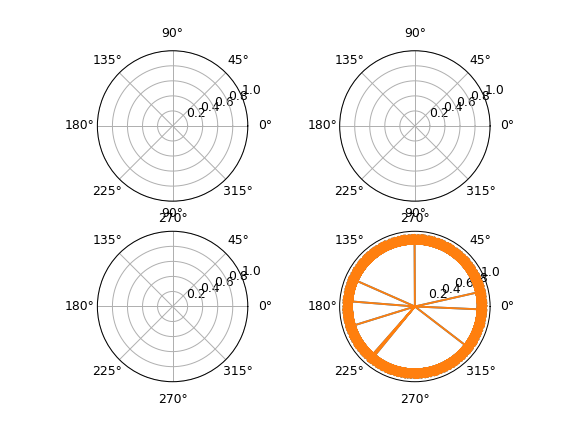

In [90]:
test

,a,r
0,-100.964209,0.429919
1,-97.541271,0.168036
2,-101.079260,0.180452
3,-109.122807,0.337946
4,-66.514338,0.188354
5,-83.317967,0.208974
6,-133.474412,0.204929
7,-125.635015,0.250441
8,-89.687793,0.256087
9,-135.242796,0.411549


In [111]:
mooreTest(test)

(0.001, 1.8090640466271666)

In [108]:
test=mdf['0'].apply(pd.Series)
test.columns=['a','r']

In [89]:
ax.scatter(np.deg2rad(test.a),test.r)

In [57]:
test

,a,r
0,-30.643536,0.392981
1,-1.402689,0.143161
2,104.043943,0.065714
3,48.064367,0.402683
4,60.290019,0.302035
5,-13.227652,0.283773
6,-19.742458,0.231822
7,4.508976,0.267503
8,43.721933,0.344685
9,-37.211019,0.374572


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:7: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:8: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>


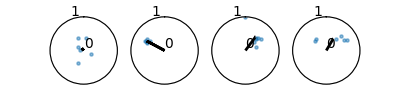

<IPython.core.display.Javascript object>


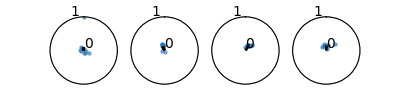

<IPython.core.display.Javascript object>


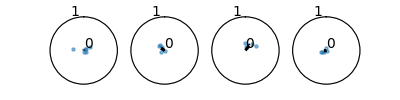

<IPython.core.display.Javascript object>


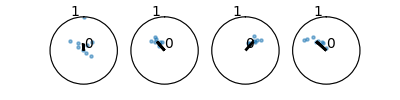

<IPython.core.display.Javascript object>


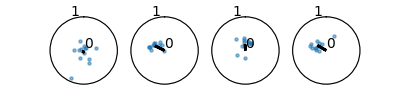

<IPython.core.display.Javascript object>


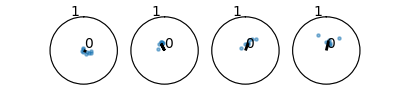

<IPython.core.display.Javascript object>


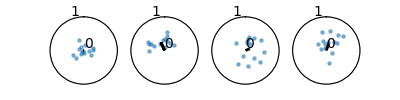

<IPython.core.display.Javascript object>


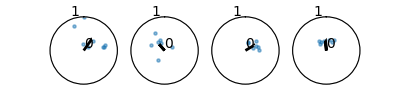

<IPython.core.display.Javascript object>


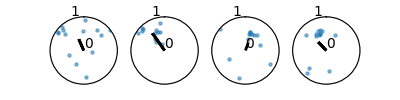

<IPython.core.display.Javascript object>


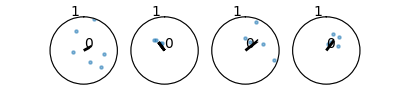

<IPython.core.display.Javascript object>


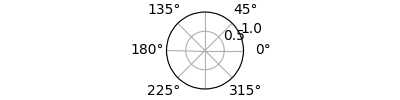

In [16]:
for i,df in enumerate(dfl):
    if (1 and pl[i]['playerInitPos'][0]==513) and (pl[i]['playerInitPos'][1]==513) and\
    (pl[i]['loadingString']=='01') and (pl[i]['posL'][0]==510) and (pl[i]['posL'][1]==516):
        polarMeanOfMean(meanOfMeaner(df))

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:7: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:8: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>


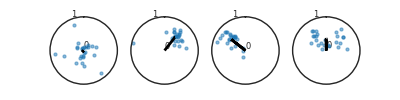

<IPython.core.display.Javascript object>


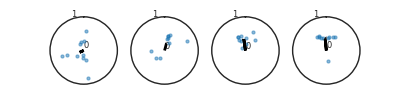

<IPython.core.display.Javascript object>


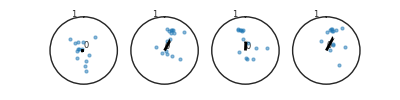

<IPython.core.display.Javascript object>


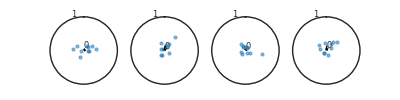

<IPython.core.display.Javascript object>


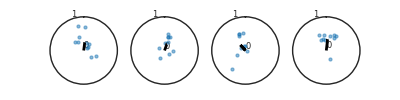

<IPython.core.display.Javascript object>


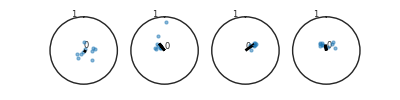

<IPython.core.display.Javascript object>


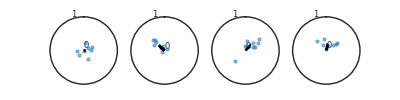

<IPython.core.display.Javascript object>


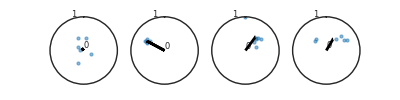

<IPython.core.display.Javascript object>


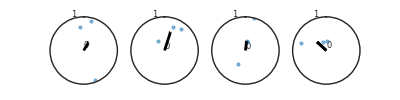

<IPython.core.display.Javascript object>


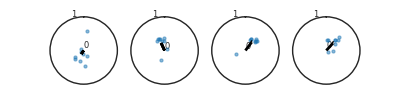

<IPython.core.display.Javascript object>


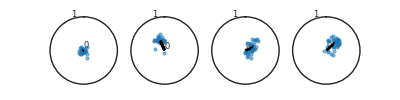

<IPython.core.display.Javascript object>


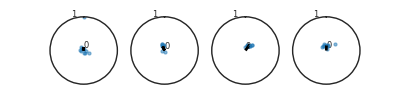

<IPython.core.display.Javascript object>


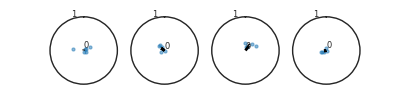

<IPython.core.display.Javascript object>


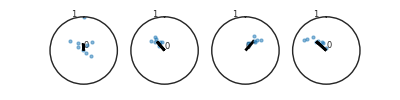

<IPython.core.display.Javascript object>


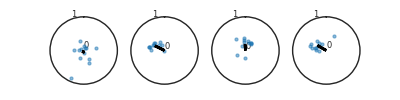

<IPython.core.display.Javascript object>


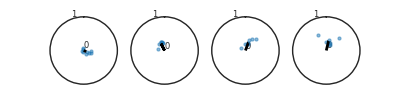

<IPython.core.display.Javascript object>


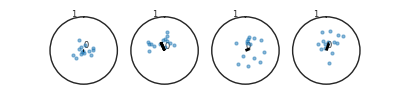

/usr/local/lib/python2.7/dist-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


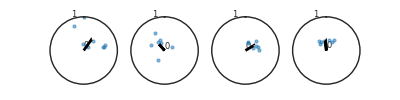

<IPython.core.display.Javascript object>


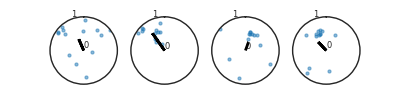

<IPython.core.display.Javascript object>


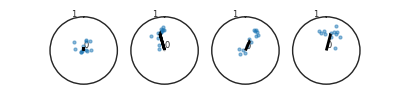

<IPython.core.display.Javascript object>


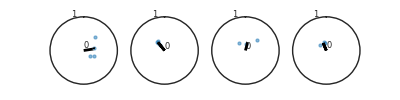

<IPython.core.display.Javascript object>


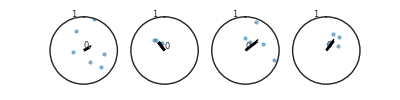

<IPython.core.display.Javascript object>


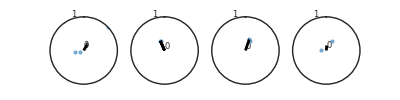

<IPython.core.display.Javascript object>


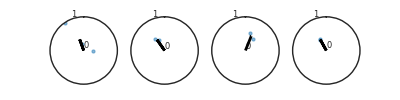

<IPython.core.display.Javascript object>


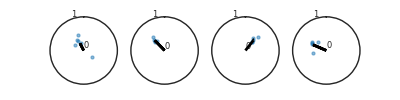

<IPython.core.display.Javascript object>


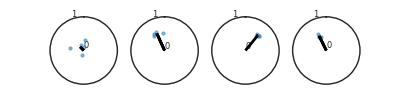

<IPython.core.display.Javascript object>


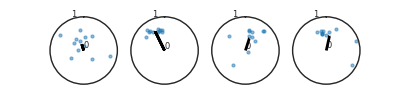

<IPython.core.display.Javascript object>


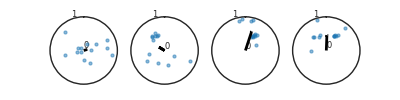

<IPython.core.display.Javascript object>


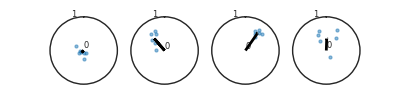

<IPython.core.display.Javascript object>


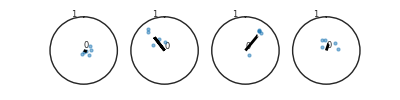

<IPython.core.display.Javascript object>


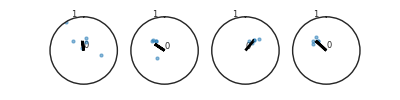

<IPython.core.display.Javascript object>


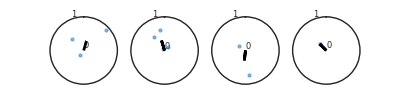

<IPython.core.display.Javascript object>


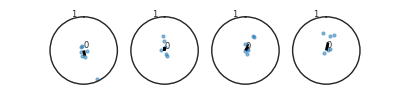

<IPython.core.display.Javascript object>


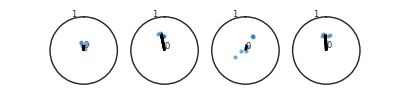

<IPython.core.display.Javascript object>


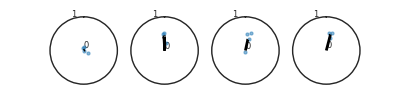

<IPython.core.display.Javascript object>


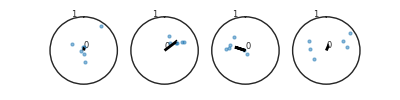

<IPython.core.display.Javascript object>


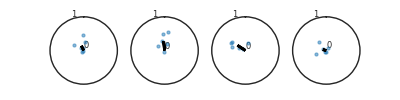

<IPython.core.display.Javascript object>


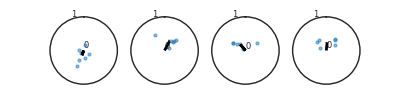

<IPython.core.display.Javascript object>


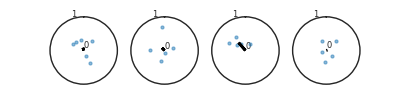

<IPython.core.display.Javascript object>


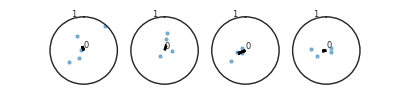

<IPython.core.display.Javascript object>


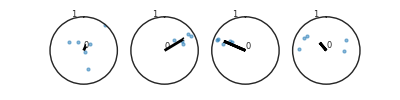

<IPython.core.display.Javascript object>


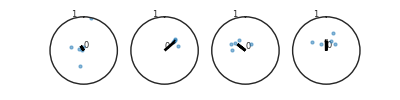

<IPython.core.display.Javascript object>


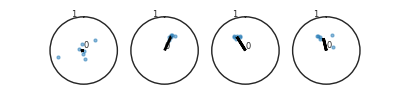

<IPython.core.display.Javascript object>


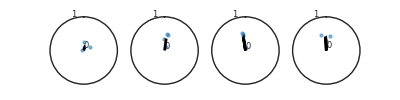

<IPython.core.display.Javascript object>


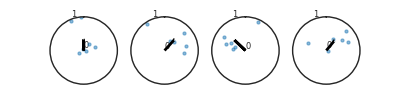

<IPython.core.display.Javascript object>


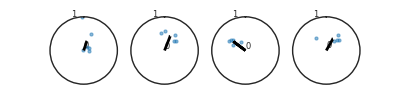

<IPython.core.display.Javascript object>


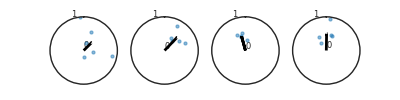

<IPython.core.display.Javascript object>


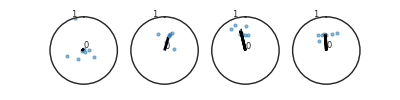

<IPython.core.display.Javascript object>


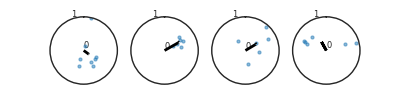

<IPython.core.display.Javascript object>


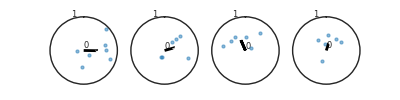

<IPython.core.display.Javascript object>


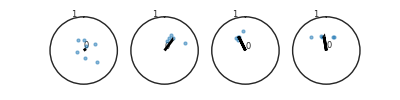

<IPython.core.display.Javascript object>


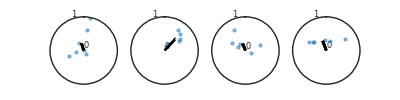

<IPython.core.display.Javascript object>


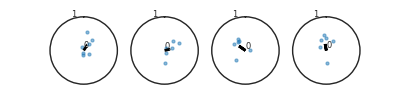

<IPython.core.display.Javascript object>


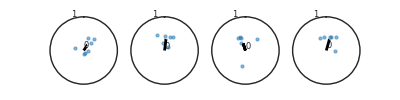

<IPython.core.display.Javascript object>


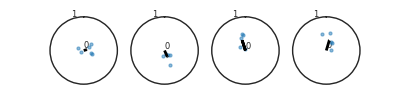

<IPython.core.display.Javascript object>


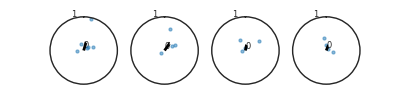

<IPython.core.display.Javascript object>


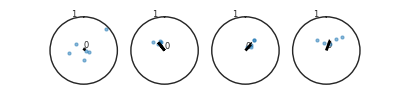

<IPython.core.display.Javascript object>


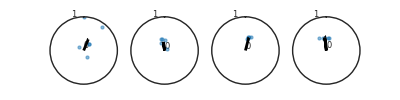

<IPython.core.display.Javascript object>


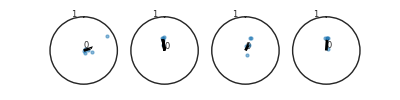

<IPython.core.display.Javascript object>


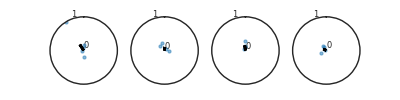

<IPython.core.display.Javascript object>


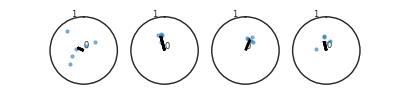

<IPython.core.display.Javascript object>


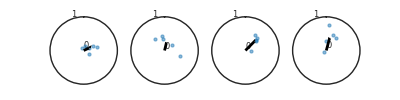

<IPython.core.display.Javascript object>


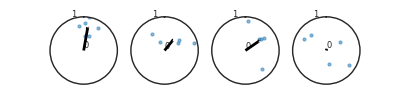

In [386]:
for df in dfl:
    polarMeanOfMean(meanOfMeaner(df))

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:7: RuntimeWarning: invalid value encountered in divide
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:8: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>


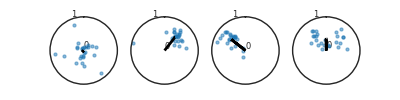

In [385]:

polarMeanOfMean(meanOfMeaner(df))

<IPython.core.display.Javascript object>


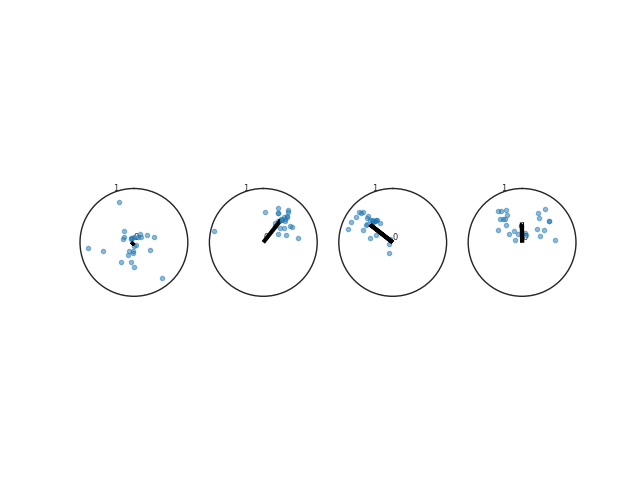

In [374]:
f,ax = plt.subplots(1,4, subplot_kw=dict(projection='polar'))
ax=ax.reshape((4))
# ax = plt.subplots(4,1, subplot_kw=dict(projection='polar'))
for case in dfRes.case.unique():
    dfx=dfRes[dfRes.case==case]
    a,r=getCircularMean(dfx.a,dfx.r)
    case=int(case)
    
    ax[case].scatter(np.deg2rad(dfx['a']),dfx['r'],s=10,alpha=0.5)
    ax[case].arrow(0,0,np.deg2rad(a),r,lw=3,alpha=1,color='k')# shape='full',
    
    ax[case].set_theta_offset(np.pi/2)
    ax[case].set_rticks([0,1])  # Less radial ticks
    ax[case].set_rmax(1)
    ax[case].set_thetagrids([] )

    

In [ ]:
for case in dfRes.case.unique():

    for i in dfRes[dfRes.case==case].iterrows():
        ax[case].arrow(0,0,np.deg2rad(i[1][2]),i[1][3],lw=3,color=col[int(case)],alpha=0.5)# shape='full',


<IPython.core.display.Javascript object>


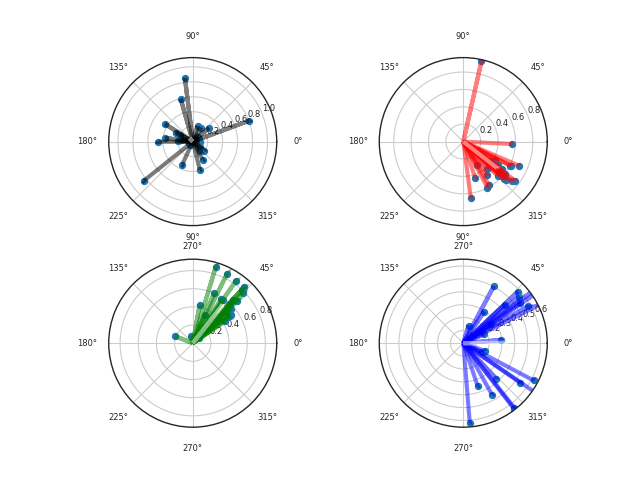

In [286]:
f,ax = plt.subplots(2,2, subplot_kw=dict(projection='polar'))
ax=ax.reshape(4,1)
# ax = plt.subplots(4,1, subplot_kw=dict(projection='polar'))
col=['k','r','g','b']
for case in dfRes.case.unique():

    for i in dfRes[dfRes.case==case].iterrows():
        ax[case].arrow(0,0,np.deg2rad(i[1][2]),i[1][3],lw=3,color=col[int(case)],alpha=0.5)# shape='full',


0.0
1.0
2.0
3.0


In [16]:
pd.concat(dfor)

,trajectory__DCoffset,trajectory__boutFrame,trajectory__case,trajectory__caseU,trajectory__compensation,trajectory__gain,trajectory__groundSpeed,trajectory__headingControl,trajectory__impose,trajectory__imposeHeading,...,trajectory__servoAngle,trajectory__slip,trajectory__speed,trajectory__speedControl,trajectory__trial,trajectory__valve1,trajectory__valve2,trajectory__valve3,trajectory__wbad,trajectory__wbas
2018-09-18 08:46:34.612341760,0.189,0.0,0.0,0.0,0.0,8.0,185.888032,0.0,0.0,0.0,...,270.0,297.550718,0.0,0.0,1.0,0.0,0.0,0.0,-0.107904,1.755939
2018-09-18 08:46:34.616354816,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.0,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.107904,1.755939
2018-09-18 08:46:34.621726976,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.0,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.107904,1.787192
2018-09-18 08:46:34.627780864,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.0,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.076651,1.693433
2018-09-18 08:46:34.633863936,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.0,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.076651,1.693433
2018-09-18 08:46:34.639909888,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.0,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.061024,1.709059
2018-09-18 08:46:34.646094080,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.0,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.061024,1.709059
2018-09-18 08:46:34.652329984,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.0,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.092277,1.709059
2018-09-18 08:46:34.657831936,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.0,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.123530,1.740312
2018-09-18 08:46:34.663806976,0.189,0.0,0.0,0.0,0.0,8.0,0.000000,0.0,0.0,0.0,...,270.0,270.000000,0.0,0.0,1.0,0.0,0.0,0.0,-0.123530,1.740312


/usr/lib/python2.7/dist-packages/tables/__init__.py:82: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility
  from tables.utilsextension import (
/usr/lib/python2.7/dist-packages/tables/file.py:35: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility
  from tables import hdf5extension
/usr/lib/python2.7/dist-packages/tables/link.py:32: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility
  from tables import linkextension
/usr/lib/python2.7/dist-packages/tables/table.py:25: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility
  from tables import tableextension
/usr/lib/python2.7/dist-packages/tables/index.py:30: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility
  from tables import indexesextension


0 of 8
1 of 8
2 of 8
3 of 8
4 of 8
5 of 8
6 of 8
7 of 8


In [9]:
sns.set_context('paper')
# sns.set_context('talk')
# 
plt.rcParams['svg.fonttype'] = 'none'
# plt.rcParams['font.sans-serif'] = "Palatino Linotype"

In [107]:
np.array(dfl)

array([                               trajectory__DCoffset  trajectory__boutFrame  \
2017-01-02 10:24:39.412955904                 -0.12                    NaN   
2017-01-02 10:24:39.414643968                 -0.12                    NaN   
2017-01-02 10:24:39.420705024                 -0.12                    NaN   
2017-01-02 10:24:39.426845952                 -0.12                    NaN   
2017-01-02 10:24:39.432931072                 -0.12                    NaN   
2017-01-02 10:24:39.438988032                 -0.12                    NaN   
2017-01-02 10:24:39.445001984                 -0.12                    NaN   
2017-01-02 10:24:39.451150848                 -0.12                    NaN   
2017-01-02 10:24:39.457140992                 -0.12                    NaN   
2017-01-02 10:24:39.463219968                 -0.12                    NaN   
2017-01-02 10:24:39.469336064                 -0.12                    NaN   
2017-01-02 10:24:39.475420928                 -0.12      

In [106]:
dfl

[                               trajectory__DCoffset  trajectory__boutFrame  \
 2017-01-02 10:24:39.412955904                 -0.12                    NaN   
 2017-01-02 10:24:39.414643968                 -0.12                    NaN   
 2017-01-02 10:24:39.420705024                 -0.12                    NaN   
 2017-01-02 10:24:39.426845952                 -0.12                    NaN   
 2017-01-02 10:24:39.432931072                 -0.12                    NaN   
 2017-01-02 10:24:39.438988032                 -0.12                    NaN   
 2017-01-02 10:24:39.445001984                 -0.12                    NaN   
 2017-01-02 10:24:39.451150848                 -0.12                    NaN   
 2017-01-02 10:24:39.457140992                 -0.12                    NaN   
 2017-01-02 10:24:39.463219968                 -0.12                    NaN   
 2017-01-02 10:24:39.469336064                 -0.12                    NaN   
 2017-01-02 10:24:39.475420928                 -0.12

<IPython.core.display.Javascript object>


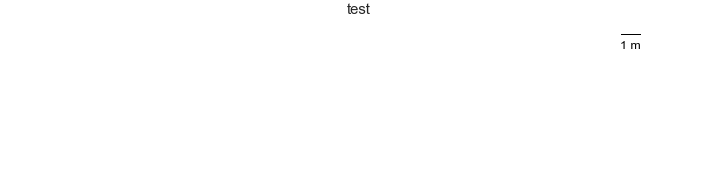

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7faf42e8f390>,
      dtype=object)

In [72]:
treeFig(dfl,figType='tree',naked=True)

<IPython.core.display.Javascript object>


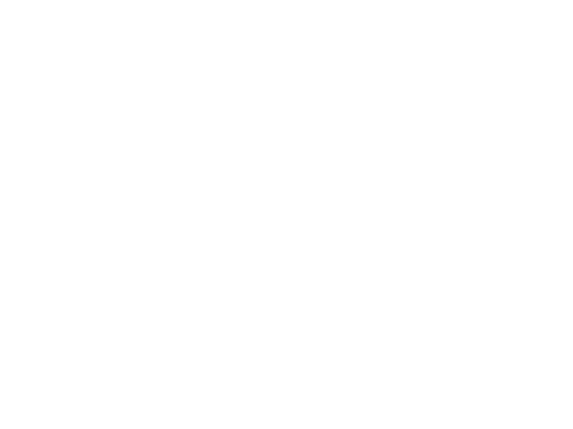

<IPython.core.display.Javascript object>


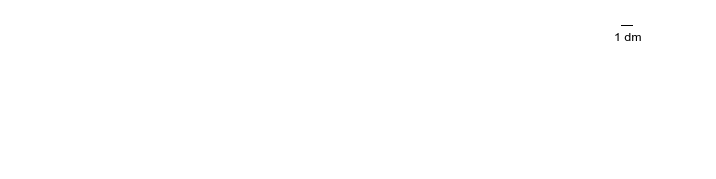

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7faf42818ed0>,
      dtype=object)

In [78]:
plt.figure()
treeFig(dfl,figType='tree_dist',naked=True)

In [76]:
plt.show()

<IPython.core.display.Javascript object>


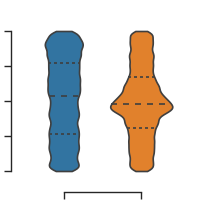

In [85]:
treeFig(dfl,figType='vio_tree')

In [87]:
pubFigStyle()

<IPython.core.display.Javascript object>


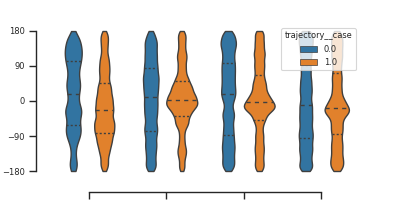

In [88]:
treeFig(dfl,figType='vio_tree_dist')

<IPython.core.display.Javascript object>


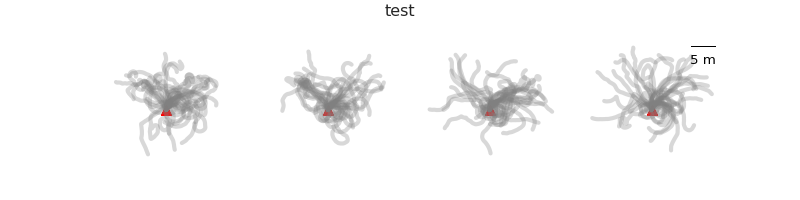

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f0f6f98f350>,
      dtype=object)

In [30]:
treeFig(dfl,figType='ang',naked=True)

<IPython.core.display.Javascript object>


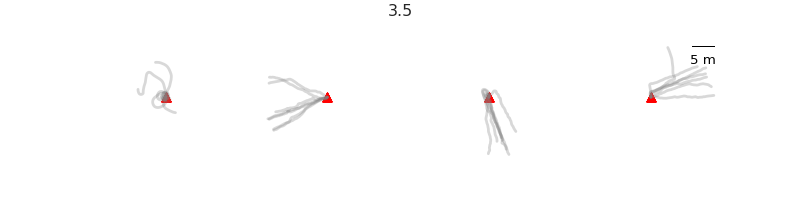

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f0f6f3a35d0>,
      dtype=object)

In [32]:
treeFig(dfl,figType='wind',naked=True)

<IPython.core.display.Javascript object>


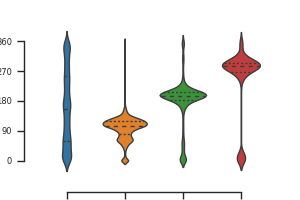

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:125: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [93]:
treeFig(dfl,figType='vio_wind')

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:142: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


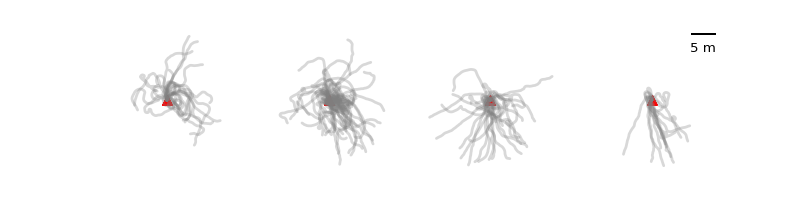

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f0f4d645510>,
      dtype=object)

In [37]:
treeFig(dfl,figType='wind_speed',naked=True)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:152: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:153: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


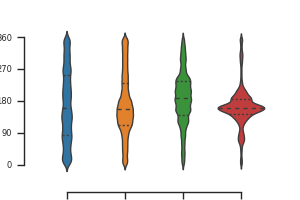

In [99]:
treeFig(dfl,figType='vio_wind_speed',)

<IPython.core.display.Javascript object>


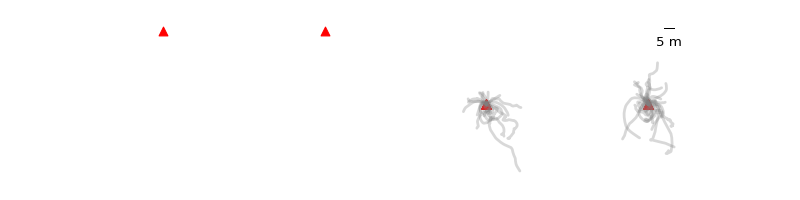

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


no params, error in auto start find, ressetting to defaukt
no params, error in auto start find, ressetting to defaukt


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f0ee31da250>,
      dtype=object)

In [45]:
treeFig(dfv,figType='vada',naked=True)

<IPython.core.display.Javascript object>


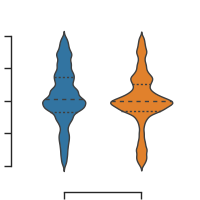

In [89]:
treeFig(dfv,figType='vio_vada')

In [54]:
nsecs=60
dfdl=[]
for i,df in enumerate(dfv):
    p=plv[i]['metadata']['playerInitPos']
    if (p[0]==513) and (p[1]==480):
        df=addBoutFrame(df)
        dfdl.append(df)

dfd=pd.concat(dfdl)    


SyntaxError: invalid syntax (<ipython-input-54-ec22fc2994fe>, line 9)

<IPython.core.display.Javascript object>


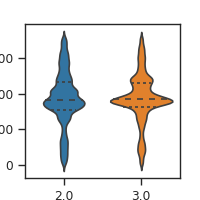

In [56]:
runs=3
plt.figure(figsize=(2,2))
dfd['servo']=(dfd.trajectory__servoAngle-90)%360
ax=sns.violinplot(x='trajectory__case',y='servo',data=dfd[(dfd.trajectory__speed>0)&
                  (dfd.frame<165*nsecs)&(dfd.trajectory__case>1)&(dfd.trajectory__runNum<runs)],
                  inner='quartile',scale_hue=False,)#palette={0.0: "g", 1.0: "b", 2.0:"b",3.0:'#ffbaba9f'},saturation=1)



In [79]:
kuiper(np.deg2rad(dfd[(dfd.trajectory__speed>0)&(dfd.frame<165*nsecs)&(dfd.trajectory__case==3)&(dfd.trajectory__runNum<runs)].servo.values[:1000]),np.deg2rad(dfd[(dfd.trajectory__speed>0)&(dfd.frame<165*nsecs)&(dfd.trajectory__case==3)&(dfd.trajectory__runNum<runs)].servo.values[100:1101]),axis=0)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:60: UserWarning: N=1000 not found in table, using closest N=501 present.


(array([0.05]), array([84697.]))

In [68]:
import warnings
def load_kuiper_table():
    """
    Loads the lookup table for the kuiper test
    :return: table as numpy array
    """
    return np.load('/home/rhagoletis/Downloads/kuiper_table.npy')

In [66]:

def kuiper(alpha1, alpha2, res=100, axis=None):
    """
    The Kuiper two-sample test tests whether the two samples differ
    significantly.The difference can be in any property, such as mean
    location and dispersion. It is a circular analogue of the
    Kolmogorov-Smirnov test.
    H0: The two distributions are identical.
    HA: The two distributions are different.
    :param alpha1: fist sample (in radians)
    :param alpha2: second sample (in radians)
    :param res:    resolution at which the cdf is evaluated (default 100)
    :returns: p-value and test statistic
              p-value is the smallest of .10, .05, .02, .01, .005, .002,
              .001, for which the test statistic is still higher
              than the respective critical value. this is due to
              the use of tabulated values. if p>.1, pval is set to 1.
    References: [Batschelet1980]_ p. 112
    """

    if axis is not None:
        assert alpha1.shape[
               1:] == alpha2.shape[
                      1:], "Shapes of alphas not consistent with computation along axis."
    n, m = alpha1.shape[axis], alpha2.shape[axis]

    _, cdf1 = _sample_cdf(alpha1, res, axis=axis)
    _, cdf2 = _sample_cdf(alpha2, res, axis=axis)

    dplus = np.atleast_1d((cdf1 - cdf2).max(axis=axis))
    dplus[dplus < 0] = 0.
    dminus = np.atleast_1d((cdf2 - cdf1).max(axis=axis))
    dminus[dminus < 0] = 0.

    k = n * m * (dplus + dminus)
    mi = np.min([m, n])
    fac = np.sqrt(n * m * (n + m))
    pval = np.asarray([_kuiper_lookup(mi, kk / fac)
                       for kk in k.ravel()]).reshape(k.shape)
    return pval, k


def _kuiper_lookup(n, k):
    ktable = load_kuiper_table()

    alpha = np.asarray([.10, .05, .02, .01, .005, .002, .001])
    nn = ktable[:, 0]

    isin = (nn == n)
    if np.any(isin):
        row = np.where(isin)[0]
    else:
        row = len(nn) - np.sum(n < nn) - 1

        if row == 0:
            raise ValueError('N too small.')
        else:
            warnings.warn(
                'N=%d not found in table, using closest N=%d present.' %
                (n, nn[row]))

    idx = (ktable[row, 1:] < k).squeeze()
    if np.any(idx):
        return alpha[idx].min()
    else:
        return 1.


def _sample_cdf(alpha, resolution=100., axis=None):
    """
    Helper function for circ_kuipertest.
    Evaluates CDF of sample in thetas.
    :param alpha: sample (in radians)
    :param resolution: resolution at which the cdf is evaluated (default 100)
    :param axis: axis along which the cdf is computed
    :returns: points at which cdf is evaluated, cdf values
    """

    if axis is None:
        alpha = alpha.ravel()
        axis = 0
    bins = np.linspace(0, 2 * np.pi, resolution + 1)
    old_shape = alpha.shape
    alpha = alpha % (2 * np.pi)

    alpha = alpha.reshape((alpha.shape[0], int(np.prod(alpha.shape[1:])))).T
    cdf = np.array([np.histogram(a, bins=bins)[0]
                    for a in alpha]).cumsum(axis=1) / float(alpha.shape[1])
    cdf = cdf.T.reshape((len(bins) - 1,) + old_shape[1:])

    return bins[:-1], cdf


In [5]:
plt.rcParams['font.sans-serif'] = "Palatino Linotype"

In [2]:
%matplotlib notebook

In [24]:
cd

/home/rhagoletis


In [30]:
cd /home/rhagoletis/Downloads/FlyRanch-figurefirst-26e62e1/

/home/rhagoletis/Downloads/FlyRanch-figurefirst-26e62e1


In [31]:
cd examples

/home/rhagoletis/Downloads/FlyRanch-figurefirst-26e62e1/examples


<IPython.core.display.Javascript object>


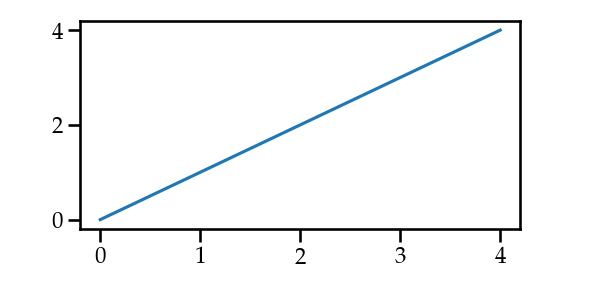

In [33]:
import numpy as np
import matplotlib.pyplot as plt
plt.ion()
from figurefirst import FigureLayout

layout = FigureLayout('example_hello_world_layout.svg')
layout.make_mplfigures()

d = np.array([[144, 57], [138, 57], [138, 59], [141, 61], [141, 82], [138, 84], [138, 85], [142, 85], [147, 85], [147, 84], [144, 82], [144, 57], [144, 57], [155, 57], [149, 57], [149, 59], [152, 61], [152, 82], [149, 84], [149, 85], [153, 85], [158, 85], [158, 84], [155, 82], [155, 57], [155, 57], [273, 57], [267, 57], [267, 59], [270, 61], [270, 82], [267, 84], [267, 85], [271, 85], [276, 85], [276, 84], [273, 82], [273, 57], [273, 57], [295, 57], [289, 57], [289, 59], [292, 61], [292, 70], [287, 67], [278, 76], [287, 85], [292, 83], [292, 85], [298, 85], [298, 84], [295, 81], [295, 57], [295, 57], [90, 57], [90, 59], [91, 59], [94, 61], [94, 82], [91, 84], [90, 84], [90, 85], [96, 85], [102, 85], [102, 84], [101, 84], [98, 82], [98, 71], [110, 71], [110, 82], [107, 84], [106, 84], [106, 85], [112, 85], [118, 85], [118, 84], [117, 84], [113, 82], [113, 61], [117, 59], [118, 59], [118, 57], [112, 58], [106, 57], [106, 59], [107, 59], [110, 61], [110, 70], [98, 70], [98, 61], [101, 59], [102, 59], [102, 57], [96, 58], [90, 57], [90, 57], [193, 57], [193, 59], [197, 60], [205, 85], [205, 86], [206, 85], [213, 65], [219, 85], [220, 86], [221, 85], [229, 61], [233, 59], [233, 57], [229, 58], [224, 57], [224, 59], [228, 61], [227, 62], [221, 80], [215, 60], [215, 60], [218, 59], [218, 57], [213, 58], [208, 57], [208, 59], [211, 60], [212, 63], [207, 80], [200, 60], [200, 60], [203, 59], [203, 57], [198, 58], [193, 57], [193, 57], [128, 67], [120, 76], [129, 85], [135, 80], [135, 80], [134, 80], [129, 84], [125, 82], [123, 76], [134, 76], [135, 75], [128, 67], [128, 67], [169, 67], [160, 76], [169, 85], [178, 76], [169, 67], [169, 67], [240, 67], [231, 76], [240, 85], [249, 76], [240, 67], [240, 67], [257, 67], [251, 68], [251, 69], [254, 71], [254, 82], [251, 84], [251, 85], [256, 85], [261, 85], [261, 84], [260, 84], [257, 82], [257, 75], [262, 68], [262, 68], [261, 70], [263, 71], [265, 70], [262, 67], [257, 71], [257, 67], [257, 67], [128, 68], [133, 75], [123, 75], [128, 68], [128, 68], [169, 68], [173, 70], [174, 76], [173, 81], [169, 84], [164, 82], [163, 76], [164, 70], [169, 68], [169, 68], [240, 68], [244, 70], [246, 76], [245, 81], [240, 84], [235, 82], [234, 76], [235, 70], [240, 68], [240, 68], [287, 68], [292, 70], [292, 72], [292, 80], [292, 82], [287, 84], [283, 82], [281, 76], [283, 71], [287, 68], [287, 68]])

ax = layout.axes['ax_name']['axis']

ax.plot(range(5))

layout.insert_figures('target_layer_name')

layout.write_svg('example_hello_world_output.svg')

<IPython.core.display.Javascript object>


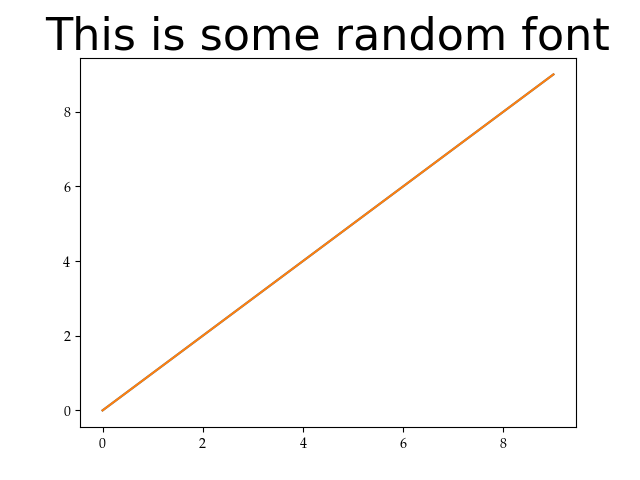

In [4]:
import matplotlib.font_manager as fm
import matplotlib.pyplot as plt

import matplotlib.pyplot as plt

plt.plot(range(10))
plt.title('This is some random font', family='Palatino Linotype', size=32)

plt.show()

<IPython.core.display.Javascript object>


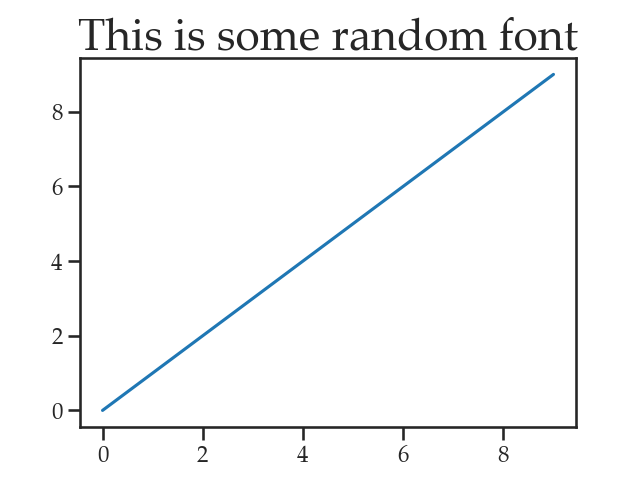

In [41]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager

path = '/home/rhagoletis/.fonts/PalatinoLinotype-Roman - Palatino Linotype - Regular.ttf'
prop = font_manager.FontProperties(fname=path)
mpl.rcParams['font.family'] = prop.get_name()
fig, ax = plt.subplots()
ax.set_title('Text in a cool font', size=40)
plt.show()

In [42]:
prop.get_name()

u'Palatino Linotype'

<IPython.core.display.Javascript object>


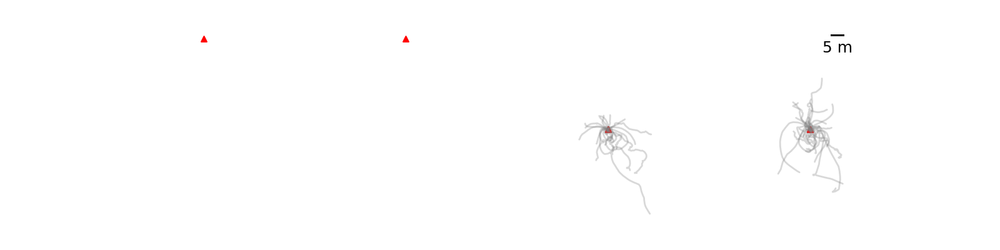

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


no params, error in auto start find, ressetting to defaukt
no params, error in auto start find, ressetting to defaukt


/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f03de84bd90>,
      dtype=object)

In [26]:
treeFig(dfv,figType='vada',naked=True)

<IPython.core.display.Javascript object>


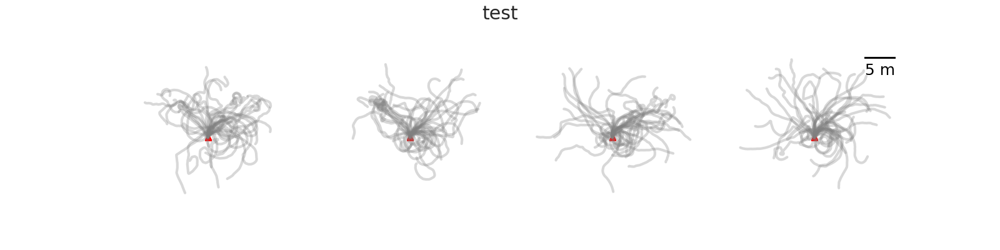

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f03df2abc90>,
      dtype=object)

In [17]:
treeFig(figType='ang',naked=True)

In [12]:
df,metadata,filename=h5load('/media/rhagoletis/6db8b2b2-ebe2-4555-9b79-93b10ef9dec31/2018/2018_05/2018_05_01/2018-05-01__13~00~49_apple81_ang_gain~8_speed~1.0_bout~15_DC~0.189_traj.bag.h5')
parameters=metadata['metadata']

<IPython.core.display.Javascript object>


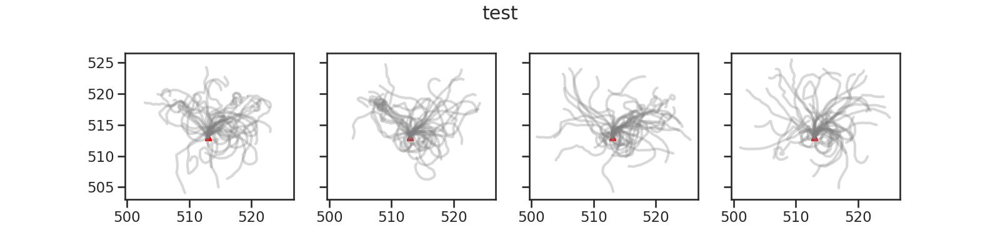

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f03e55e6b10>,
      dtype=object)

In [15]:
pltQuadTrajPlot(df,linewidth=3)


In [35]:
df,param,pat=h5load('/home/rhagoletis/catkin/src/analyseWorld/ipy_notebooks/all_wind.h5')
df.windPressure=df.windPressure.astype(float)


In [45]:
df=addBoutFrame(df)

In [52]:
(df[(df.flowSource=='direct')].frame==8).sum()/4

158

In [54]:
dfvd=pd.concat(dfv)

In [56]:
dfvd=addBoutFrame(dfvd)

In [62]:
pdfv=pd.DataFrame(plv)

In [64]:
pdfv

,bagFileName,metadata
0,/media/rhagoletis/Traj/aggreg/odour/vada/2018-...,"{u'interTrial': 3, u'pfGenTimeSeries': True, u..."
1,/media/rhagoletis/Traj/aggreg/odour/vada/2018-...,"{u'interTrial': 3, u'pfGenTimeSeries': True, u..."
2,/media/rhagoletis/Traj/aggreg/odour/vada/2018-...,"{u'interTrial': 3, u'pfGenTimeSeries': True, u..."
3,/media/rhagoletis/Traj/aggreg/odour/vada/2018-...,"{u'interTrial': 3, u'pfGenTimeSeries': True, u..."
4,/media/rhagoletis/Traj/aggreg/odour/vada/2018-...,"{u'interTrial': 3, u'pfGenTimeSeries': True, u..."
5,/media/rhagoletis/Traj/aggreg/odour/vada/2018-...,"{u'interTrial': 3, u'pfGenTimeSeries': True, u..."
6,/media/rhagoletis/Traj/aggreg/odour/vada/2018-...,"{u'interTrial': 3, u'pfGenTimeSeries': True, u..."
7,/media/rhagoletis/Traj/aggreg/odour/vada/2018-...,"{u'interTrial': 3, u'pfGenTimeSeries': True, u..."
8,/media/rhagoletis/Traj/aggreg/odour/vada/2018-...,"{u'interTrial': 3, u'pfGenTimeSeries': True, u..."


In [58]:
(dfvd.frame==4).sum()/4

34

In [50]:
(df[(df.flowSource=='direct')].timeStamp.unique().shape)

(22,)

In [10]:
df=pd.concat(dfl)

In [24]:
j=0
k=0
for i,df in enumerate(dfl):
#     if (1 and pl[i]['playerInitPos'][0]==513) and (pl[i]['playerInitPos'][1]==513) and\
#     (pl[i]['loadingString']=='01') and (pl[i]['posR'][0]==510) and (pl[i]['posR'][1]==516):
    j+=1
    k+=df.trajectory__runNum.max()
        

In [26]:
pdf=pd.DataFrame(pl)

In [30]:
pdf[pdf[]].fly.unique().shape

(26,)

In [ ]:
for p in pl:
    

In [25]:

j,k

(63, 552.0)

In [17]:
j,k

(11, 103.0)

In [13]:
df=addBoutFrame(df)

In [ ]:
df[df]

In [15]:
(df.frame==20).sum()

1908

In [12]:
df.shape[0]/(165*60)

561

<IPython.core.display.Javascript object>


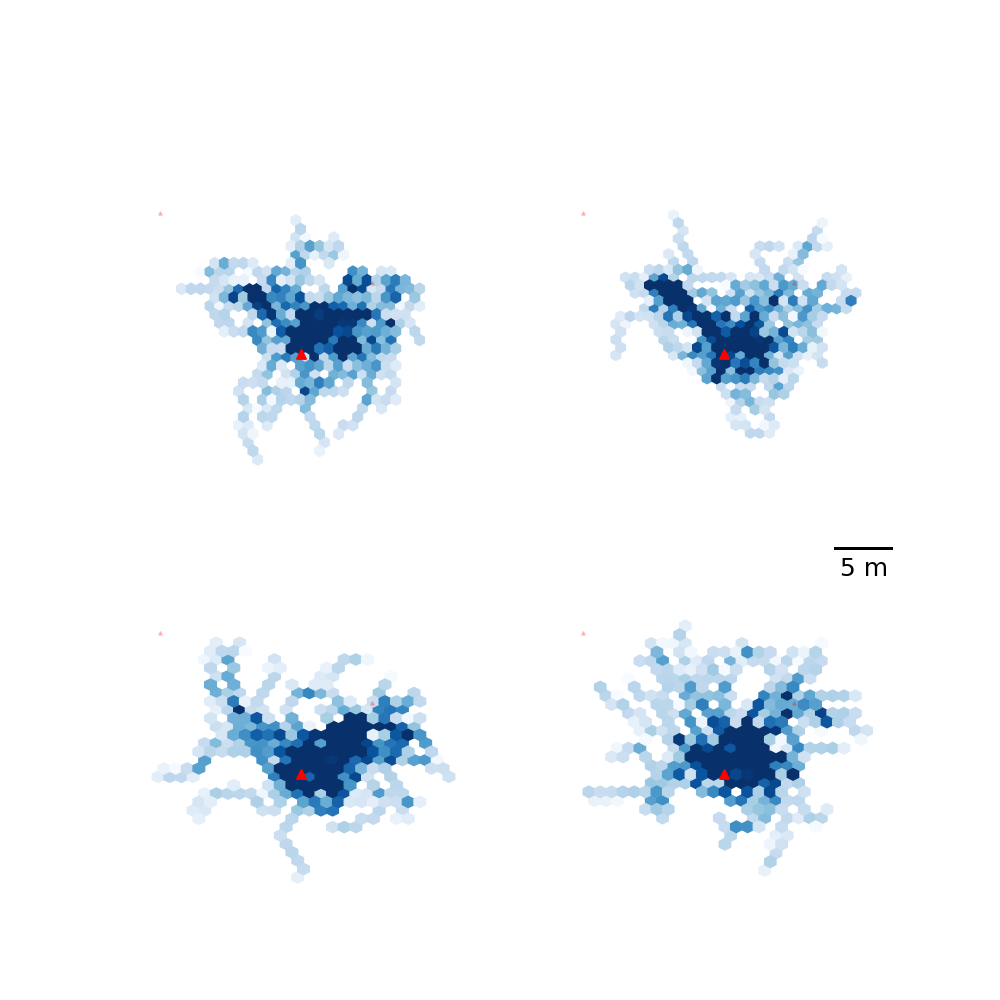

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe231ac1590>,
      dtype=object)

In [205]:
treeFig(figType='ang',despine=True,naked=True)

<IPython.core.display.Javascript object>


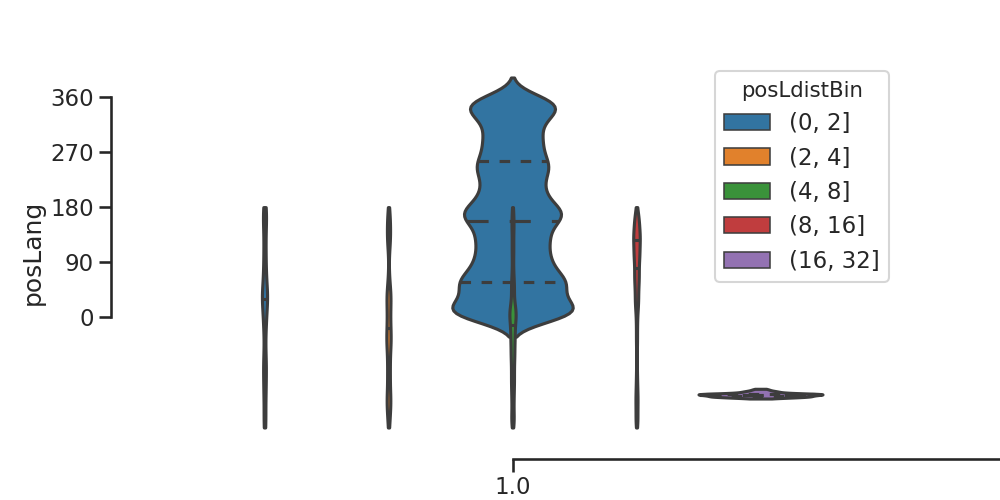

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:125: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [62]:
treeFig(dfl,figType='vio_wind')

In [50]:
treeFig(dfl,figType='vio_wind')

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:120: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:121: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


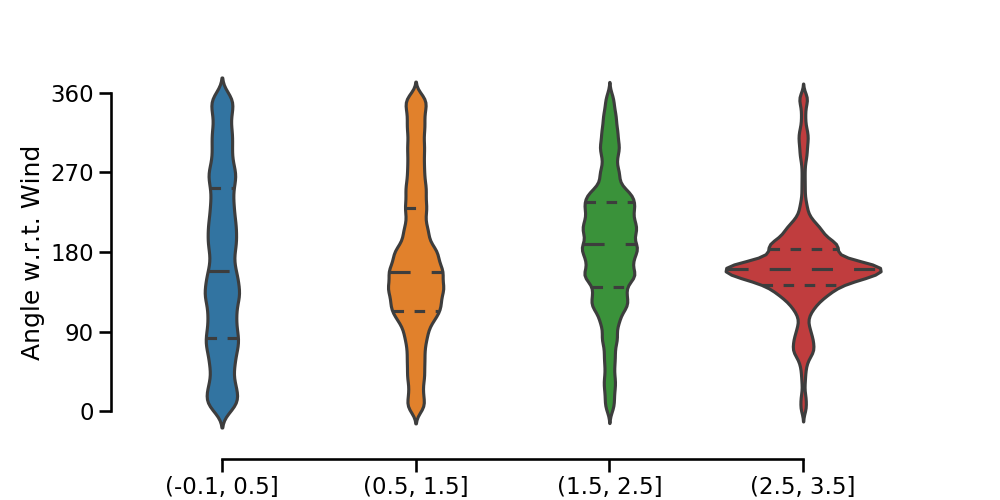

In [21]:
treeFig(dfl,figType='vio_wind_speed')

<IPython.core.display.Javascript object>


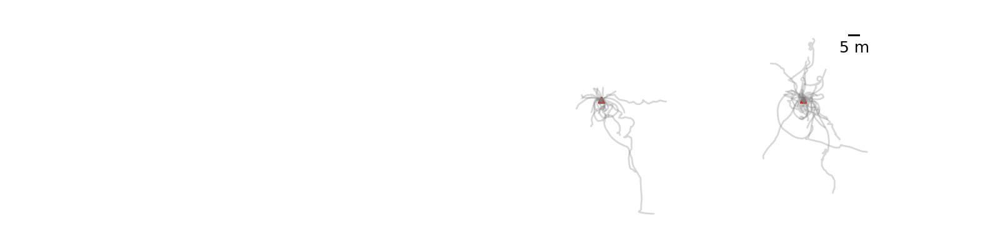

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


no params, error in auto start find, ressetting to defaukt
no params, error in auto start find, ressetting to defaukt


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f5c942b9750>,
      dtype=object)

In [345]:
# dfv,plv=h5DirLoader('/media/rhagoletis/Traj/aggreg/odour/vada/')
treeFig(dfv,figType='vada',naked=True,runs=4)

<IPython.core.display.Javascript object>


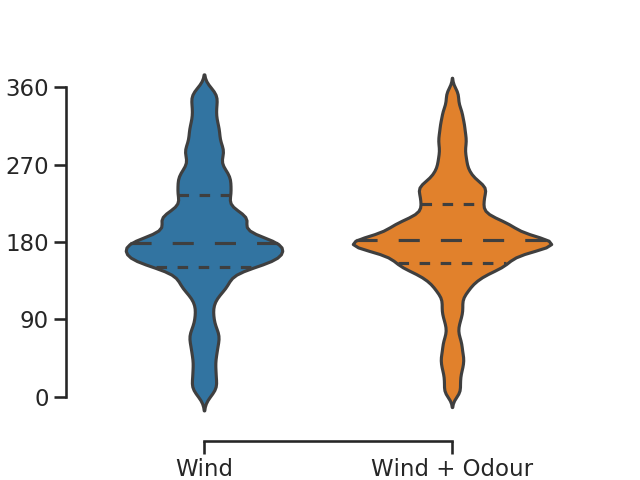

In [342]:
treeFig(dfv,figType='vio_vada',runs=4,despine=True)

<IPython.core.display.Javascript object>


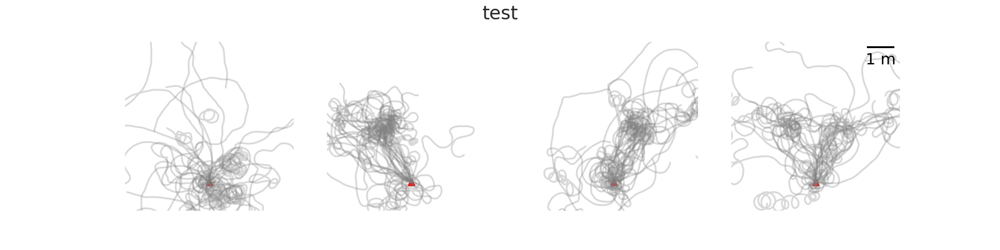

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


In [239]:
treeFig(dfl,figType='tree',naked=True)

<IPython.core.display.Javascript object>


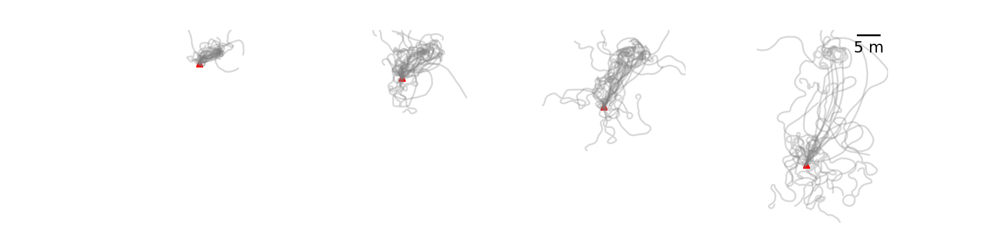

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


In [240]:
treeFig(dfl,figType='tree_dist',naked=True)

<IPython.core.display.Javascript object>


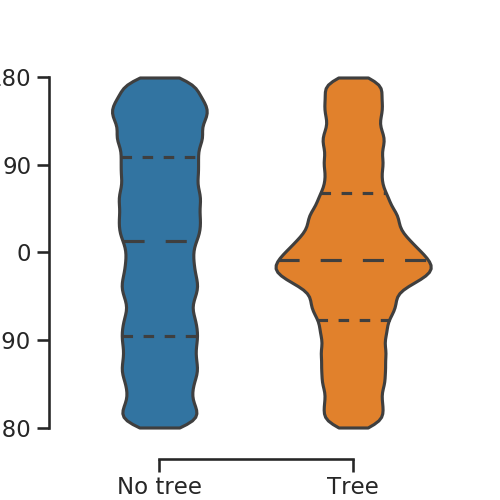

In [36]:
treeFig(dfl,figType='vio_tree')

<IPython.core.display.Javascript object>


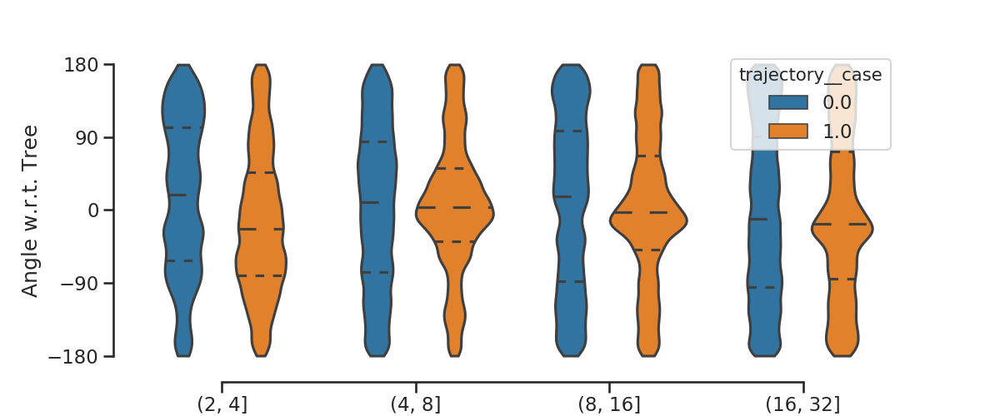

In [46]:
treeFig(dfl,figType='vio_tree_dist')

<IPython.core.display.Javascript object>


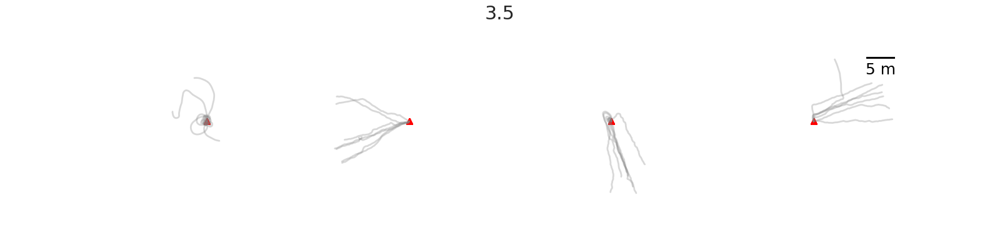

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe14921f750>,
      dtype=object)

In [23]:
treeFig(dfl,figType='wind',naked=True)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:110: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


<IPython.core.display.Javascript object>


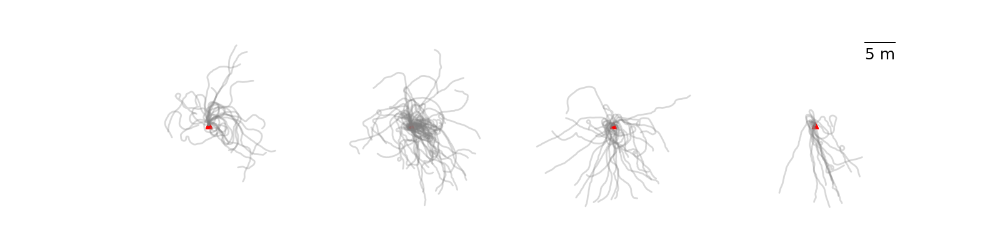

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe1617b80d0>,
      dtype=object)

In [22]:
treeFig(dfl,figType='wind_speed',naked=True)

<IPython.core.display.Javascript object>


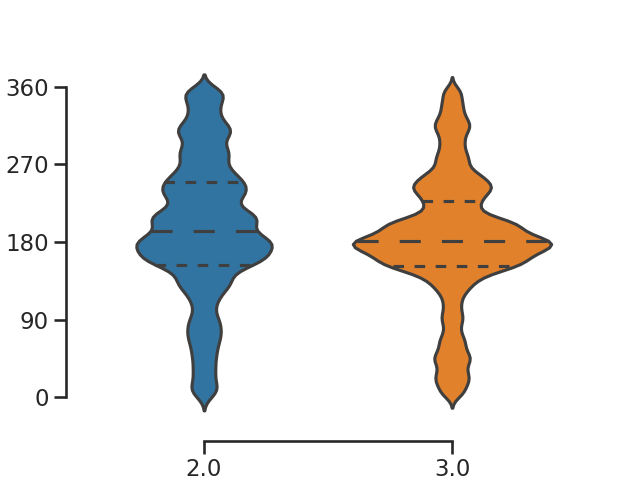

In [294]:
treeFig(dfv,figType='vio_vada')

<IPython.core.display.Javascript object>


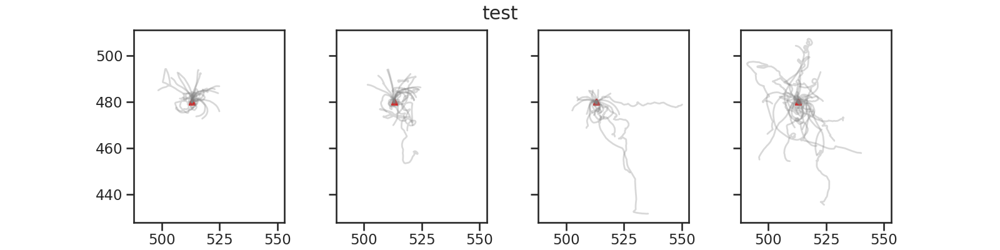

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


In [277]:
nsecs=200
f,ax=plt.subplots(1,4,'all','all',figsize=(16,4))
dfdl=[]
for i,df in enumerate(dfv):
    p=plv[i]['metadata']['playerInitPos']
    if (p[0]==513) and (p[1]==480):
        df=addBoutFrame(df)
#         dfdl.append(df)
        pltQuadTrajPlot(df[df.frame<165*nsecs],ax=ax,)
#     dfd=pd.concat(dfdl)    
#     pltQuadTrajPlot(dfd[dfd.frame<165*nsecs],ax=ax,)

In [23]:
dist=[(513,513),(513,510),(513,504),(513,492),]#(513,480)]
pip=[]
for i,df in enumerate(dfl):
#     print pl[i]['posL'],pl[i]['posR'],pl[i]['playerInitPos']
    pip.append([pl[i]['playerInitPos'][0],pl[i]['playerInitPos'][1],pl[i]['posL'][0],pl[i]['posL'][1],pl[i]['posL'][2]])
pdf=pd.DataFrame(pip)
pdf.columns=['a','b','c','d','e']
pdf.groupby(['a','b','c','d']).count()

e
a   b   c   d      
513 480 519 516   1
    490 510 516   1
    492 519 516   4
    496 516 516   1
    500 510 516   1
    503 516 516   1
    504 510 516   1
        519 516   5
    506 506 516   1
    507 507 516   4
        510 516   3
        516 516   2
    510 507 516   1
        510 516   8
        519 516   6
    511 510 516   2
    513 509 517   2
        510 516  11
        516 516   1
        519 516   5
514 510 507 516   1
    513 510 516   1

In [353]:
filename

'/media/rhagoletis/6db8b2b2-ebe2-4555-9b79-93b10ef9dec31/2018/2018_05/2018_05_01/2018-05-01__13~00~49_apple81_ang_gain~8_speed~1.0_bout~15_DC~0.189_traj.bag.h5'

In [33]:
# df,parameters,filename=h5load('/media/rhagoletis/Traj/aggreg/01/2017-01-02__15~54~36_apple11_01_traj.bag.h5')
# df,parameters,filename=h5load('/media/rhagoletis/Traj/aggreg/01/2017-01-02__17~18~07_apple11_01_traj.bag.h5')
# df,metadata,filename=h5load('/media/rhagoletis/6db8b2b2-ebe2-4555-9b79-93b10ef9dec31/2018/2018_05/2018_05_01/2018-05-01__13~00~49_apple81_ang_gain~8_speed~1.0_bout~15_DC~0.189_traj.bag.h5')
df,metadata,filename=h5load('/media/rhagoletis/6db8b2b2-ebe2-4555-9b79-93b10ef9dec31/2018/2018_04/2018_04_23/2018-04-23__15~36~48_apple81_ang_gain~8_speed~1.0_bout~30_DC~0.235_traj.bag.h5')

# parameters=metadata['metadata']
# df,parameters,filename=h5load()
df['ori']=((df.trajectory__pOri_x+180)%360)-180
# df=Out[23][0]
# parameters=Out[23][1]

In [34]:
df['trajectory__runNum'].max()

11.0

In [54]:
%matplotlib notebook

In [32]:
    f,ax=plt.subplots(1,2)
    
    df['posLdist']=np.linalg.norm(df[['trajectory__pPos_x', 'trajectory__pPos_y']].sub(parameters['posL'][0:2]),axis=1)
    df['posRdist']=np.linalg.norm(df[['trajectory__pPos_x', 'trajectory__pPos_y']].sub(parameters['posR'][0:2]),axis=1)

    df['posLang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(parameters['posL'][1]),-df.trajectory__pPos_x.sub(parameters['posL'][0])))))+180)%360)-180
    df['posRang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(parameters['posR'][1]),-df.trajectory__pPos_x.sub(parameters['posR'][0])))))+180)%360)-180

    df2=df[(df.trajectory__speed>0)&(df.trajectory__case==1)][['trajectory__case','posRang','posLang','posRdist','posLdist']]

    bins=np.linspace(0,20,8)
    bins=[0,2,4,8,16,32]

    df2['posLdistBin']=(pd.cut(df2.posLdist,bins))
    df2['posRdistBin']=(pd.cut(df2.posRdist,bins))

    sns.violinplot(x="trajectory__case", y="posLang", data=df2,inner="quartile",cut=0,hue='posLdistBin',ax=ax[0])#,scale='count')
    pltTrajPlot(df,1,ax=ax[1],)
    sns.despine()
    plt.savefig('vioTraj_'+pl[i]['bagFileName'].split('/')[-1]+'.svg')

'2017-01-02__17~01~04_apple11_01_traj.bag.h5'

<IPython.core.display.Javascript object>


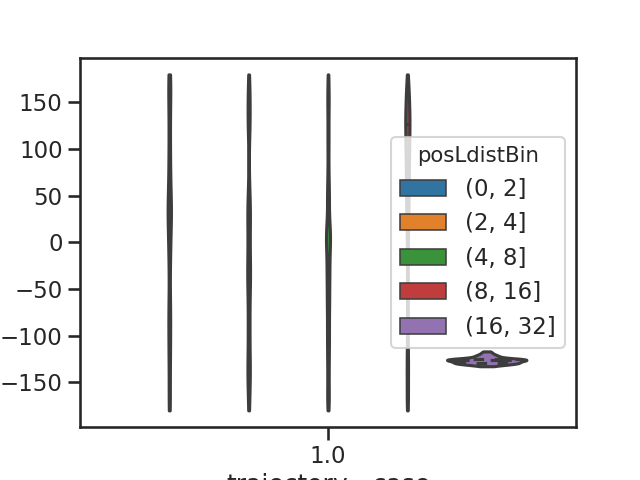

In [65]:
df['posLdist']=np.linalg.norm(df[['trajectory__pPos_x', 'trajectory__pPos_y']].sub(parameters['posL'][0:2]),axis=1)
df['posRdist']=np.linalg.norm(df[['trajectory__pPos_x', 'trajectory__pPos_y']].sub(parameters['posR'][0:2]),axis=1)

df['posLang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(parameters['posL'][1]),-df.trajectory__pPos_x.sub(parameters['posL'][0])))))+180)%360)-180
df['posRang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(parameters['posR'][1]),-df.trajectory__pPos_x.sub(parameters['posR'][0])))))+180)%360)-180

df2=df[(df.trajectory__speed>0)&(df.trajectory__case==1)][['trajectory__case','posRang','posLang','posRdist','posLdist']]

bins=np.linspace(0,20,8)
bins=[0,2,4,8,16,32]

df2['posLdistBin']=(pd.cut(df2.posLdist,bins))
df2['posRdistBin']=(pd.cut(df2.posRdist,bins))

plt.figure()
ax = sns.violinplot(x="trajectory__case", y="posLang", data=df2,inner="quartile",cut=0,hue='posLdistBin')#,scale='count')

In [93]:
df['posLdist']=np.linalg.norm(df[['trajectory__pPos_x', 'trajectory__pPos_y']].sub(parameters['posL'][0:2]),axis=1)
df['posRdist']=np.linalg.norm(df[['trajectory__pPos_x', 'trajectory__pPos_y']].sub(parameters['posR'][0:2]),axis=1)

df['posLang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(parameters['posL'][1]),-df.trajectory__pPos_x.sub(parameters['posL'][0])))))+180)%360)-180
df['posRang']=((((df.trajectory__pOri_x+90)%360 -(np.rad2deg(np.arctan2(-df.trajectory__pPos_y.sub(parameters['posR'][1]),-df.trajectory__pPos_x.sub(parameters['posR'][0])))))+180)%360)-180


# df['posLx']=parameters['posL'][0]
# df['posLy']=parameters['posL'][1]
# df['posRx']=parameters['posR'][0]
# df['posRy']=parameters['posR'][1]


# df['posL']=df[['posLx', 'posLy']].values.tolist()
# df['posR']=df[['posRx', 'posRy']].values.tolist()
# df['pPos']=df[['trajectory__pPos_x', 'trajectory__pPos_y']].values.tolist()


# df['pPos']=np.array(zip(df.trajectory__pPos_x, df.trajectory__pPos_y))
# df['posL']=np.array(zip(df.posLx, df.posLy))
# df['posR']=np.array(zip(df.posRx, df.posRy))

# df
df2=df[df.trajectory__speed>0][['trajectory__case','posRang','posLang','posRdist','posLdist']]

In [467]:
df2['posLdistBin']=(pd.cut(df2.posLdist,np.linspace(0,20,6)))
df2['posRdistBin']=(pd.cut(df2.posRdist,np.linspace(0,20,6)))

<IPython.core.display.Javascript object>


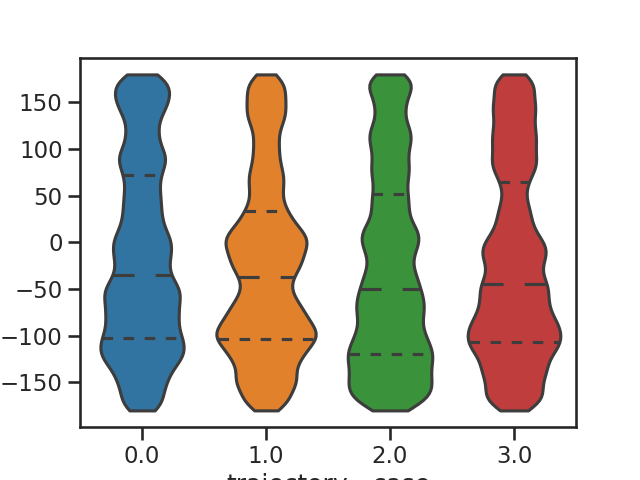

In [94]:
plt.figure()
ax = sns.violinplot(x="trajectory__case", y="posRang", data=df2,inner="quartile",cut=0,)#,scale='count')

<IPython.core.display.Javascript object>


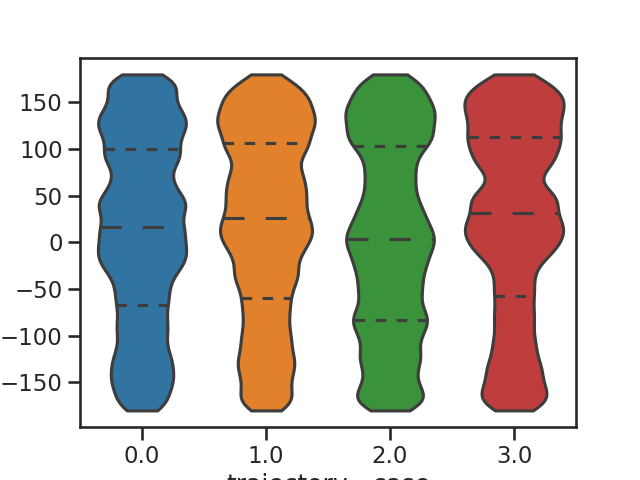

In [95]:
plt.figure()
ax = sns.violinplot(x="trajectory__case", y="posLang", data=df2,inner="quartile",cut=0,)#,scale='count')

<IPython.core.display.Javascript object>


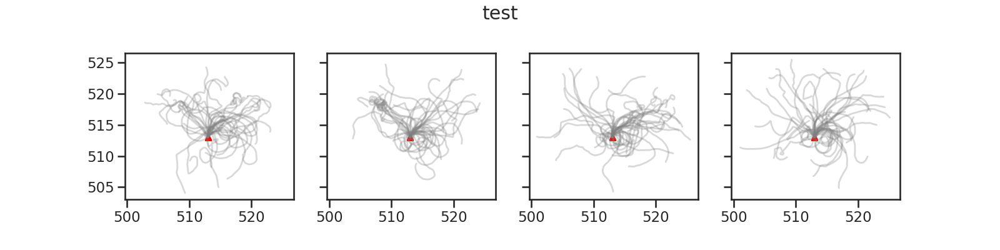

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe1ac8f7dd0>,
      dtype=object)

In [96]:
pltQuadTrajPlot(df)

<IPython.core.display.Javascript object>


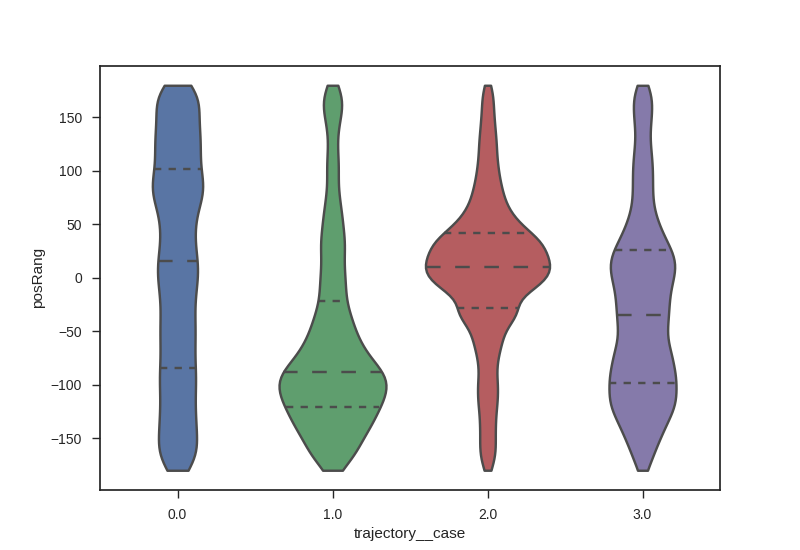

In [469]:
ax = sns.violinplot(x="trajectory__case", y="posRang", data=df[(df.trajectory__speed>0)&(df.posRdist>dist)],inner="quartile",cut=0)

In [23]:
df['servo']=((df.trajectory__servoAngle+180)%360)-180


In [72]:
df['ori']=(df.trajectory__pOri_x+180)%360

<IPython.core.display.Javascript object>


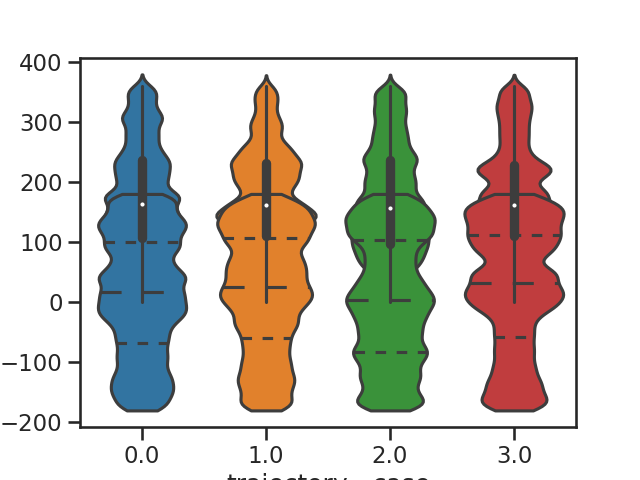

In [74]:
plt.figure()
sns.violinplot(x='trajectory__case',y='ori',data=df[df.trajectory__speed>0])

<IPython.core.display.Javascript object>


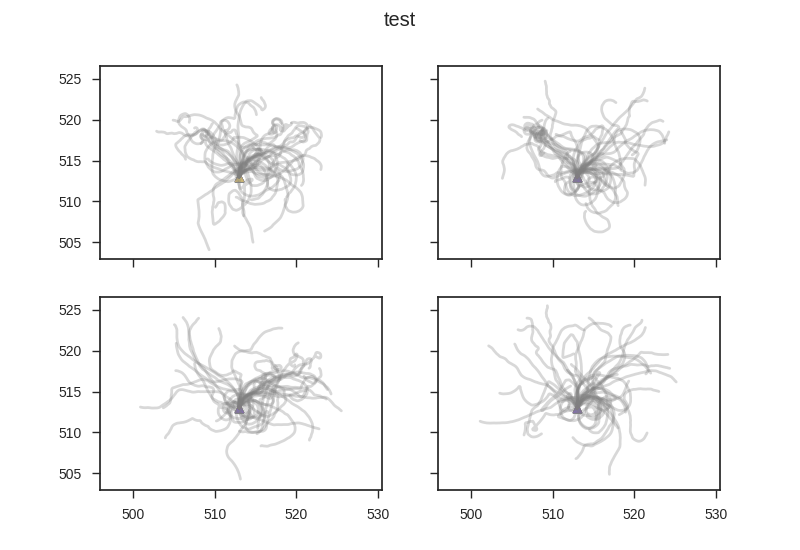

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f68afec3390>,
      dtype=object)

In [402]:
pltQuadTrajPlot(df)

In [115]:
pltQuadTrajPlot(df,ax=ax)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:27: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:28: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fe1d0e40310>,
      dtype=object)

In [ ]:
plt.hexbin()

In [ ]:
sns.despine()

<IPython.core.display.Javascript object>


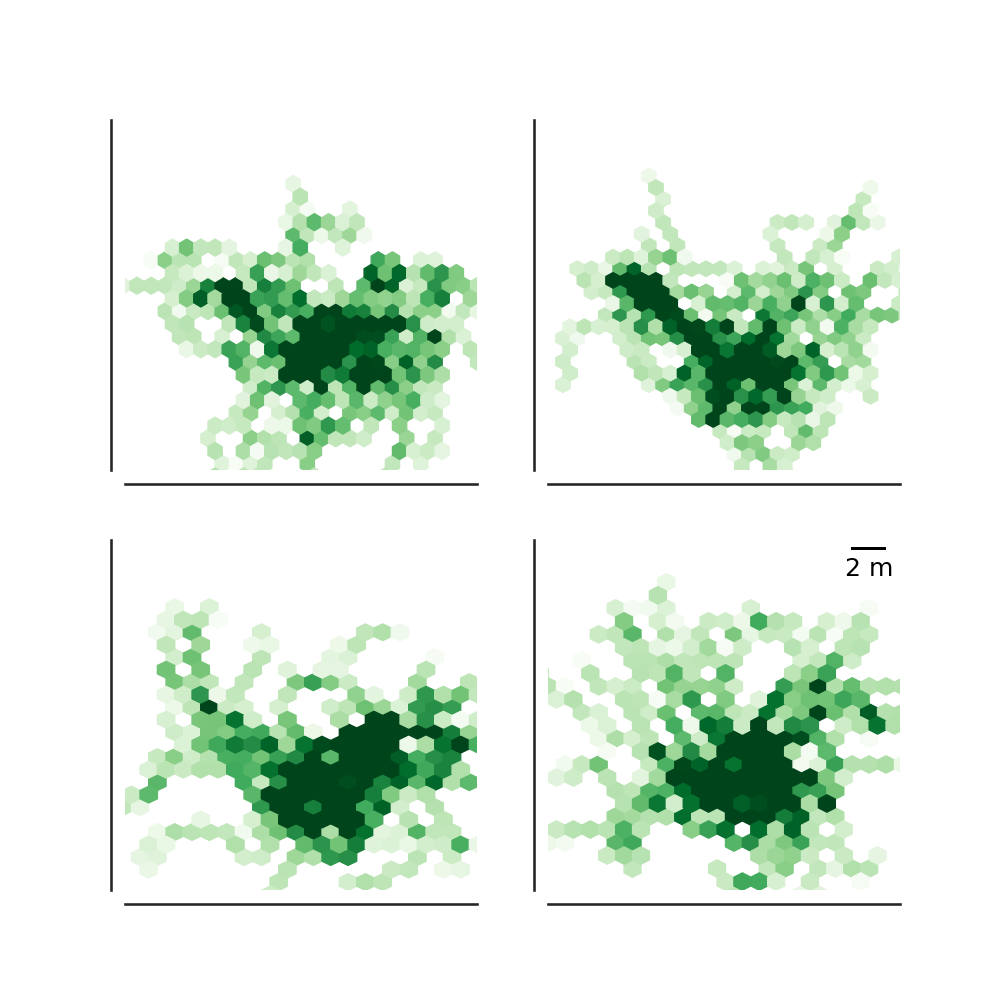

In [184]:
f,ax=plt.subplots(2,2,figsize=(10,10))
ax=ax.reshape(1,4)[0]
w=10
for i in range(4):
    hb=ax[i].hexbin(df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_x.loc[::5], df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_y.loc[::5],vmax=100,gridsize=25 ,cmap='Greens',mincnt=1)
    ax[i].set_aspect('equal','datalim')
    ax[i].set_xlim(513-w,513+w)
    ax[i].set_ylim(518-w,518+w)
    
    ax[i].set_yticks([], minor=False)
    ax[i].set_xticks([], minor=False)
    
from matplotlib_scalebar.scalebar import ScaleBar
scalebar = ScaleBar(1,frameon=False) # 1 pixel = 0.2 meter
plt.gca().add_artist(scalebar)
sns.despine(left=True,bottom=True,trim=True,offset=None)



In [185]:
plt.savefig('ang_plt.png',transparent=True,papertype='A4',frameon=False,dpi=300,)
plt.savefig('ang_plt.svg',transparent=True,papertype='A4',frameon=False,)


In [156]:
sns.despine(left=True,bottom=True,trim=True,offset=None)


In [153]:
sns.despine(left=True,bottom=True,trim=True,offset=None)
ax[0].set_yticks([], minor=False)
ax[0].set_xticks([], minor=False)
from matplotlib_scalebar.scalebar import ScaleBar
scalebar = ScaleBar(1,frameon=False) # 1 pixel = 0.2 meter
plt.gca().add_artist(scalebar)


<IPython.core.display.Javascript object>


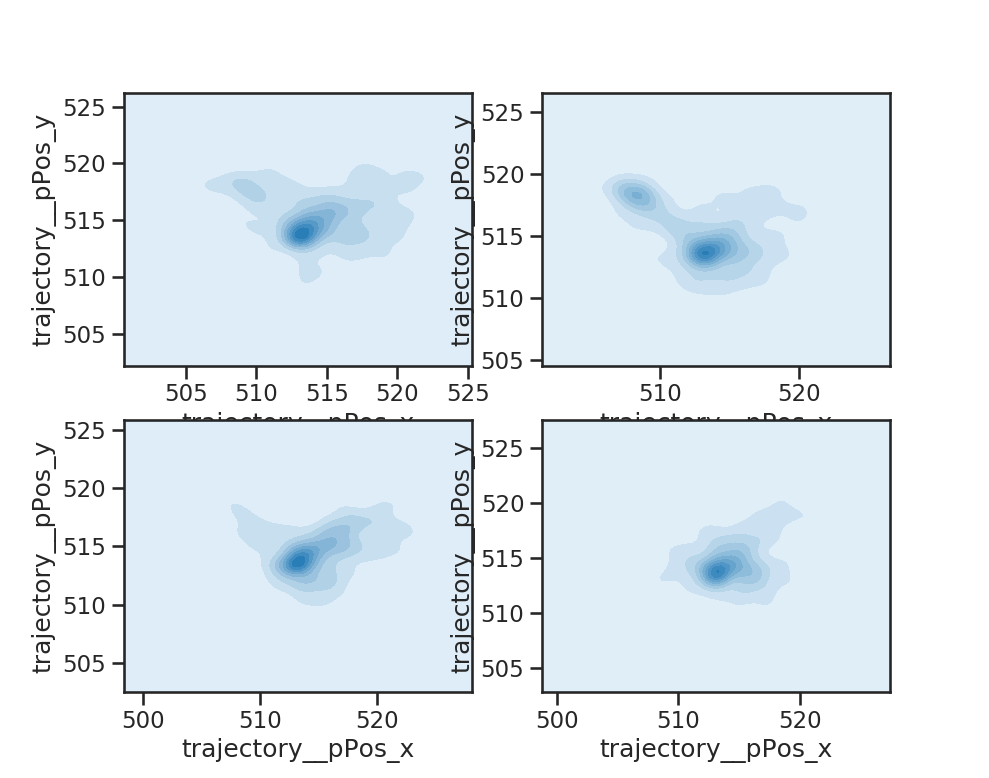

In [120]:
f,ax=plt.subplots(2,2)
ax=ax.reshape(1,4)[0]
# pltQuadTrajPlot(df,ax=ax)
for i in range(4):
    sns.kdeplot(df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_x.loc[::5], df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_y.loc[::5], shade=True,ax=ax[i],)

<IPython.core.display.Javascript object>


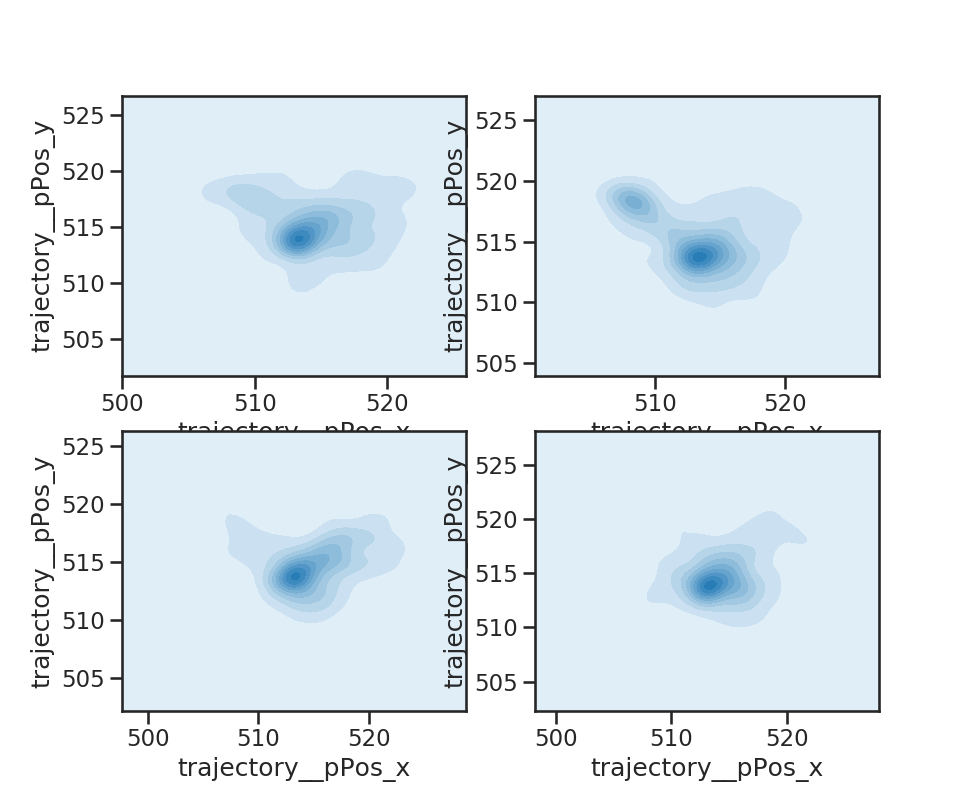

In [116]:
f,ax=plt.subplots(2,2)
ax=ax.reshape(1,4)[0]
# pltQuadTrajPlot(df,ax=ax)
for i in range(4):
    sns.kdeplot(df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_x.loc[::25], df[(df.trajectory__speed>0)&(df.trajectory__case==i)].trajectory__pPos_y.loc[::25], shade=True,ax=ax[i])

<IPython.core.display.Javascript object>


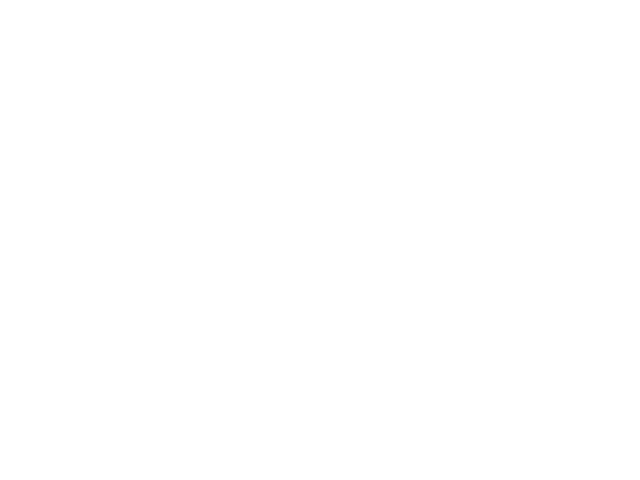

In [97]:
df2=df[df.trajectory__speed>0]
f,ax=plt.subplots(2,2,'all','all')
ax=ax.reshape(4,1)
for i in range(4):
    df3=df2[df2.trajectory__case==i]
#     plt.figure()
    ax[i][0].hexbin(df3.trajectory__pPos_x,df3.trajectory__pPos_y,gridsize=20,cmap='viridis',vmax=850)
    ax[i][0].set_aspect('equal','datalim')
#     plt.hexbin(df3.trajectory__pPos_x,df3.trajectory__pPos_y,gridsize=20,cmap='viridis',vmax=1250)


<IPython.core.display.Javascript object>


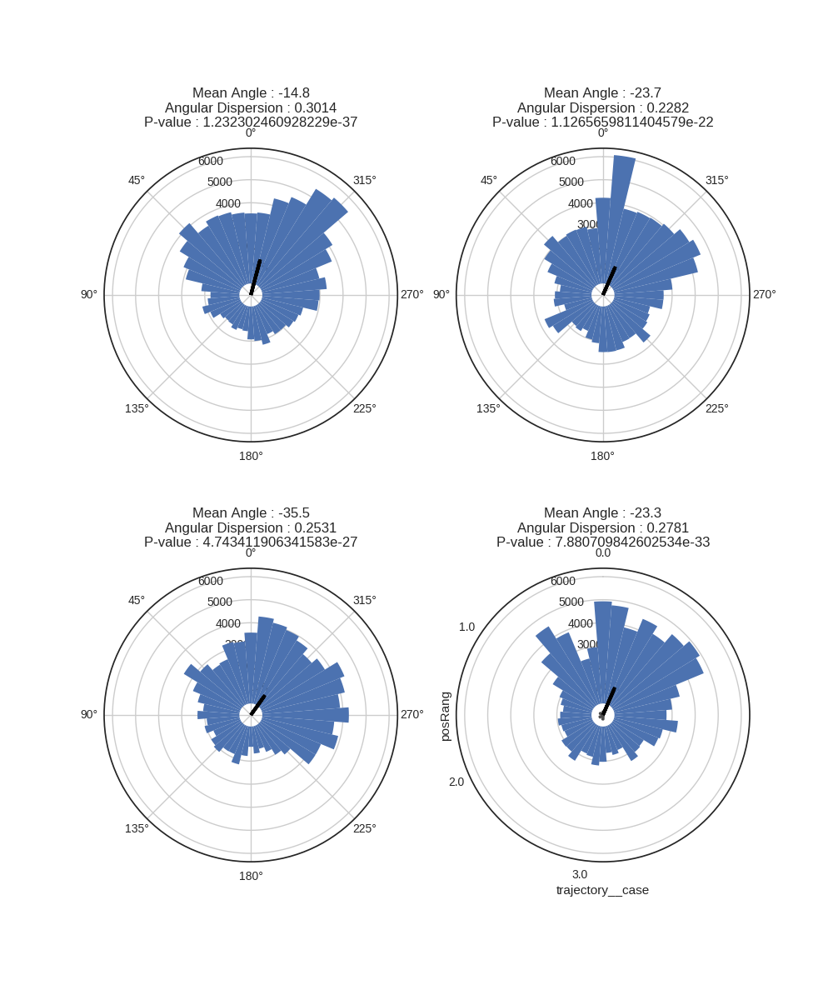

1.1265659811404579e-22
1.232302460928229e-37
4.743411906341583e-27
7.880709842602534e-33


array([[<matplotlib.axes._subplots.PolarAxesSubplot object at 0x7f68b563c6d0>,
      dtype=object)

In [388]:
quadPolarHist(df,bottom=500)

<IPython.core.display.Javascript object>


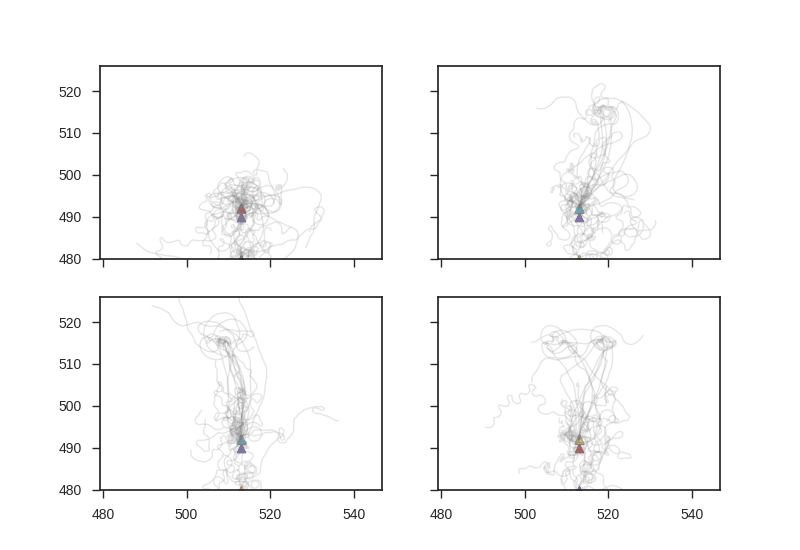


 Doing 480 493
appending file  39 63
appending file  43 63
appending file  47 63
appending file  54 63
appending file  55 63
appending file  59 63


<IPython.core.display.Javascript object>


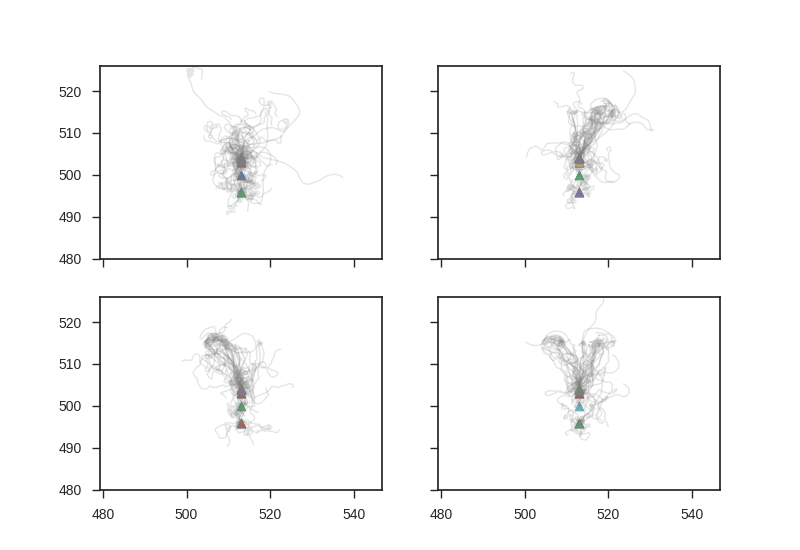


 Doing 496 504
appending file  2 63
appending file  3 63
appending file  34 63
appending file  38 63
appending file  42 63
appending file  46 63
appending file  50 63
appending file  53 63
appending file  58 63


<IPython.core.display.Javascript object>


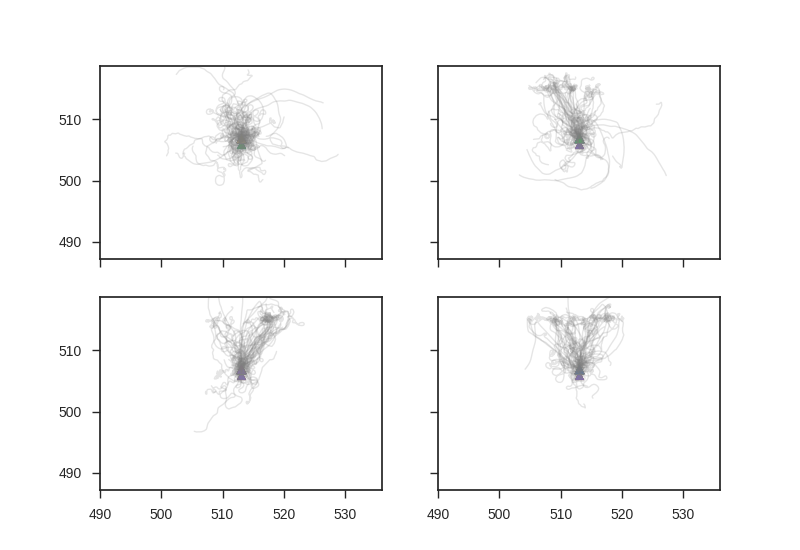


 Doing 506 508
appending file  1 63
appending file  4 63
appending file  22 63
appending file  23 63
appending file  25 63
appending file  27 63
appending file  28 63
appending file  29 63
appending file  32 63
appending file  33 63


<IPython.core.display.Javascript object>


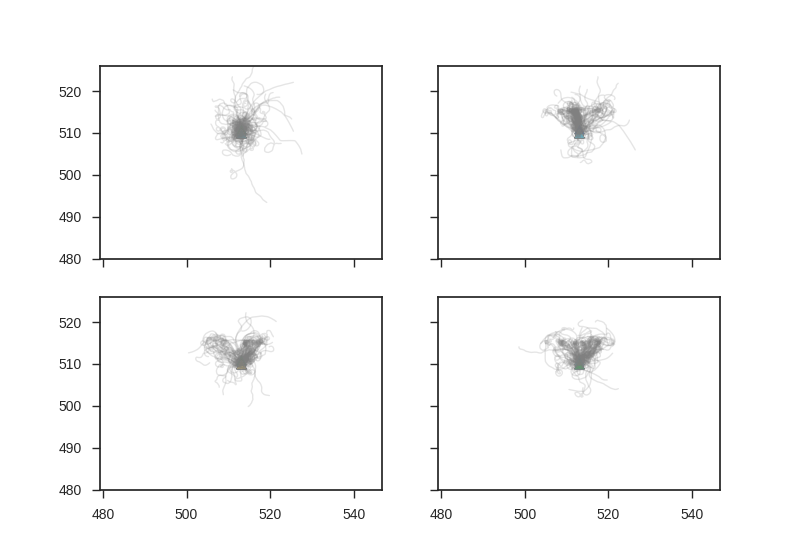


 Doing 510 511
appending file  8 63
appending file  9 63
appending file  10 63
appending file  19 63
appending file  26 63
appending file  30 63
appending file  31 63
appending file  36 63
appending file  37 63
appending file  41 63
appending file  45 63
appending file  49 63
appending file  52 63
appending file  57 63
appending file  60 63
appending file  61 63
appending file  62 63


<IPython.core.display.Javascript object>


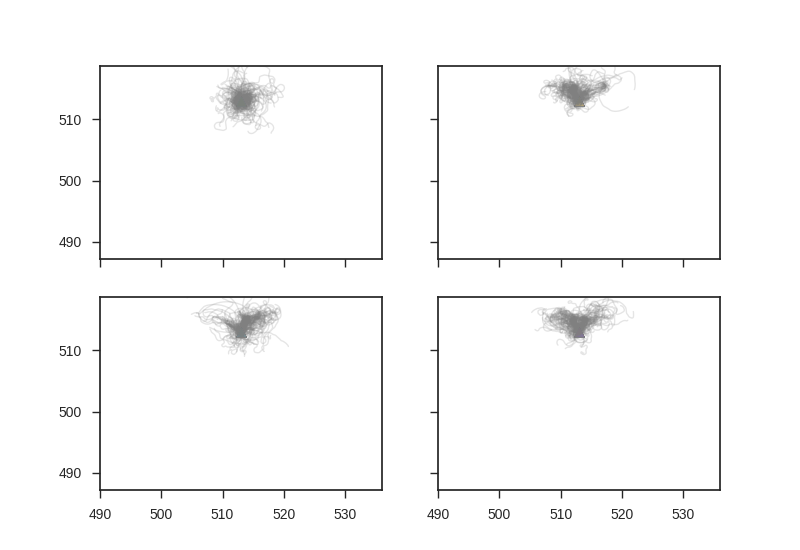


 Doing 513 513
appending file  0 63
appending file  5 63
appending file  6 63
appending file  7 63
appending file  11 63
appending file  12 63
appending file  13 63
appending file  14 63
appending file  15 63
appending file  16 63
appending file  17 63
appending file  18 63
appending file  21 63
appending file  35 63
appending file  40 63
appending file  44 63
appending file  48 63
appending file  51 63
appending file  56 63


In [11]:


boundl=[[480,493],[496,504],[506,508],[510,511],[513,513]]

for j,gtlt in enumerate(boundl):
    gt=gtlt[0]
    lt=gtlt[1]
    fig,ax=plt.subplots(2,2,'all','all',)
    ax=ax.reshape(4)
    print ('\n Doing'),gt,lt
    for i,df in enumerate(dfl):
        parameters=pl[i]
#         df,parameters=h5load(fn)

        try:
            if (parameters['playerInitPos'][0]==513 and parameters['playerInitPos'][1]>=gt and parameters['playerInitPos'][1]<=lt):
                print('appending file '),i,len(dfl)
                pltQuadTrajPlot(df,str(gt)+'_'+str(lt),ax=ax,linewidth=1,alpha=0.2,savePng=False,saveSvg=False,xlim=(490,536),ylim=(480,526))
                

        except Exception as e:
            print( 'error'),e,fn

    plt.savefig(str(gt)+'_'+str(lt)+'_plt.png',transparent=True,papertype='A4',frameon=False,dpi=300)
    plt.savefig(str(gt)+'_'+str(lt)+'_plt.svg',transparent=True,papertype='A4',frameon=False)



 Doing 480 493
appending file  39 63
appending file  43 63
appending file  47 63
appending file  54 63
appending file  55 63
appending file  59 63


<IPython.core.display.Javascript object>


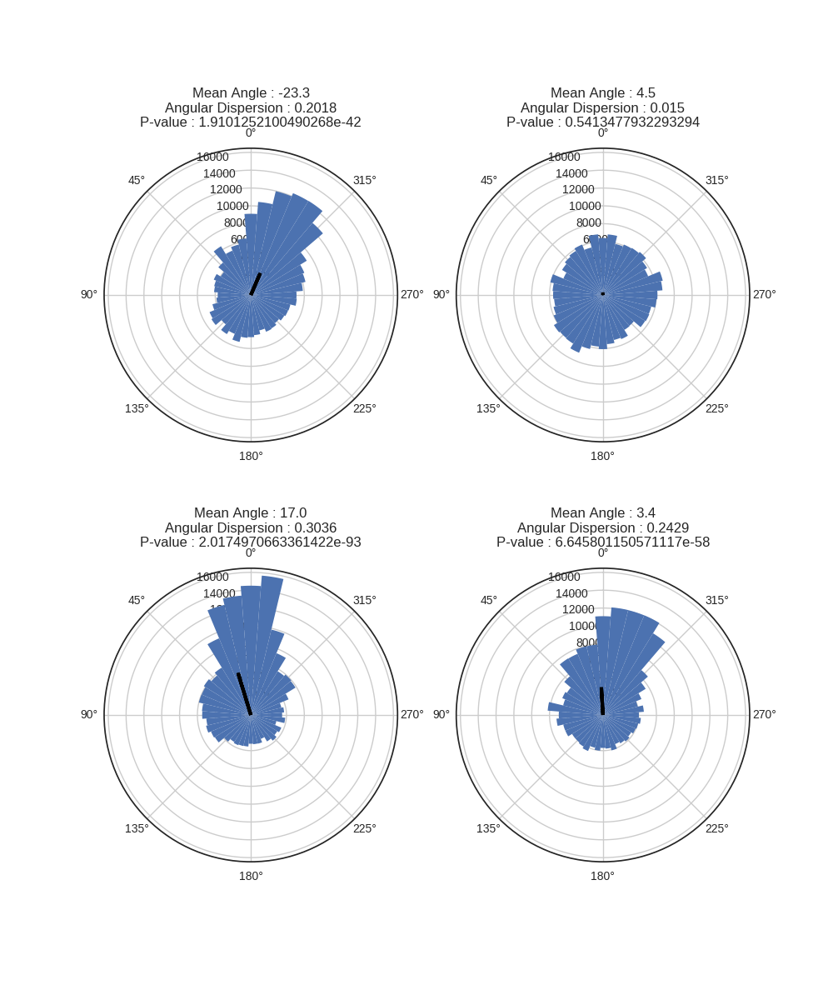

0.5413477932293294
1.9101252100490268e-42
2.0174970663361422e-93
6.645801150571117e-58

 Doing 496 504
appending file  2 63
appending file  3 63
appending file  34 63
appending file  38 63
appending file  42 63
appending file  46 63
appending file  50 63
appending file  53 63
appending file  58 63


<IPython.core.display.Javascript object>


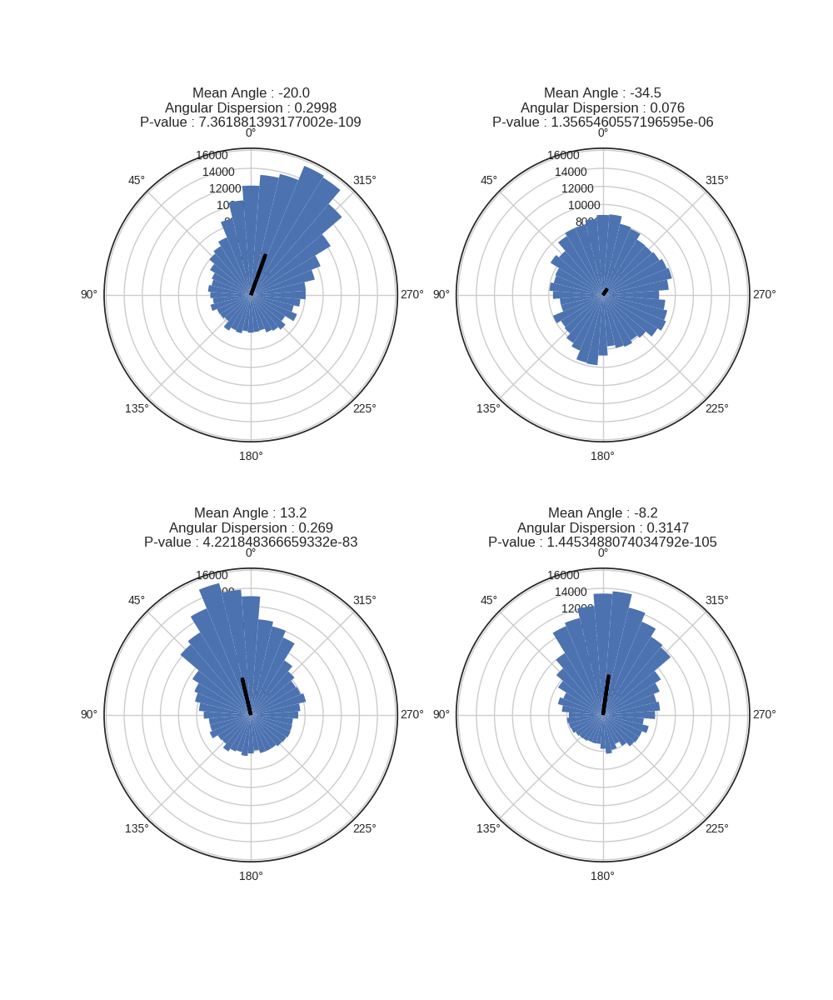

1.3565460557196595e-06
7.361881393177002e-109
4.221848366659332e-83
1.4453488074034792e-105

 Doing 506 508
appending file  1 63
appending file  4 63
appending file  22 63
appending file  23 63
appending file  25 63
appending file  27 63
appending file  28 63
appending file  29 63
appending file  32 63
appending file  33 63


<IPython.core.display.Javascript object>


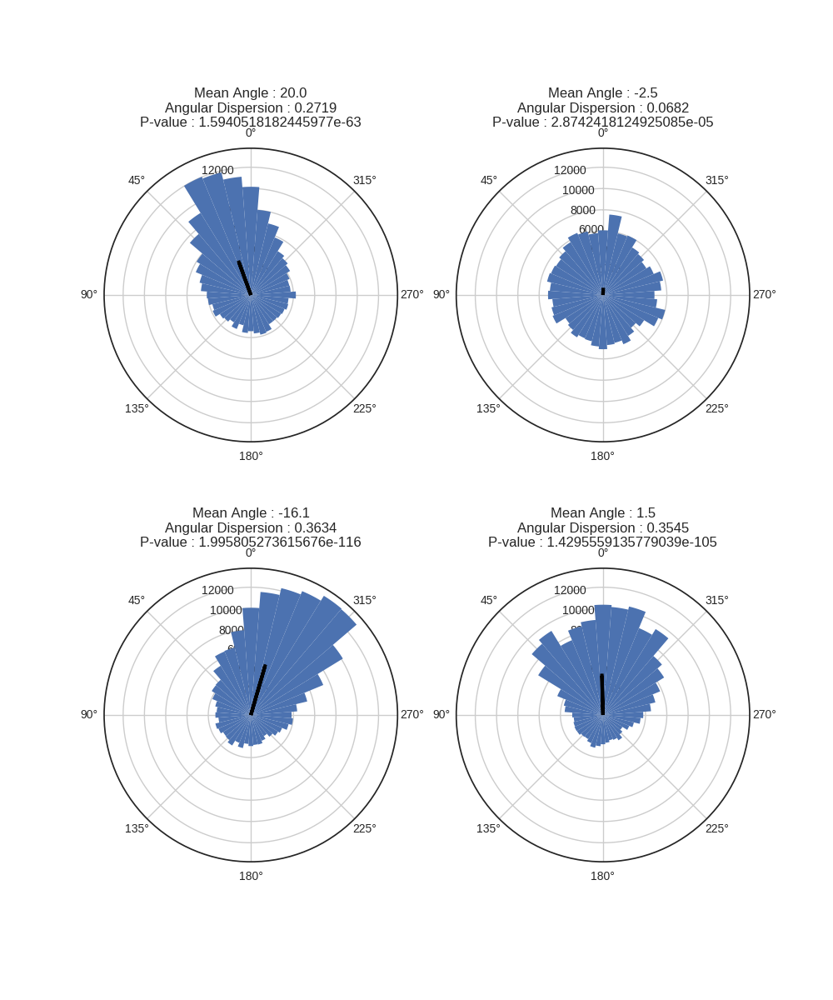

2.8742418124925085e-05
1.5940518182445977e-63
1.995805273615676e-116
1.4295559135779039e-105

 Doing 510 511
appending file  8 63
appending file  9 63
appending file  10 63
appending file  19 63
appending file  26 63
appending file  30 63
appending file  31 63
appending file  36 63
appending file  37 63
appending file  41 63
appending file  45 63
appending file  49 63
appending file  52 63
appending file  57 63
appending file  60 63
appending file  61 63
appending file  62 63


<IPython.core.display.Javascript object>


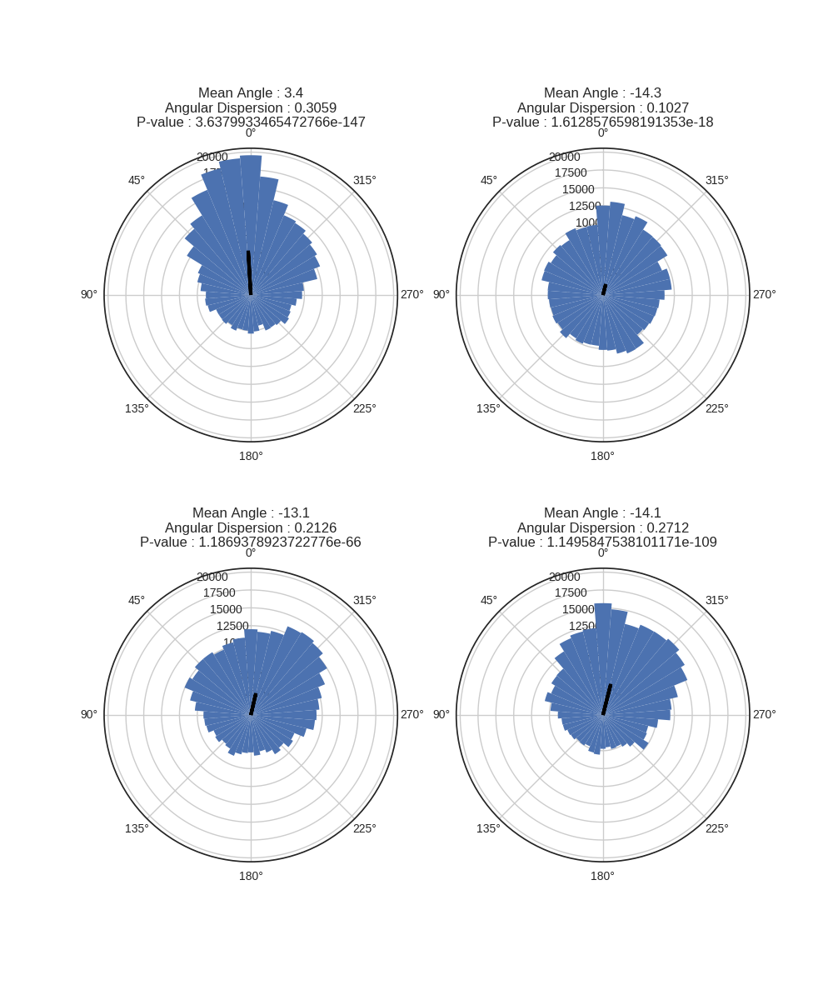

1.6128576598191353e-18
3.6379933465472766e-147
1.1869378923722776e-66
1.1495847538101171e-109

 Doing 513 513
appending file  0 63
appending file  5 63
appending file  6 63
appending file  7 63
appending file  11 63
appending file  12 63
appending file  13 63
appending file  14 63
appending file  15 63
appending file  16 63
appending file  17 63
appending file  18 63
appending file  21 63
appending file  35 63
appending file  40 63
appending file  44 63
appending file  48 63
appending file  51 63
appending file  56 63


<IPython.core.display.Javascript object>


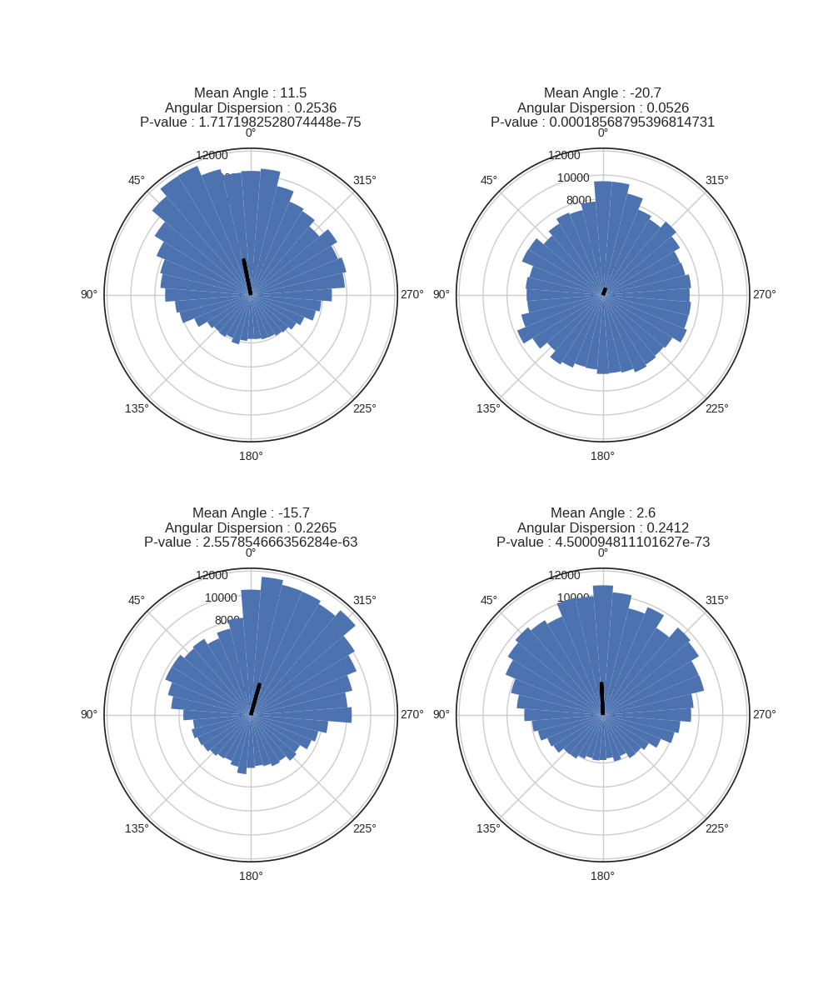

0.00018568795396814731
1.7171982528074448e-75
2.557854666356284e-63
4.500094811101627e-73


In [18]:

boundl=[[480,493],[496,504],[506,508],[510,511],[513,513]]

for j,gtlt in enumerate(boundl):
    gt=gtlt[0]
    lt=gtlt[1]
#     fig,ax=plt.subplots(2,2,'all','all',)
#     ax=ax.reshape(4)
    print ('\n Doing'),gt,lt
    dfl_=[]
    for i,df in enumerate(dfl):
        parameters=pl[i]
#         df,parameters=h5load(fn)

        try:
            if (parameters['playerInitPos'][0]==513 and parameters['playerInitPos'][1]>=gt and parameters['playerInitPos'][1]<=lt):
                print('appending file '),i,len(dfl)
                dfl_.append(df)
                

        except Exception as e:
            print( 'error'),e,fn
    
    quadPolarHist(pd.concat(dfl_),)


    plt.savefig(str(gt)+'_'+str(lt)+'_pol.png',transparent=True,papertype='A4',frameon=False,dpi=300)
    plt.savefig(str(gt)+'_'+str(lt)+'_pol.svg',transparent=True,papertype='A4',frameon=False)


In [374]:
from ipyimports import *


def rayleightest(data, axis=None, weights=None):
    """ Performs the Rayleigh test of uniformity.

    This test is  used to identify a non-uniform distribution, i.e. it is
    designed for detecting an unimodal deviation from uniformity. More
    precisely, it assumes the following hypotheses:
    - H0 (null hypothesis): The population is distributed uniformly around the
    circle.
    - H1 (alternative hypothesis): The population is not distributed uniformly
    around the circle.
    Small p-values suggest to reject the null hypothesis.

    Parameters
    ----------
    data : numpy.ndarray or Quantity
        Array of circular (directional) data, which is assumed to be in
        radians whenever ``data`` is ``numpy.ndarray``.
    axis : int, optional
        Axis along which the Rayleigh test will be performed.
    weights : numpy.ndarray, optional
        In case of grouped data, the i-th element of ``weights`` represents a
        weighting factor for each group such that ``np.sum(weights, axis)``
        equals the number of observations.
        See [1]_, remark 1.4, page 22, for detailed explanation.

    Returns
    -------
    p-value : float or dimensionless Quantity
        p-value.

    Examples
    --------
    >>> import numpy as np
    >>> from astropy.stats import rayleightest
    >>> from astropy import units as u
    >>> data = np.array([130, 90, 0, 145])*u.deg
    >>> rayleightest(data) # doctest: +FLOAT_CMP
    <Quantity 0.2563487733797317>

    References
    ----------
    .. [1] S. R. Jammalamadaka, A. SenGupta. "Topics in Circular Statistics".
       Series on Multivariate Analysis, Vol. 5, 2001.
    .. [2] C. Agostinelli, U. Lund. "Circular Statistics from 'Topics in
       Circular Statistics (2001)'". 2015.
       <https://cran.r-project.org/web/packages/CircStats/CircStats.pdf>
    .. [3] M. Chirstman., C. Miller. "Testing a Sample of Directions for
       Uniformity." Lecture Notes, STA 6934/5805. University of Florida, 2007.
    .. [4] D. Wilkie. "Rayleigh Test for Randomness of Circular Data". Applied
       Statistics. 1983.
       <http://citeseerx.ist.psu.edu/viewdoc/summary?doi=10.1.1.211.4762>
    """
    
    def _length(data, p=1, phi=0.0, axis=None, weights=None):
        # Utility function for computing the generalized sample length
        C, S = _components(data, p, phi, axis, weights)
        return np.hypot(S, C)


    def _components(data, p=1, phi=0.0, axis=None, weights=None):
        # Utility function for computing the generalized rectangular components
        # of the circular data.
        if weights is None:
            weights = np.ones((1,))
        try:
            weights = np.broadcast_to(weights, data.shape)
        except ValueError:
            raise ValueError('Weights and data have inconsistent shape.')

        C = np.sum(weights * np.cos(p * (data - phi)), axis)/np.sum(weights, axis)
        S = np.sum(weights * np.sin(p * (data - phi)), axis)/np.sum(weights, axis)

        return C, S
    n = np.size(data, axis=axis)
    Rbar = _length(data, 1, 0.0, axis, weights)
    z = n*Rbar*Rbar

    # see [3] and [4] for the formulae below
    tmp = 1.0
    if(n < 50):
        tmp = 1.0 + (2.0*z - z*z)/(4.0*n) - (24.0*z - 132.0*z**2.0 +
                                             76.0*z**3.0 - 9.0*z**4.0)/(288.0 *
                                                                        n * n)

    p_value = np.exp(-z)*tmp
    return p_value

def getCircularMean(angles):
    n = len(angles)
    sineMean = np.divide(np.sum(np.sin(np.radians(angles))), n)
    cosineMean = np.divide(np.sum(np.cos(np.radians(angles))), n)
    vectorMean = np.arctan2(sineMean, cosineMean)
    r=np.sqrt(np.square(sineMean)+np.square(cosineMean))
    return np.degrees(vectorMean),r

def polarHist(df,ax=None,bins=40,bottom = 0,kind='bar',fname='',start=100,stepSize=40,alpha=0.6,s=50,toShow=True):
       
        
    r,t=np.histogram((df.trajectory__pOri_x%360),bins=bins,density=False)
#     r=r/float(max(r))
    width =(2*np.pi) / len(r)
    
    t=np.deg2rad(t[:-1])

    if ax is None:
        ax = plt.subplot(111, polar=True)
        
    if kind=='outline':
        bars = ax.plot(t, r)
    elif kind=='scatterStack':
        #initialize empty arrays
        i=0
        tl=np.array([])
        rl=np.array([])

        for the in t:
            currRl=range(start,r[i]+start,stepSize)
            currTl=np.repeat(the,len(currRl))
            rl=np.append(rl,currRl)
            tl=np.append(tl,currTl)
            i+=1
       
        ax.scatter((tl), rl,alpha=alpha,s=s)
#         ax.set_theta_zero_location("N")
        ax.set_theta_offset(np.pi/2)
        
    else:# 'mostly standard bar'
        bars = ax.bar(t, r, width=width, bottom=bottom)
        ax.set_theta_offset(np.pi/2)

        
        
    tor=df.trajectory__wbad.abs().mean()
    pval=rayleightest(np.deg2rad(df.trajectory__pOri_x[::100]))
    meanAng, angDisp=getCircularMean(df.trajectory__pOri_x)
    
    ax.arrow(0,0,np.deg2rad(meanAng%360),angDisp*max(r),lw=3,)# shape='full',
             #length_includes_head=True, head_width=100)

    
    tit='Mean Angle : '+str(round(meanAng,1))+ '\nAngular Dispersion : '+\
        str(round(angDisp,4))+'\nP-value : '+str(pval)
    ax.set_title(tit)
    print pval
#     ax.set_title('tortuosity is'+str(round(tor,3)))

#     ax.autoscale()
#     figFname=fname.split('pickle')[0]+'polarHist.png'
#     plt.savefig(figFname,transparency=True)
    
    if toShow:
        plt.show()    
    else:
        plt.close()


    return r,t,ax







def polarPitoo(df,kmaxAngle=15,initRadius=0,radIncrement=1./165, c='r', s=10, alpha=0.05,):
    initH=df.trajectory__pOri_x[0]
    r=initRadius
    radius=[]
    theta=[]

    for i in range(len(df)):
        currH=df.trajectory__pOri_x[i]
        
        if abs(currH-initH)>maxAngle:
            initH=df.trajectory__pOri_x[i]
            r=initRadius
        else:
            r+=radIncrement

        t=np.deg2rad(currH)
        radius.append(r)
        theta.append(t)

    
    if ax is None:
        ax = plt.subplot(111, projection='polar')
        
    # c = ax.scatter(theta, r, c='r', s=10, cmap='hsv', alpha=0.75)
    c = ax.scatter(theta, radius, c=c, s=s, alpha=alpha)


    plt.show()
    
    return radius,theta, c


def quadPolarHist(df=None,bins=40,bottom = 0,kind='bar',fname='',
                  toShow=True,start=100,stepSize=40,alpha=0.6,s=50):
    
    if df is None:
        dfDump=pickle2df()
        df=dfDump[0]
        fname=dfDump[-1]
        
    #make a empty polar fig
    f, axarr = plt.subplots(2, 2, subplot_kw=dict(projection='polar'),figsize=(10,12))
    
    #polar plots as quad
    d=polarHist(df[(df.trajectory__case==0) & (df.trajectory__headingControl)],
              ax=axarr[0,1],bins=bins,bottom = bottom,kind=kind,start=start,
              stepSize=stepSize,alpha=alpha,s=s,toShow=toShow)
    d=polarHist(df[(df.trajectory__case==1) & (df.trajectory__headingControl)],
              ax=axarr[0,0],bins=bins,bottom = bottom,kind=kind,start=start,
              stepSize=stepSize,alpha=alpha,s=s,toShow=toShow)
    d=polarHist(df[(df.trajectory__case==2) & (df.trajectory__headingControl)],
              ax=axarr[1,0],bins=bins,bottom = bottom,kind=kind,start=start,
              stepSize=stepSize,alpha=alpha,s=s,toShow=toShow)
    d=polarHist(df[(df.trajectory__case==3) & (df.trajectory__headingControl)],
              ax=axarr[1,1],bins=bins,bottom = bottom,kind=kind,start=start,
              stepSize=stepSize,alpha=alpha,s=s,toShow=toShow)
    
    #set lims on min/max
    ylims=[]
    for row,col in axarr:
        ylims.append(row.get_ylim()[1])
        ylims.append(col.get_ylim()[1])
    yMax=max(ylims)
    yMin=0
    for row,col in axarr:
        row.set_ylim(yMin,yMax)
        col.set_ylim(yMin,yMax)

    figFname=fname.split('pickle')[0]+kind+'polarHist.png'
    f.suptitle(fname.split('/')[-1], fontsize=12)
    plt.savefig(figFname,transparency=True,dpi=300)
    if toShow:
        plt.show()
    else:
        plt.close()
    
    return axarr
    
def pickleDir2Polar(foldPath=None,bins=40,bottom = 0,kind='bar',toShow=True,
                    start=100,stepSize=40,alpha=0.6,s=50):
    
    filenames=fileList(foldPath=foldPath)
    
    for filename in filenames:
        dfDump=pickle2df(path=filename)
        df=dfDump[0]
        fname=dfDump[-1]
        
        a=quadPolarHist(df,bins,bottom,kind,fname,toShow)
        plt.close()


In [6]:
df=dfl[0]

In [7]:
o1=(df.trajectory__o1Pos_x,df.trajectory__o1Pos_y)
o2=(df.trajectory__o2Pos_x,df.trajectory__o2Pos_y)

In [26]:
def opos(d):
    if d == 0 :
        return (513,513)
    if d==1:
        return (510,510)

In [28]:
def angleWrt(d,heading,pos=(513,513)):
    return d-heading+pos[0]
    

In [81]:
%matplotlib notebook


In [31]:
from PIL import Image

In [75]:
def image2Arr(path=None):
    if path is None:
        path=easygui.fileopenbox(filetypes=['*.png'])
        
    #load image
    from PIL import Image
    im=np.array(Image.open(path))
    
    #find peak values
    im=im[:,:,0].argmin(axis=0)*(-1)
    
    def norm(a):
        return 1.*(a-a.min())/(a.max()-a.min())
    
    return norm(im)

In [109]:
wba=df.trajectory__wbad.reset_index(drop=True).ix[:10000].rolling(5).mean()

In [101]:
# df.trajectory__wbad.reset_index(drop=True).ix[:1000].plot()
lturn=df.trajectory__wbad.reset_index(drop=True).ix[:1000].rolling(5).mean().ix[143:180]

<IPython.core.display.Javascript object>


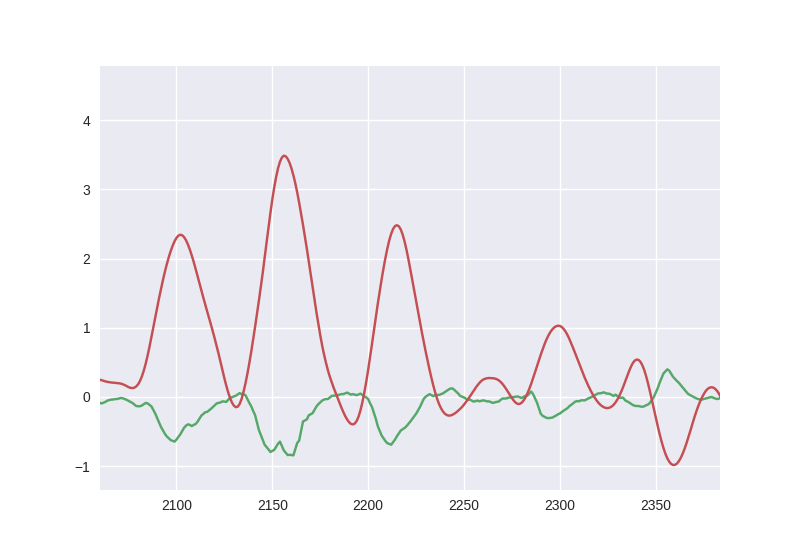

In [114]:
(lturn+2).plot()
wba.plot()
plt.plot(np.convolve(wba,lturn)[len(lturn)/2:])

In [32]:

ifn=easygui.fileopenbox(filetypes=['*.png'])

In [70]:
im=np.array(Image.open(ifn))
im=im[:,:,0].argmin(axis=0)*(-1)

In [73]:
def norm(a):
    return 1.*(a-a.min())/(a.max()-a.min())

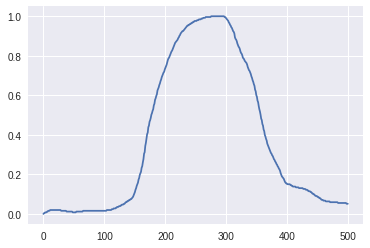

In [74]:
plt.plot(norm(im))

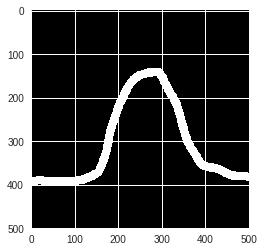

In [62]:
plt.imshow(im[:,:,0])

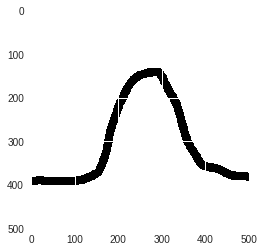

In [58]:
plt.imshow(im)

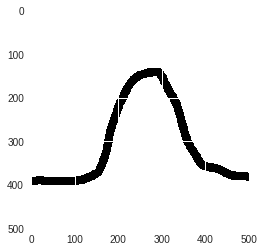

In [42]:
plt.imshow(np.array(im))

In [41]:
%matplotlib inline

In [30]:
df.trajectory__pPos_x.apply(angleWrt,args=(df.trajectory__pOri_x))

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

In [27]:
df.trajectory__case.apply(opos).unique()

array([(513, 513), (510, 510), None], dtype=object)

In [7]:
foldPath=easygui.diropenbox(default='/media/rhagoletis/')

In [ ]:

def plotAggreg(foldPath=None,
               defaultPath='/media/rhagoletis/6db8b2b2-ebe2-4555-9b79-93b10ef9dec3/agg/odour+wind/all',
              x_range=(493,533), y_range=(485,525),):
    if foldPath is None:
        foldPath=easygui.diropenbox(default=defaultPath)
    files=fileList(foldPath,included=['*.bag_df.pickle'])
    tr=None
    tl=None
    bl=None
    br=None
    iTot=len(files)
    i=1
    for item in files:
        plot,df,parameters,path,tr,tl,bl,br=pickle2bokeh(item,exposeReturn=True,tr=tr,tl=tl,bl=bl,br=br,
                     addBigTit=False,addSmallTit=False,addArrow=False,addStart=False,
                        x_range=x_range, y_range=y_range,decimate=10)
        print ("currently analysing {}, {}/{} files ").format(item.strip('/')[-1],i,iTot)
        i+=1
    show(plot)
    return plot

In [ ]:
h5store('tes.h5',df)

In [ ]:
pd.read_hdf('tes.h5')

In [ ]:
h5load('tes.h5')

In [ ]:
# a = pd.DataFrame(
#     data=pd.np.random.randint(0, 100, (10, 5)), columns=list('ABCED'))

# filename = '/tmp/data.h5'
# metadata = dict(local_tz='US/Eastern')
# h5store(filename, a, **metadata)
# with pd.HDFStore(filename) as store:
#     data, metadata = h5load(store)

# print(data)

metadata = dict(local_tz='US/Eastern')
h5store(filename, a, **metadata)
with pd.HDFStore(filename) as store:
    data, metadata = h5load(store)

print(data)

In [ ]:
print metadata

In [ ]:
from joblib import Parallel, delayed
import multiprocessing
num_cores = multiprocessing.cpu_count()


In [ ]:
num_cores

In [ ]:
fl=fileList(included=['*.h5'])

In [ ]:
len(fl)

In [84]:
df=pd.read_hdf(fl[0])


In [ ]:
%matplotlib notebook

In [ ]:
ax[0].scatter(513,513,marker='^',s=40)

In [ ]:
def readNplt(fn):
    try:
        df=pd.read_hdf(str(fn))
        pltQuadTrajPlot(df,fn)
        plt.close()
        print('hello')

    except Exception as e:
        print ('error in file '),e,fn
        plt.close()


In [ ]:
tic()
for i, fn in enumerate( fl):
    try:
        df=pd.read_hdf(fn)
        pltQuadTrajPlot(df,fn)
        plt.close()
        print ("finished %i of %i")%(i,len(fl))

    except Exception as e:
        print ('error in file '),e,fn
toc()    

In [ ]:
tic()
results = Parallel(n_jobs=num_cores)(delayed(readNplt)(fn) for fn in fl)
toc()

In [ ]:
len(tx)